In [17]:
import numpy as np
import matplotlib.pyplot as plt
# import cebra_datahelpers
import PCA_preprocessing
from scipy.ndimage import gaussian_filter1d
from scipy.stats import sem
import cv2
import pickle
import PCA_statstests
import sys
sys.path.append('pyvenn/')
import venn
import random
from scipy.spatial.distance import mahalanobis
import pandas as pd
import seaborn as sns

##### Data Extraction


In [18]:
partname = "snout"
l_mouse_name = ["F2491","F2492","F2493", "F2494", "F2495","F2496", "M2497","M2498","M2499", "M2500", "M2502"]#, "M3303", "F3309"
l_date =["20230414","20230414","20230414","20230414","20230414","20230414","20230414","20230414","20230414","20230414","20230414"]#,"20240623","20240623"
l_rotation = [0,0,0,0,0,0,0,0,0,0,0,1,1]

# l_path_cdata = ["Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\F2491\\20230414\\F2491_2023-04-14_12-27-12_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat", "Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\F2492\\20230414\\F2492_2023-04-14_11-19-18_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\F2493\\20230414\\F2493_2023-04-14_10-36-02_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\F2494\\20230414\\F2494_2023-04-14_12-06-58_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\F2495\\20230414\\F2495_2023-04-14_11-40-46_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\F2496\\20230414\\F2496_2023-04-14_10-58-09_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\M2497\\20230414\\M2497_2023-04-14_12-48-14_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\M2498\\20230414\\M2498_2023-04-14_14-39-31_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\M2499\\20230414\\M2499_2023-04-14_13-53-50_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat", "Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\M2500\\20230414\\M2500_2023-04-14_14-15-04_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\M2501\\20230414\\M2501_2023-04-14_13-33-12_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat","Y:\\Ephys_in_vivo\\01_RAW_DATA\\2_In_Nphy\\M2502\\20230414\\M2502_2023-04-14_13-10-34_EPM\\Record Node 101\\experiment1\\recording1\\continuous\\Rhythm_FPGA-100.0\\continuous.dat"]
# l_data,l_data_25, l_data_shuffled,_, l_beh_lowdim, l_beh_shuffled, l_beh,l_beh_lowdim_cont,l_beh_shuffled_cont = cebra_datahelpers.load_datavariables(l_mouse_name, l_date, datatype=1, sorter="kilo", l_data_25_bool = True)

In [ ]:
# don't use l_data_shuffled, l_beh_lowdim
# use l_beh_lowdim_cont
# change name of files before making changes!!!
# with open('RESULTS/NOT-INJECTED/data_forPCA_kilo_25ms_modified_20240707.pkl', 'wb') as f: #'mouseDataNew/data_forPCA_kilo_25ms_modified_20240707.pkl'
#     pickle.dump([l_data,l_data_25, l_data_shuffled, l_beh_lowdim, l_beh_shuffled, l_beh,l_beh_lowdim_cont,l_beh_shuffled_cont],f)

In [394]:
#
# with open('mouseDataNew/data_forPCA_kilo_25ms_modified.pkl', 'rb') as f:
#     l_data,l_data_25, l_data_shuffled, l_beh_lowdim, l_beh_shuffled, l_beh,l_beh_lowdim_cont,l_beh_shuffled_cont = pickle.load(f)

In [ ]:
# change name of files before making changes!!!
#'mouseDataNew/data_forPCA_kilo_25ms_modified_20240707.pkl', keep in mind which unit you are using!
#this one gives the correct units that were 605
with open('RESULTS/NOT-INJECTED/data_forPCA_kilo_25ms_modified_20240707.pkl', 'rb') as f:
    l_data,l_data_25, l_data_shuffled, l_beh_lowdim, l_beh_shuffled, l_beh,l_beh_lowdim_cont,l_beh_shuffled_cont = pickle.load(f)

In [5]:
l_data[0].shape

torch.Size([18422, 71])

In [6]:
l_beh_lowdim_cont[0].shape

torch.Size([18422, 2])

##### Firing rate stats 

In [8]:
# Example - Understanding variables involved 
data_bin = np.array(l_data[1]) # l_data - 50 ms binned data
window = 20  # 20 bins of 50 ms to create 1000 ms bins
# Calculate the number of complete 1000 ms bins that can fit in the data
num_complete_bins = data_bin.shape[0] // window
# Create an empty array with the correct number of rows for 1000 ms bins
thou_ms_binned_data = np.zeros((num_complete_bins, data_bin.shape[1]))
# Initialize binned index
binned_index = 0
# Loop over the original data in chunks of the window size (20 rows per 1000 ms bin)
for i in range(0, num_complete_bins * window, window):
    # Sum every 20 consecutive rows to form a 1000 ms bin
    thou_ms_binned_data[binned_index, :] = np.sum(data_bin[i:i + window, :], axis=0)
    # Incement the binned index
    binned_index += 1
print(thou_ms_binned_data.shape) # gives spiking per second 
#firing rates num 
unique_values, counts = np.unique(thou_ms_binned_data, return_counts=True)
for i in range(len(unique_values)):
    print(unique_values[i] , ':',counts[i])

(908, 46)
0.0 : 5065
1.0 : 2366
2.0 : 2914
3.0 : 3213
4.0 : 3296
5.0 : 3248
6.0 : 3028
7.0 : 2741
8.0 : 2432
9.0 : 2101
10.0 : 1760
11.0 : 1543
12.0 : 1272
13.0 : 1110
14.0 : 886
15.0 : 725
16.0 : 564
17.0 : 474
18.0 : 389
19.0 : 288
20.0 : 249
21.0 : 202
22.0 : 162
23.0 : 151
24.0 : 132
25.0 : 83
26.0 : 94
27.0 : 84
28.0 : 95
29.0 : 83
30.0 : 65
31.0 : 64
32.0 : 69
33.0 : 68
34.0 : 87
35.0 : 51
36.0 : 55
37.0 : 45
38.0 : 43
39.0 : 40
40.0 : 34
41.0 : 32
42.0 : 35
43.0 : 30
44.0 : 29
45.0 : 16
46.0 : 19
47.0 : 18
48.0 : 11
49.0 : 21
50.0 : 10
51.0 : 9
52.0 : 13
53.0 : 11
54.0 : 11
55.0 : 15
56.0 : 5
57.0 : 8
58.0 : 6
59.0 : 5
60.0 : 6
61.0 : 6
62.0 : 9
63.0 : 12
64.0 : 3
65.0 : 5
66.0 : 4
67.0 : 6
68.0 : 2
69.0 : 3
70.0 : 1
71.0 : 2
72.0 : 3
74.0 : 2
75.0 : 2
76.0 : 3
77.0 : 4
78.0 : 1
80.0 : 4
81.0 : 3
82.0 : 1
83.0 : 1
84.0 : 1
90.0 : 1
91.0 : 2
93.0 : 1
94.0 : 1
95.0 : 1
100.0 : 1
103.0 : 1
117.0 : 1


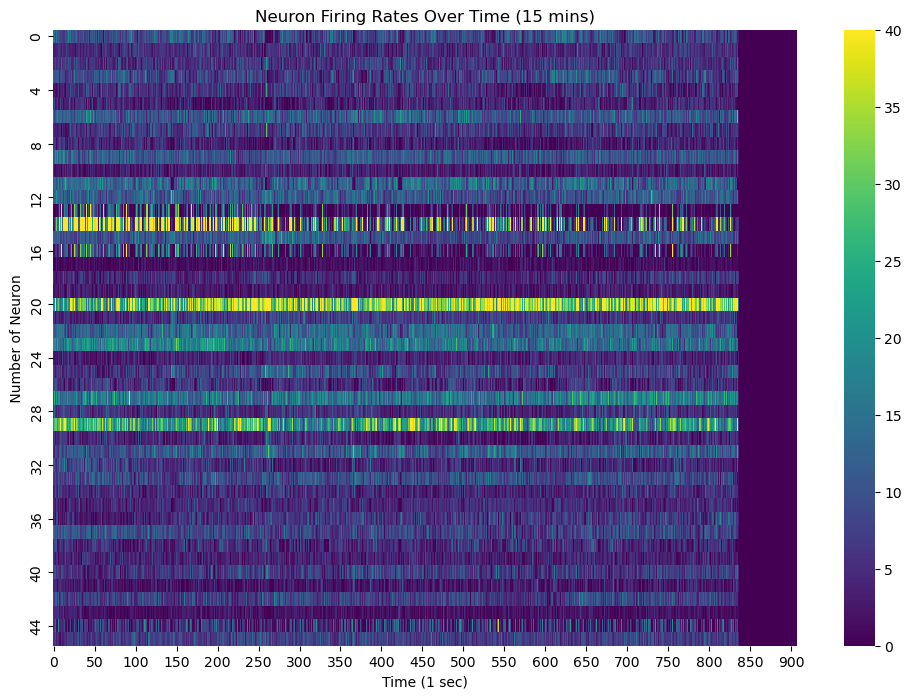

In [10]:
# Set up the figure and axis
plt.figure(figsize=(12, 8))  # Adjust the size for better readability

# Create a heatmap using seaborn
sns.heatmap(thou_ms_binned_data.T, cmap='viridis', cbar=True, vmin= 0, vmax=40,
            xticklabels=50, yticklabels=4)  # Change x/y ticks as needed

# Add labels and a title
plt.xlabel('Time (1 sec)')
plt.ylabel(' Number of Neuron ')
plt.title('Neuron Firing Rates Over Time (15 mins)')

# Display the plot

plt.savefig('RESULTS/NOT-INJECTED/firing_rate_per_mouse_EPM_NOTINJECTED.svg')
plt.show()

In [20]:
#zscore values of each neurons 
baseline = np.mean(thou_ms_binned_data, axis=0)
print(baseline.shape)
std = np.std(thou_ms_binned_data, axis =0 )
print(std.shape)
diff = thou_ms_binned_data - baseline 
print(diff.shape)
zscore = diff/std
print(zscore.shape)
zscore_15mins = np.mean(zscore, axis = 0)
print(zscore_15mins.shape)

(46,)
(46,)
(908, 46)
(908, 46)
(46,)


In [21]:
#z score values count 
unique_values, counts = np.unique(zscore, return_counts=True)
# Initialize an empty dictionary to store counts for each range
range_counts = {}
# Loop over the range -2 to 9 with step size 1
for i in range(-3, 9):
    # Get the sum of counts for the current range (i to i+1)
    count_in_range = np.sum(counts[(unique_values >= i) & (unique_values < i + 1)])
    
    # Store the count in the dictionary
    range_counts[f"{i} to {i+1}"] = count_in_range
# Print the counts for each range
for key, value in range_counts.items():
    print(f"Count for range {key}: {value}")

Count for range -3 to -2: 1006
Count for range -2 to -1: 4968
Count for range -1 to 0: 15618
Count for range 0 to 1: 13752
Count for range 1 to 2: 5244
Count for range 2 to 3: 939
Count for range 3 to 4: 184
Count for range 4 to 5: 45
Count for range 5 to 6: 10
Count for range 6 to 7: 2
Count for range 7 to 8: 0
Count for range 8 to 9: 0


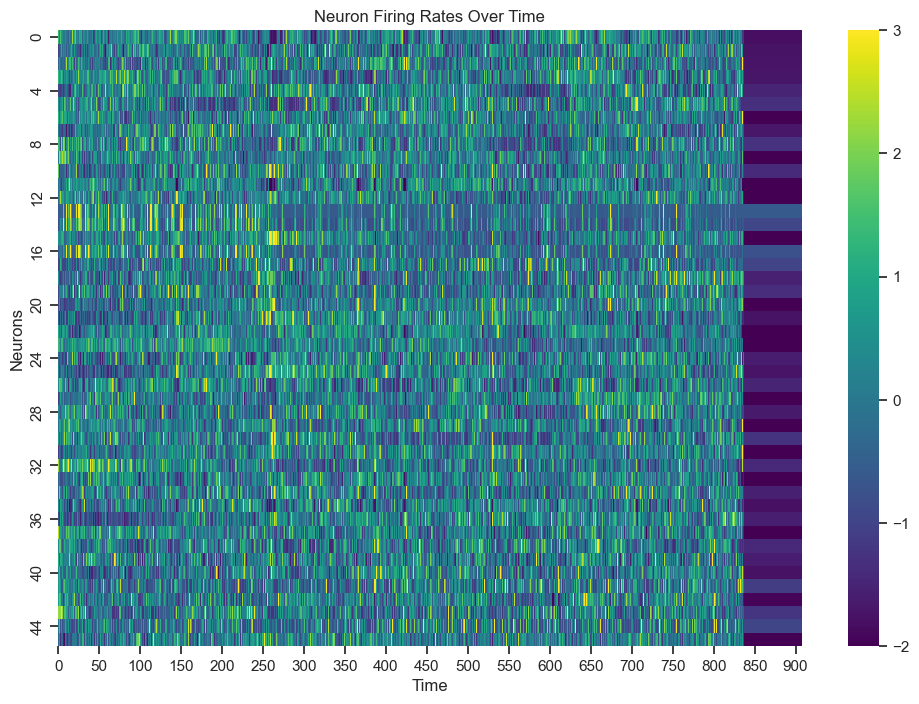

In [22]:
# Set up the figure and axis
plt.figure(figsize=(12, 8))  # Adjust the size for better readability

# Create a heatmap using seaborn
sns.heatmap(zscore .T, cmap='viridis', cbar=True, vmin = -2, vmax = 3,
            xticklabels=50, yticklabels=4)  # Change x/y ticks as needed
# Add labels and a title
plt.xlabel('Time')
plt.ylabel('Neurons')
plt.title('Neuron Firing Rates Over Time')

# Display the plot
plt.show()

In [11]:
#to check the number of units 
units= []
sum = 0
for i in range(len(l_data_25)):
    units.append(l_data_25[i].shape[-1])
    print(l_data[i].shape)
    x = l_data[i].shape[-1]
    sum += x

print(sum)

torch.Size([18422, 71])
torch.Size([18169, 46])
torch.Size([17983, 68])
torch.Size([17838, 76])
torch.Size([24285, 67])
torch.Size([18750, 34])
torch.Size([19378, 55])
torch.Size([18227, 39])
torch.Size([18179, 37])
torch.Size([18112, 69])
torch.Size([20332, 43])
605


In [14]:
#units number each mouse 

unitss = pd.DataFrame({"unitsd1":units, "mousename":l_mouse_name})
unitss.to_excel("RESULTS/NOT-INJECTED/EPM_original_unitsdata.xlsx")

In [24]:
#extract neural within arm data 

def divide_behavior(neural, behavior):
    idx_prev = 0
    idx = 0
  
    beh_timepoints=[None]*3
    thr = int(3/0.05)+5
 
    behaviour_withinarm = [None]*2
    neural_withinarm= [None]*2
    
    # now for the trials within arm
    start_t = 0 
    end_t = 0
    count = 0
    thr = int(2/0.05)

    for i in range(2):
        behaviour_withinarm[i] = []
        neural_withinarm[i] = []
        beh_timepoints[i] = []
    beh_timepoints[-1] = []
    for i in range(neural.shape[0]-1):

        idx_prev = behavior[i,0]
        
        idx = behavior[i+1,0]
        
        if (idx_prev == -1 and (idx == 0 or idx == 1)):
            idx_prev = idx
        if (idx == -1 and (idx_prev == 1 or idx_prev == 0)):
            idx = idx_prev
            
        if idx_prev == idx and idx != 4 and idx != 5 and idx != -1:
            #print(idx)
            if count == 0:
                #print(idx_prev)
                start_t = i
            count +=1
        
        elif idx_prev != idx and count>=thr and idx == 4:
            end_t = i
            # print("points where mouse was",idx_prev)
            # print("point where mouse is ",idx)
            snippet = behavior[start_t:end_t,:]
            snippetneur = neural[start_t:end_t,:]
      

            if idx_prev == 2 or idx_prev == 3: # closed arm extaction 
                behaviour_withinarm[1].append(snippet)
                neural_withinarm[1].append(snippetneur)
                beh_timepoints[2].append(i)
                # print("neural shape of close arm",snippetneur.shape )
            else:
                behaviour_withinarm[0].append(snippet) # open arm = 0 
                neural_withinarm[0].append(snippetneur)
                beh_timepoints[1].append(i)
                print("neural shape of open arm",snippetneur.shape )
               
            start_t = 0
            end_t = 0
            count = 0
        else: 
            start_t = 0
            end_t = 0
            count = 0
        
    return behaviour_withinarm, neural_withinarm, beh_timepoints
        

In [33]:
l_beh_lowdim_cont[0].shape

torch.Size([18422, 2])

In [25]:
#try
behaviour_withinarm = [None]*len(l_data)
neural_withinarm = [None]*len(l_data)
beh_timepoints = [None]*len(l_data)
for i in range(len(l_data)):
    behaviour_withinarm[i], neural_withinarm[i], behaviour_withinarm[i] = divide_behavior(l_data[i], l_beh_lowdim_cont[i])
    break

neural shape of open arm torch.Size([44, 71])
neural shape of open arm torch.Size([60, 71])
neural shape of open arm torch.Size([64, 71])
neural shape of open arm torch.Size([58, 71])
neural shape of open arm torch.Size([59, 71])


In [20]:
#these are the number of spikes(not fr)
behaviour_trials,neural_trials,neural_trials_25,beh_withinarm, neural_within_arm, beh_timepoints  = PCA_preprocessing.get_raw_beh(l_data=l_data, l_data_25=l_data_25, l_beh_lowdim_cont=l_beh_lowdim_cont)

In [36]:
open_arm_withinarm = None  
for j in range(len(neural_within_arm[0][0])):
    print(neural_within_arm[0][0][j].shape)

    if open_arm_withinarm is None:
        open_arm_withinarm = neural_within_arm[0][0][j]
    else:
        #here each mouse has unique number of OA timepoints, this is just joining all those 
        open_arm_withinarm = np.vstack((open_arm_withinarm, neural_within_arm[0][0][j]))



torch.Size([44, 71])
torch.Size([63, 71])
torch.Size([60, 71])
torch.Size([41, 71])
torch.Size([64, 71])
torch.Size([58, 71])
torch.Size([59, 71])


In [627]:
open_arm_withinarm.shape

(10004, 71)

In [37]:
open_arm_withinarm = None  
for j in range(len(neural_within_arm[0][1])):
    print(neural_within_arm[0][1][j].shape)

    if open_arm_withinarm is None:
        open_arm_withinarm = neural_within_arm[0][1][j]
    else:
        #here each mouse has unique number of OA timepoints, this is just joining all those 
        open_arm_withinarm = np.vstack((open_arm_withinarm, neural_within_arm[0][1][j]))



torch.Size([174, 71])
torch.Size([224, 71])
torch.Size([212, 71])
torch.Size([243, 71])
torch.Size([295, 71])
torch.Size([75, 71])
torch.Size([380, 71])
torch.Size([65, 71])
torch.Size([332, 71])
torch.Size([475, 71])
torch.Size([254, 71])
torch.Size([130, 71])
torch.Size([769, 71])
torch.Size([473, 71])
torch.Size([647, 71])
torch.Size([588, 71])
torch.Size([241, 71])
torch.Size([321, 71])
torch.Size([233, 71])
torch.Size([268, 71])
torch.Size([328, 71])
torch.Size([287, 71])
torch.Size([409, 71])
torch.Size([387, 71])
torch.Size([332, 71])
torch.Size([196, 71])
torch.Size([214, 71])
torch.Size([226, 71])
torch.Size([66, 71])
torch.Size([538, 71])
torch.Size([330, 71])
torch.Size([292, 71])


In [ ]:
import math
all_mouse_open_arm = []
all_mouse_closed_arm = []
zscore_openarm = []
zscore_closedarm = []

z_oa_permouse = []
z_ca_permouse = []
firing_rate_openarm_per_mouse = []
firing_rate_closedarm_per_mouse = []

window = 20 #1000 ms

for i in range(len(neural_within_arm)): #neural_within_arm - 50ms binned data
    #for open arm extraction 
    z_score_ca = []
    z_score_oa = []
    open_arm_withinarm = None  
    for j in range(len(neural_within_arm[i][0])):  #open arm firing rates 
        # print('neural activity per event',neural_within_arm[i][0][j].shape)

        if open_arm_withinarm is None:
            open_arm_withinarm = neural_within_arm[i][0][j]
        else:
            #here each mouse has unique number of OA timepoints, this is just joining all those 
            open_arm_withinarm = np.vstack((open_arm_withinarm, neural_within_arm[i][0][j]))

    print(open_arm_withinarm.shape)
    init_oa = 0
    open_arm_1sec_bin = np.zeros((open_arm_withinarm.shape[0]//window, open_arm_withinarm.shape[1]))    
    for p in range(0,(open_arm_withinarm.shape[0]//window)*window, window ):
        open_arm_1sec_bin[init_oa, :] =  np.sum(open_arm_withinarm[p:p+window, :], axis = 0)
        init_oa += 1
  
    #finding mean of OA firing rate of neuron per mouse
    open_arm_average = np.nanmean( open_arm_1sec_bin, axis = 0)
    # print(open_arm_average.shape, 'openarm')
    # print(open_arm_1sec_bin.shape)
    # print(open_arm_withinarm.shape)
    all_mouse_open_arm.append(open_arm_average)
    firing_rate_openarm_per_mouse.append(open_arm_1sec_bin)



    #for close arm 
    closed_arm_withinarm = None 
    for j in range(len(neural_within_arm[i][1])):
        if closed_arm_withinarm is None:
            closed_arm_withinarm = neural_within_arm[i][1][j]
        else:
            closed_arm_withinarm = np.vstack( (closed_arm_withinarm , neural_within_arm[i][1][j]))

    init_ca = 0
    closed_arm_1sec_bin = np.zeros((closed_arm_withinarm.shape[0]//window, closed_arm_withinarm.shape[1]))    
    for k in range(0,(closed_arm_withinarm.shape[0]//window)*window, window ):
        closed_arm_1sec_bin[init_ca, :] =  np.sum(closed_arm_withinarm[k:k+window, :], axis = 0)
        init_ca += 1
    closed_arm_average = np.nanmean( closed_arm_1sec_bin, axis = 0)
    # print(closed_arm_average.shape, "closearm shape ")
    # print(closed_arm_1sec_bin.shape)
    # print(closed_arm_withinarm.shape)
    all_mouse_closed_arm.append(closed_arm_average)
    firing_rate_closedarm_per_mouse.append(closed_arm_1sec_bin)


    #to get the z score firing rate of open arm and close arm 
    openarm_T = open_arm_1sec_bin.T
    closedarm_T = closed_arm_1sec_bin.T

    for m in range(len(closedarm_T)): # FOR EACH NEURON 
        openarm_mean = np.mean(openarm_T[m])
        closedarm_mean = np.mean(closedarm_T[m])
        baseline= (openarm_mean + closedarm_mean)/2
        
        openarm_std = np.std(openarm_T[m])
        closedarm_std = np.std(closedarm_T[m])

        #if I just take the standard deviation of all the points in the open arm and close arm, it will still give me the same z scores. so this is not an mistake! 
        # comb_array = np.concatenate((openarm_T[m],closedarm_T[m]))
        # pooled_std = np.std(comb_array)

        pooled_std = math.sqrt(((len(closedarm_T[m]) - 1) * closedarm_std**2 + (len(openarm_T[m]) - 1) * openarm_std**2) / (len(closedarm_T[m]) + len(openarm_T[m]) - 2))

        z_oa = (openarm_mean - baseline)/pooled_std
        print("oa",openarm_mean, z_oa)
        z_ca = (closedarm_mean - baseline)/pooled_std
        print("closearm", closedarm_mean,z_ca)

        z_score_ca.append(z_ca)
        z_score_oa.append(z_oa)

        zscore_openarm.append(z_oa)
        zscore_closedarm.append(z_ca)
    z_oa_permouse.append(np.array(z_score_oa))
    z_ca_permouse.append(np.array(z_score_ca))
        

# with open('mouseDataNew/not_injected_firing_rate.pkl', 'wb') as f:
#     pickle.dump([all_mouse_close_arm,all_mouse_open_arm],f)
'''

all_mouse_open_arm = np.concatenate(all_mouse_open_arm, axis=0)  # Shape should be (num_mice * 81,)
z_score_openarm = np.concatenate(z_score_OA, axis = 0)

z_score_closearm = np.concatenate(z_score_CA, axis = 0)

# Concatenate the closed arm data across all mice
all_mouse_close_arm = np.concatenate(all_mouse_close_arm, axis=0)  # Shape should be (num_mice * 81,)
'''
# print(all_mouse_open_arm.shape)  
# print(all_mouse_close_arm.shape)  


# dataframe_units = pd.DataFrame({
#     'Open Arm': all_mouse_open_arm,
#     'Close Arm': all_mouse_close_arm
# })

# dataframe_units.to_excel('RESULTS/NOT-INJECTED/firingrate_whole_openarm_closearm.xlsx')



# dataframe_zscored_units = pd.DataFrame({
#     'Open Arm': z_score_openarm,
#     'Close Arm': z_score_closearm
# })

# dataframe_zscored_units.to_excel('RESULTS/NOT-INJECTED/EPM_not_injected_firingrate_whole_openarm_closearm_Zscored.xlsx')




(389, 71)
oa 3.6842105263157894 -0.014128225185412718
closearm 3.77 0.014128225185412863
oa 4.526315789473684 -0.04937608655437726
closearm 4.776 0.049376086554376905
oa 4.2631578947368425 0.0033567919144248753
closearm 4.246 -0.0033567919144248753
oa 2.8947368421052633 -0.13034452915770725
closearm 4.012 0.13034452915770733
oa 15.68421052631579 0.0009464233563065965
closearm 15.668 -0.0009464233563063891
oa 5.578947368421052 0.15085000484413086
closearm 4.748 -0.15085000484413086
oa 1.263157894736842 0.05854672143150568
closearm 1.066 -0.05854672143150581
oa 6.157894736842105 -0.043528515526433935
closearm 6.416 0.043528515526433637
oa 5.631578947368421 0.3824293835812245
closearm 3.416 -0.3824293835812247
oa 3.3157894736842106 0.08659543784162184
closearm 2.984 -0.08659543784162184
oa 2.473684210526316 0.11599664976740323
closearm 2.13 -0.11599664976740323
oa 13.421052631578947 0.10888386814169967
closearm 12.314 -0.10888386814169933
oa 7.947368421052632 0.22502236755429428
closearm 

'\n\nall_mouse_open_arm = np.concatenate(all_mouse_open_arm, axis=0)  # Shape should be (num_mice * 81,)\nz_score_openarm = np.concatenate(z_score_OA, axis = 0)\n\nz_score_closearm = np.concatenate(z_score_CA, axis = 0)\n\n# Concatenate the closed arm data across all mice\nall_mouse_close_arm = np.concatenate(all_mouse_close_arm, axis=0)  # Shape should be (num_mice * 81,)\n'

-0.16367946707604736


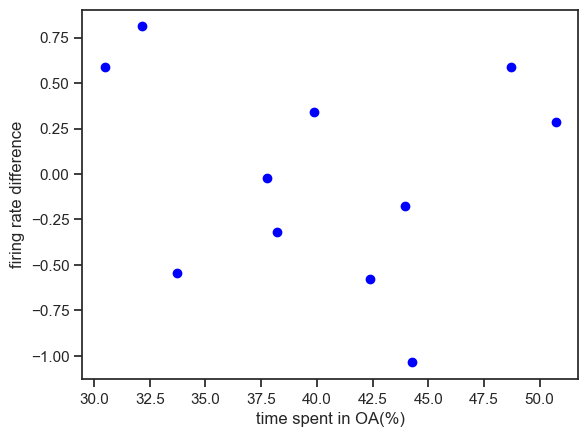

In [40]:
#correlation between time spent in OA and diff in the firing rate of open arm and close arm
from scipy.stats import pearsonr
time_OA = np.array([0.33736836, 0.30491497, 0.32152589, 0.39853123, 0.50727377,
       0.37783697, 0.43946744, 0.48726553, 0.38204719, 0.42385969,
       0.44270116])

firing_rate_OA_CA = []
for i in range(len(firing_rate_closedarm_per_mouse)):
    difference = np.mean(firing_rate_closedarm_per_mouse[i]) - np.mean(firing_rate_openarm_per_mouse[i])
    firing_rate_OA_CA.append(difference)


plt.scatter(time_OA*100,firing_rate_OA_CA, color = 'blue')
plt.xlabel("time spent in OA(%)")
plt.ylabel("firing rate difference")    
correlation_coefficient, p_value = pearsonr(time_OA, firing_rate_OA_CA)
print(correlation_coefficient)

In [587]:
unique_values, counts = np.unique(firing_rate_openarm_per_mouse[6], return_counts=True)
unique_values, counts = np.unique(firing_rate_closedarm_per_mouse[6], return_counts=True)

for i in range(len(unique_values)):
    print(unique_values[i] , ':',counts[i])
open_arm_1sec_bin

0.0 : 1895
1.0 : 1563
2.0 : 1688
3.0 : 1752
4.0 : 1797
5.0 : 1724
6.0 : 1599
7.0 : 1609
8.0 : 1513
9.0 : 1337
10.0 : 1183
11.0 : 961
12.0 : 849
13.0 : 675
14.0 : 589
15.0 : 529
16.0 : 411
17.0 : 297
18.0 : 286
19.0 : 222
20.0 : 205
21.0 : 166
22.0 : 140
23.0 : 123
24.0 : 107
25.0 : 119
26.0 : 98
27.0 : 77
28.0 : 73
29.0 : 54
30.0 : 49
31.0 : 46
32.0 : 41
33.0 : 33
34.0 : 20
35.0 : 21
36.0 : 21
37.0 : 13
38.0 : 13
39.0 : 4
40.0 : 7
41.0 : 4
42.0 : 1
43.0 : 3
46.0 : 1
47.0 : 2
48.0 : 2
49.0 : 1
52.0 : 1
56.0 : 1


array([[11.,  3., 11., ...,  6., 22.,  6.],
       [16.,  4., 10., ..., 12., 24., 10.],
       [ 4.,  3., 18., ...,  9., 31.,  2.],
       ...,
       [ 2.,  2., 28., ...,  8., 13., 12.],
       [ 1.,  3., 21., ...,  9., 26.,  5.],
       [ 7.,  2.,  8., ...,  5., 33., 11.]])

In [13]:
#firing rate per mouse in open and close arm stats
def plot_per_mouse_oa_ca_units(oa_units,ca_units,save_path):
    mean_oa = np.mean(oa_units)
    mean_ca = np.mean(ca_units)

    # Create figure and axis
    fig, ax = plt.subplots(figsize=(6, 4))

    # Plot two bars with subtle colors
    bars = ax.bar([0, 1], [ mean_ca, mean_oa], width=0.5, color=['#C0C0C0', '#ADD8E6'], tick_label=['close arm', 'open arm'])

    # Add semi-transparent black points for each data point in the lists
    # ax.scatter(np.zeros(len(ca_units)), ca_units, color='black', s=50, alpha=0.6, zorder=3)
    # ax.scatter(np.ones(len(oa_units)), oa_units, color='black', s=50, alpha=0.6, zorder=3)

    # for i in range(len(oa_units)):
    #     ax.plot([0, 1], [ca_units[i], oa_units[i]], color='black', alpha=0.6, zorder=2)

    # Set labels and title
    ax.set_ylabel('Average firing rate', fontsize=12)
    # ax.set_title('oaibitory vs cacitatory Units', fontsize=14)
    if save_path:
        plt.savefig(save_path)


    plt.show()
    plt.close()

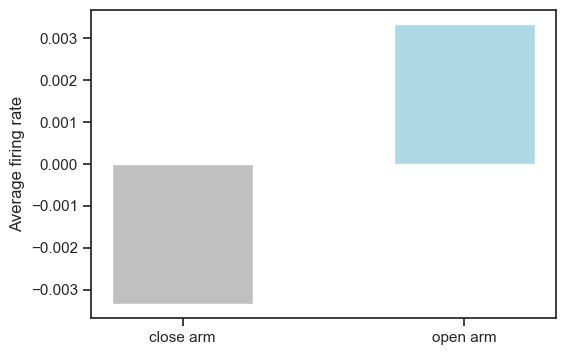

In [18]:
ca_pm_z = []
oa_pm_z = []
for i in range(len(z_ca_permouse)):
    av_fr_Ca =np.mean(z_ca_permouse[i])
    ca_pm_z.append(av_fr_Ca )

    av_fr_oa = np.mean(z_oa_permouse[i])
    oa_pm_z.append(av_fr_oa)

plot_per_mouse_oa_ca_units(oa_pm_z,ca_pm_z, save_path=False)

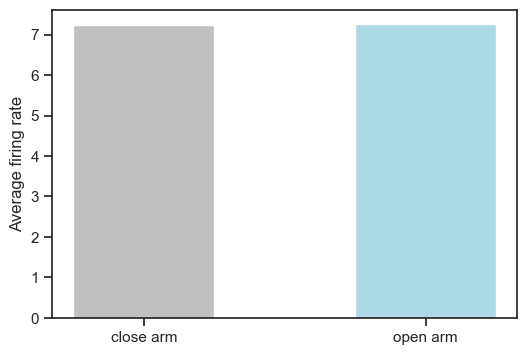

In [564]:
ca_pm = []
oa_pm = []
for i in range(len(firing_rate_closedarm_per_mouse)):
    av_fr_Ca =np.mean(firing_rate_closedarm_per_mouse[i])
    ca_pm.append(av_fr_Ca )

    av_fr_oa = np.mean(firing_rate_openarm_per_mouse[i])
    oa_pm.append(av_fr_oa)

plot_per_mouse_oa_ca_units(oa_pm,ca_pm, save_path=False)


In [575]:
unique_values, counts = np.unique(zscore_openarm, return_counts=True)
# Initialize an empty dictionary to store counts for each range
range_counts = {}
# Loop over the range -2 to 9 with step size 1
for i in range(-3, 9):
    # Get the sum of counts for the current range (i to i+1)
    count_in_range = np.sum(counts[(unique_values >= i) & (unique_values < i + 1)])
    
    # Store the count in the dictionary
    range_counts[f"{i} to {i+1}"] = count_in_range
# Print the counts for each range
for key, value in range_counts.items():
    print(f"Count for range {key}: {value}")

Count for range -3 to -2: 0
Count for range -2 to -1: 0
Count for range -1 to 0: 339
Count for range 0 to 1: 266
Count for range 1 to 2: 0
Count for range 2 to 3: 0
Count for range 3 to 4: 0
Count for range 4 to 5: 0
Count for range 5 to 6: 0
Count for range 6 to 7: 0
Count for range 7 to 8: 0
Count for range 8 to 9: 0


In [565]:
# paired t-test 
from scipy import stats
t_stat, p_value = stats.ttest_rel(zscore_openarm, zscore_closedarm)
print("z score - stats", p_value)

t_stat, p_value = stats.ttest_rel(np.concatenate(all_mouse_open_arm),np.concatenate(all_mouse_closed_arm))
print("firing rate - stats", p_value)

z score - stats 0.903732718188968
firing rate - stats 0.8697849178755287


In [ ]:
# Set up the figure and axis
plt.figure(figsize=(12, 8))  # Adjust the size for better readability

# Create a heatmap using seaborn
sns.heatmap(zscore .T, cmap='viridis', cbar=True, vmin = -2, vmax = 3,
            xticklabels=50, yticklabels=4)  # Change x/y ticks as needed
# Add labels and a title
plt.xlabel('Time')
plt.ylabel('Neurons')
plt.title('Neuron Firing Rates Over Time')

# Display the plot
plt.show()

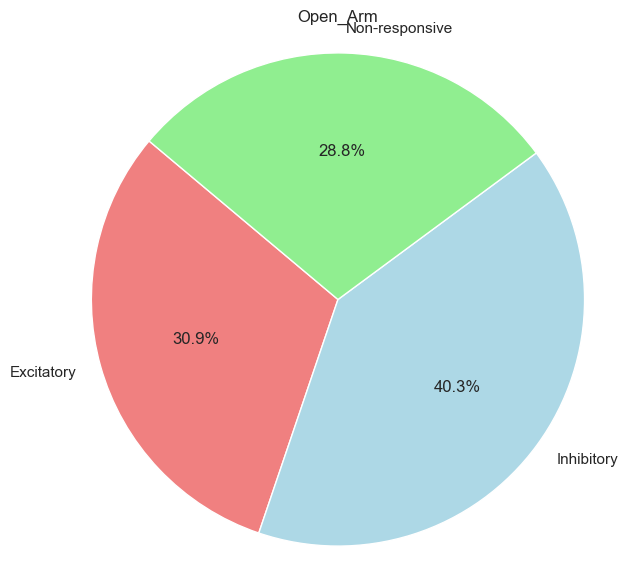

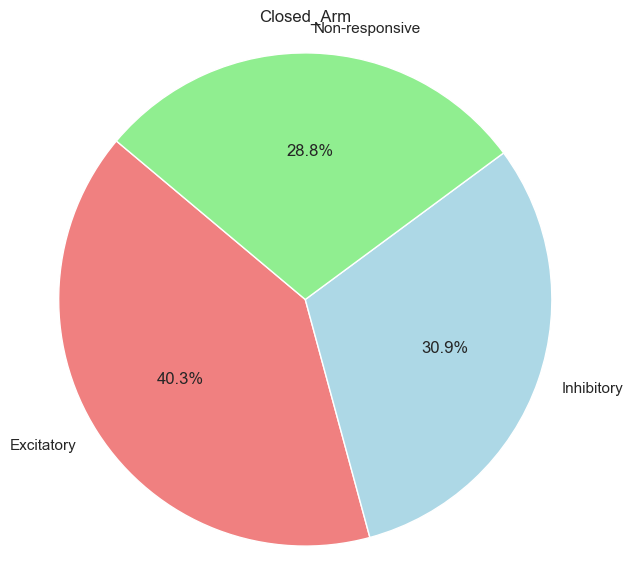

In [31]:
def plot_response_pie(data, Title):
    # Categorize the numbers
    excitatory = np.sum(data > 0.05)
    inhibitory = np.sum(data < -0.05)
    non_responsive = np.sum((data > -0.05) & (data < 0.05))
    
    # Prepare data for pie chart
    labels = ['Excitatory', 'Inhibitory', 'Non-responsive']
    sizes = [excitatory, inhibitory, non_responsive]
    colors = ['lightcoral', 'lightblue', 'lightgreen']  

    # Plot the pie chart
    plt.figure(figsize=(7, 7))
    plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
    plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
    plt.title(Title)
    plt.show()


plot_response_pie(np.array(zscore_openarm), Title= 'Open_Arm')
plot_response_pie(np.array(zscore_closedarm), Title= 'Closed_Arm')

In [343]:
from scipy.stats import ttest_ind

t_stat, p_value = ttest_ind(all_mouse_open_arm, all_mouse_closed_arm)
print("T-statistic:", t_stat)
print("P-value:", p_value)
if p_value < 0.05:
    print("The datasets are significantly different.")
else:
    print("The datasets are not significantly different.")

#therefore they belong to the same distribution!

T-statistic: -0.1146512557986232
P-value: 0.908740604303939
The datasets are not significantly different.


trials retained: 97.41697416974169
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71])
torch.Size([272, 71

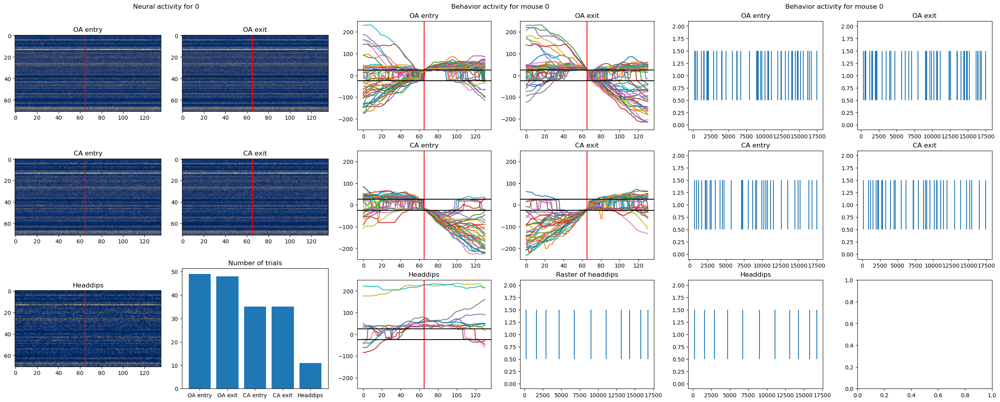

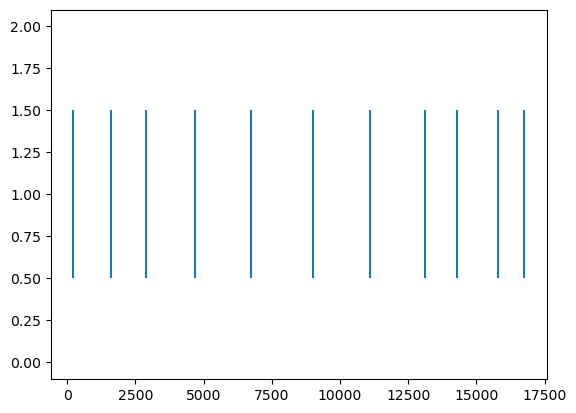

0
trials retained: 92.23300970873787
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 46])
torch.Size([272, 

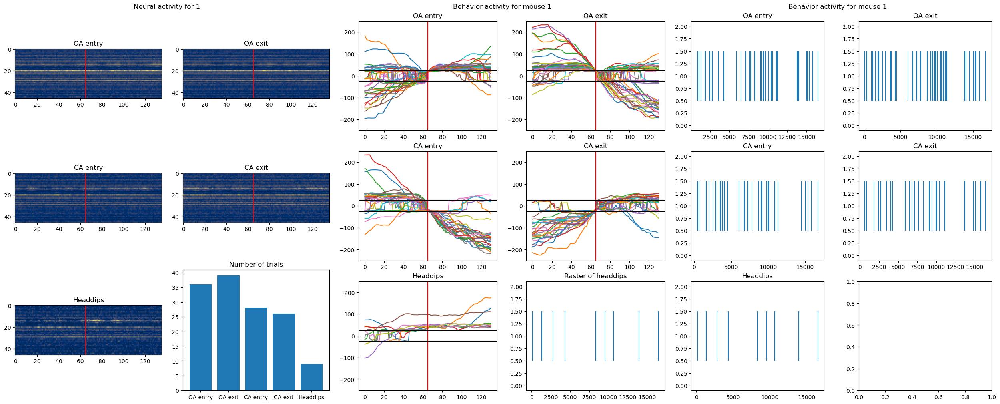

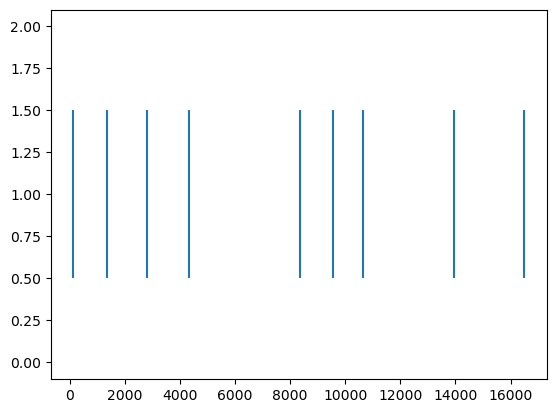

0
trials retained: 88.28451882845188
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 68])
torch.Size([272, 

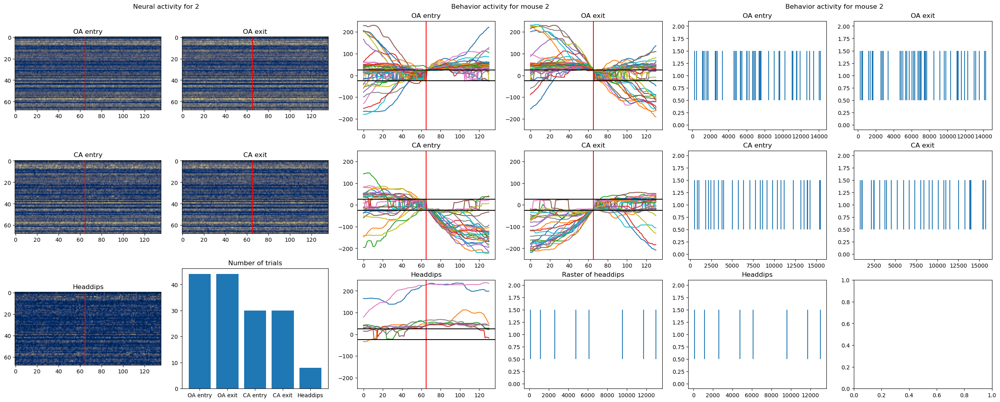

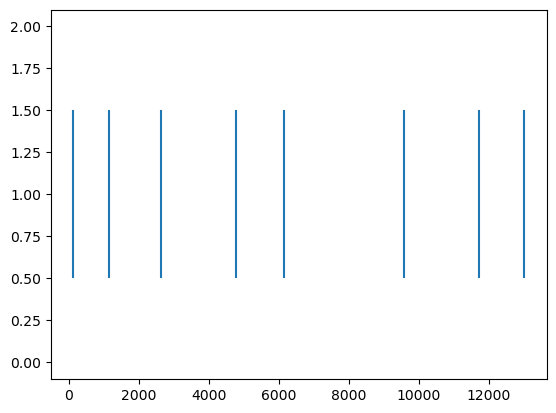

0
trials retained: 92.43027888446215
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 76])
torch.Size([272, 

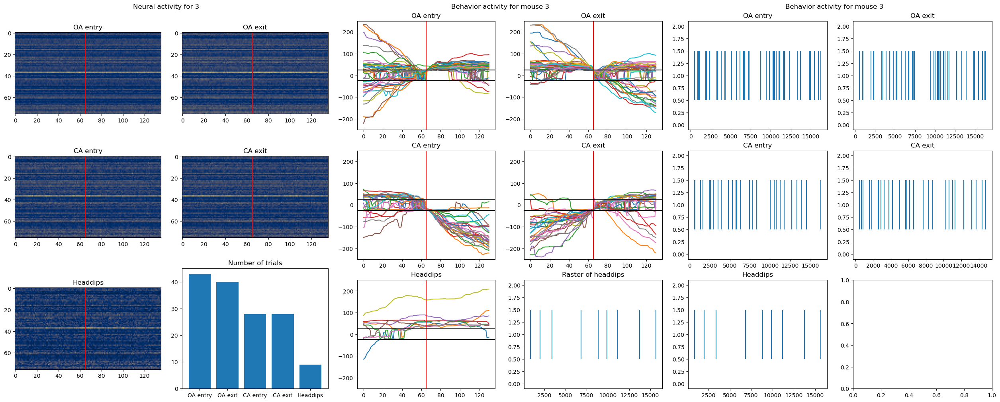

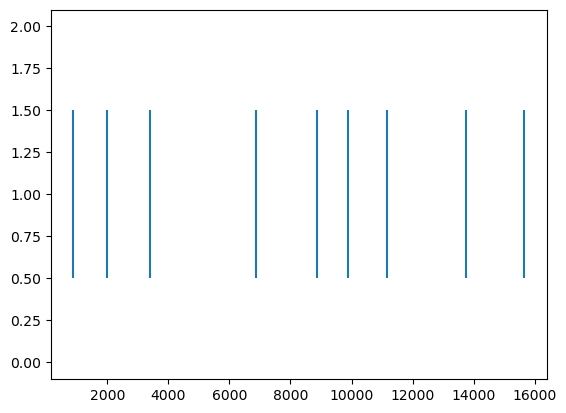

0
trials retained: 96.73024523160763
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 67])
torch.Size([272, 

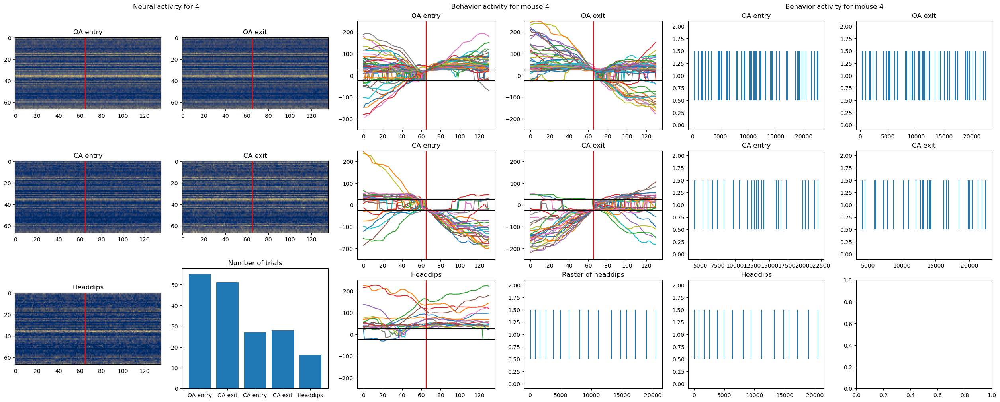

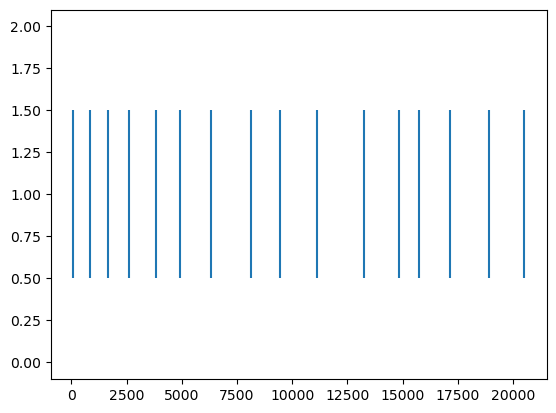

0
trials retained: 91.53846153846153
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 34])
torch.Size([272, 

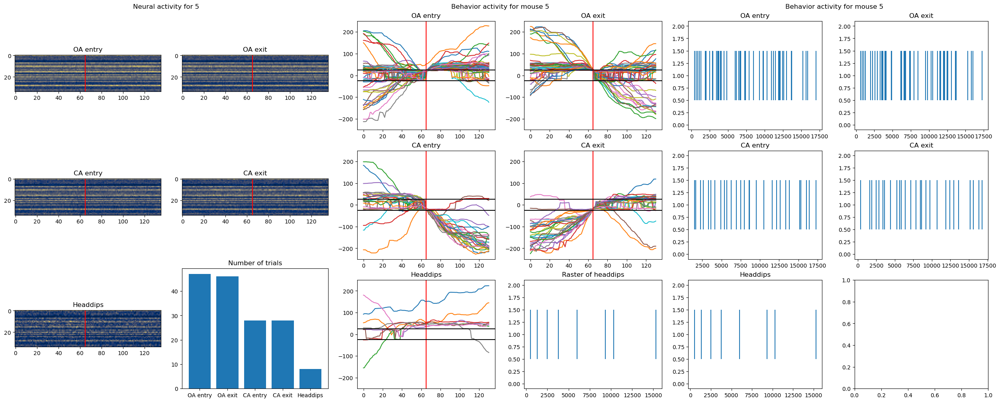

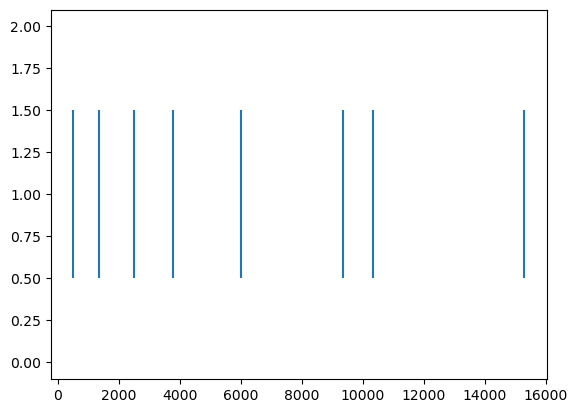

0
trials retained: 99.65034965034965
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 55])
torch.Size([272, 

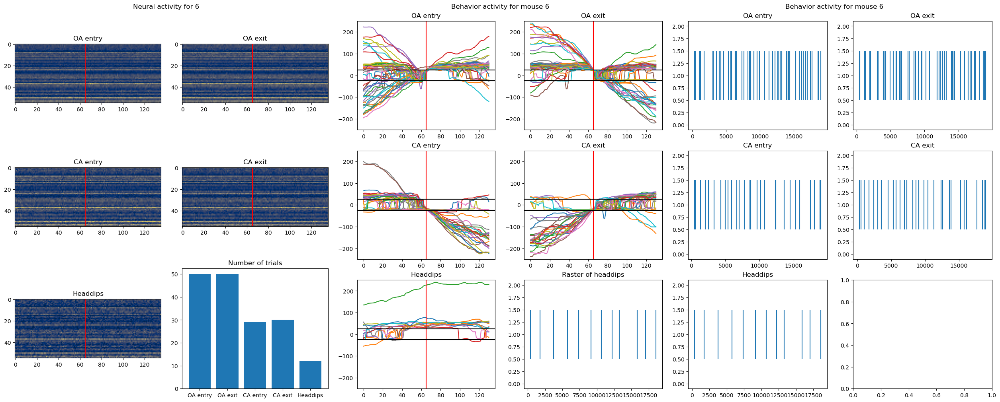

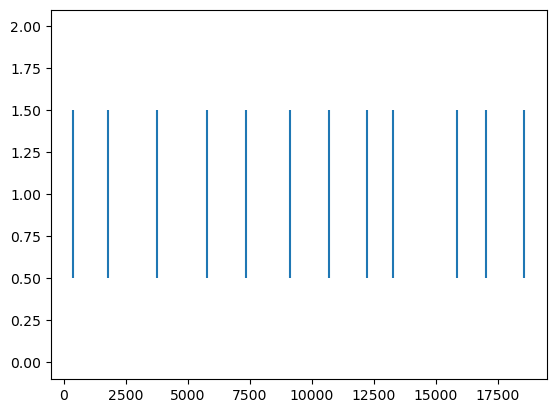

0
trials retained: 100.0
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.Size([272, 39])
torch.S

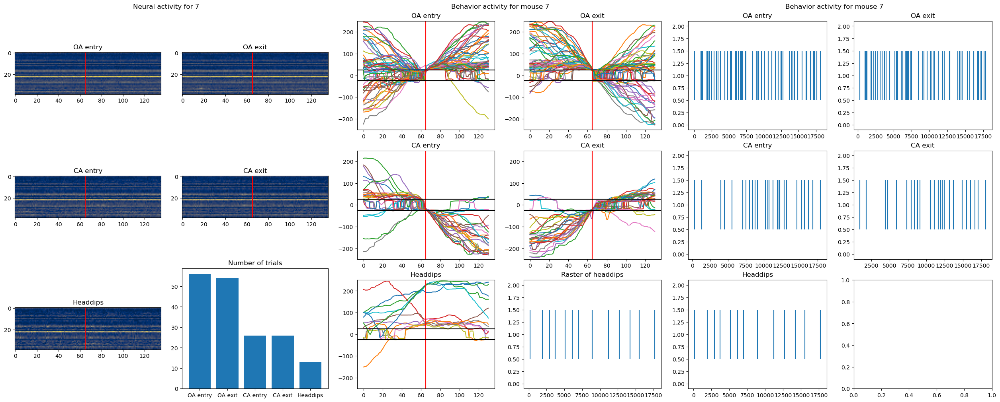

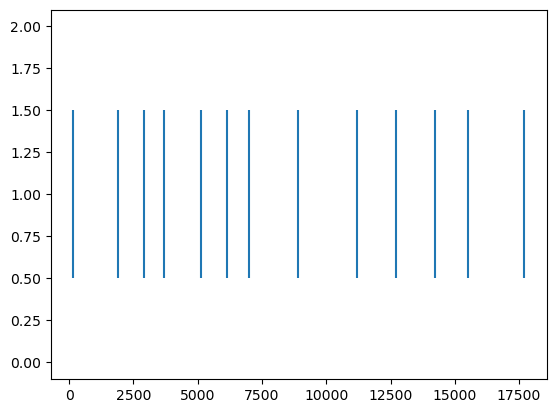

0
trials retained: 98.24561403508773
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 37])
torch.Size([272, 

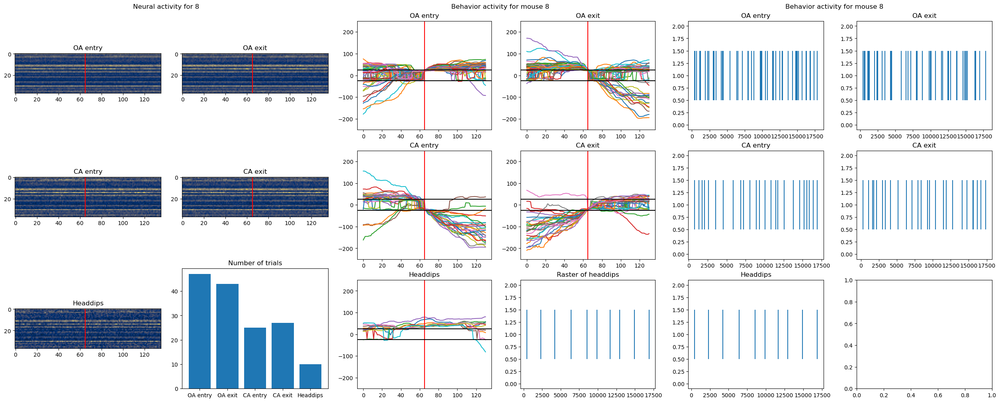

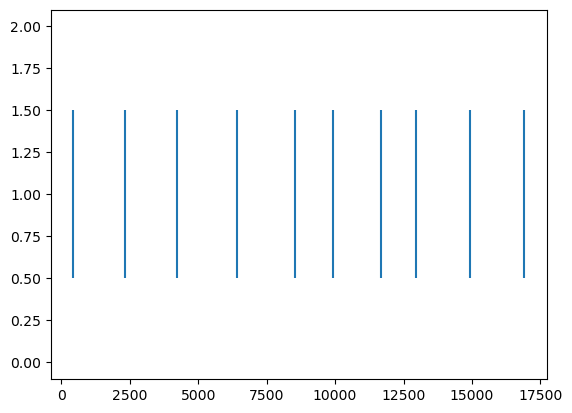

0
trials retained: 99.22178988326849
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 69])
torch.Size([272, 

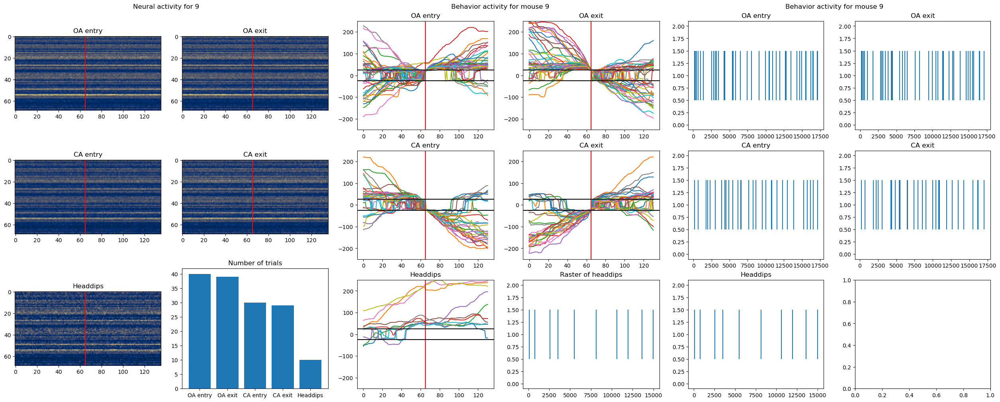

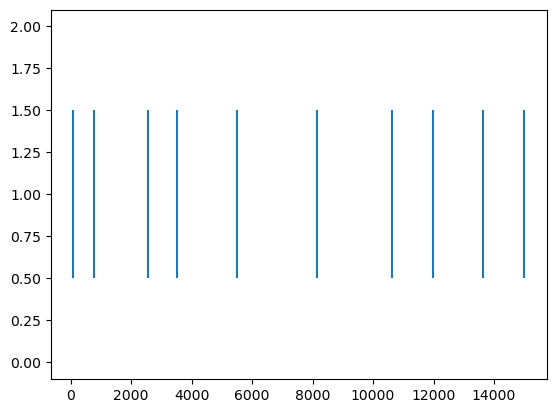

0
trials retained: 97.61904761904762
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 43])
torch.Size([272, 

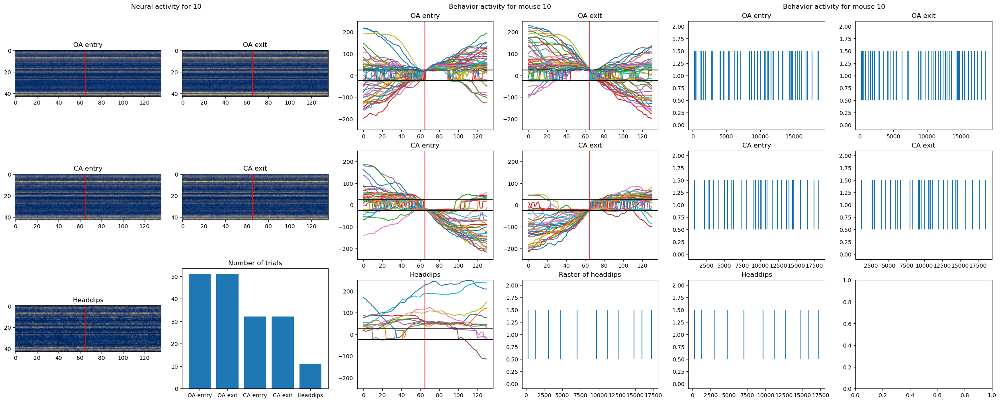

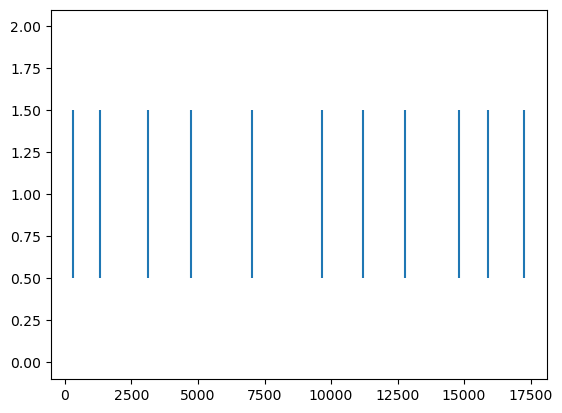

0


In [21]:
%matplotlib inline
allmice_behavior_avgtrials,allmice_neural_avgtrials, allmice_neural_avgtrials_25, allmice_dividedtrials,allmice_dividedtrials_25, allmice_dividedtrials_beh, time_trial = PCA_preprocessing.get_preprocessed_trials(l_mouse_name, behaviour_trials, neural_trials,neural_trials_25,beh_timepoints,'entryexit')

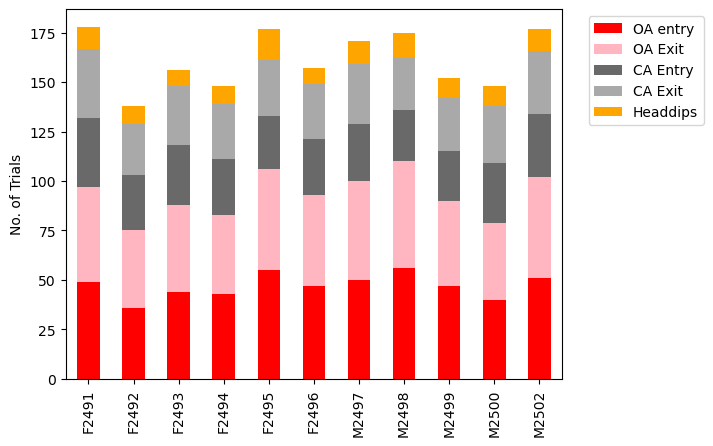

In [22]:

%matplotlib inline
len(allmice_dividedtrials[0][-1])

trialnums_global = np.zeros((len(allmice_dividedtrials), len(allmice_dividedtrials[0])))
for i in range(trialnums_global.shape[0]):
    for j in range(trialnums_global.shape[-1]):
        trialnums_global[i,j] = len(allmice_dividedtrials[i][j])

df = pd.DataFrame({'OA entry': trialnums_global[0,:],
                   'OA Exit': trialnums_global[1,:],
                   'CA Entry': trialnums_global[2,:],
                   'CA Exit': trialnums_global[3,:],
                   'Headdips': trialnums_global[-1,:]},
                   index = l_mouse_name
)
colour=["red", "lightpink", "dimgrey", "darkgrey", "orange"]
df.plot(kind='bar', stacked=True, color=colour)

#plt.bar(l_mouse_name, trialnums_global[i,:], label=trialsubtypes_entryexit[i])
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))
plt.ylabel('No. of Trials')
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Trialnums_EPM_entryexit.svg') 
plt.show()

In [23]:
# 50ms sliding window           
allmice_behavior_avgtrials_sliding = [None]*len(allmice_dividedtrials)
allmice_behavior_avgtrials_25_sliding = [None]*len(allmice_dividedtrials)
len_trial = allmice_neural_avgtrials[0].shape[-1]-5
len_trial_25 = allmice_neural_avgtrials_25[0].shape[-1]-10
window = 5 # 50 * 5 - 250ms + 50 ms sliding window
window_25 = 10 # 25ms bin * 10 

for i in range(len(allmice_dividedtrials)):
    allmice_behavior_avgtrials_sliding[i]= np.zeros((allmice_neural_avgtrials[i].shape[0],len_trial))
    for j in range(len_trial):
        allmice_behavior_avgtrials_sliding[i][:,j] = np.sum(allmice_neural_avgtrials[i][:,j:j+window], axis=1)

for i in range(len(allmice_dividedtrials_25)):
    allmice_behavior_avgtrials_25_sliding[i]= np.zeros((allmice_neural_avgtrials_25[i].shape[0],len_trial_25))
    for j in range(len_trial_25):
        allmice_behavior_avgtrials_25_sliding[i][:,j] = np.sum(allmice_neural_avgtrials_25[i][:,j:j+window_25], axis=1)

##### Single Unit Analysis - PCA and PCA stats

(605,)


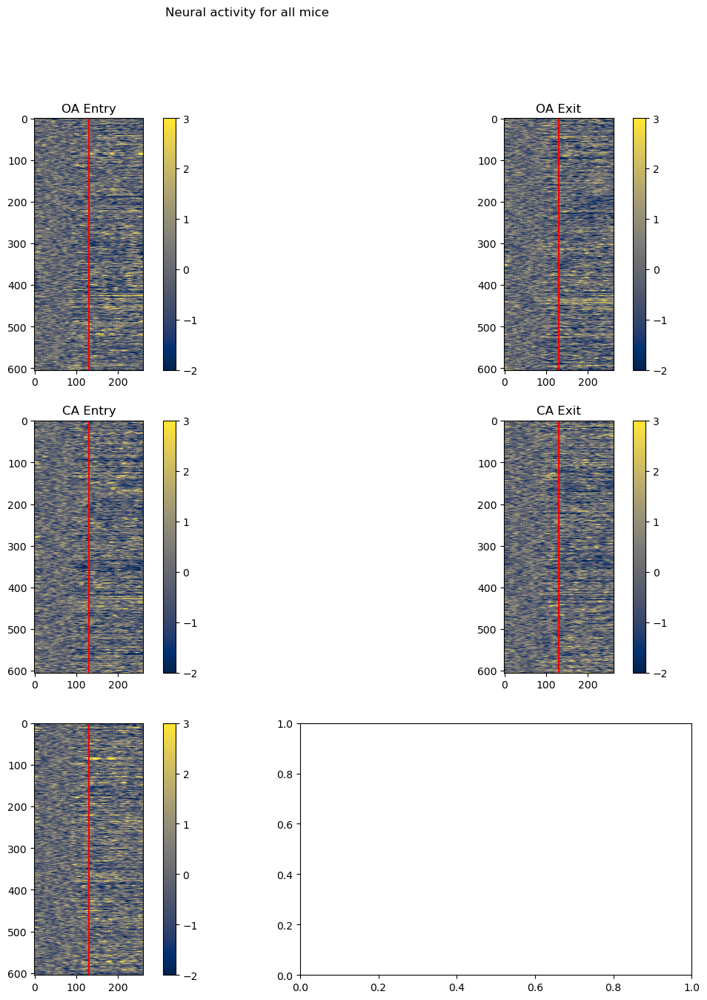

In [24]:
%matplotlib inline
# z score calculation
allmice_neural_avgtrials_zscored,ignoreunits = PCA_preprocessing.z_score_orderedhm(allmice_behavior_avgtrials_25_sliding.copy(), window_bin=0.025)

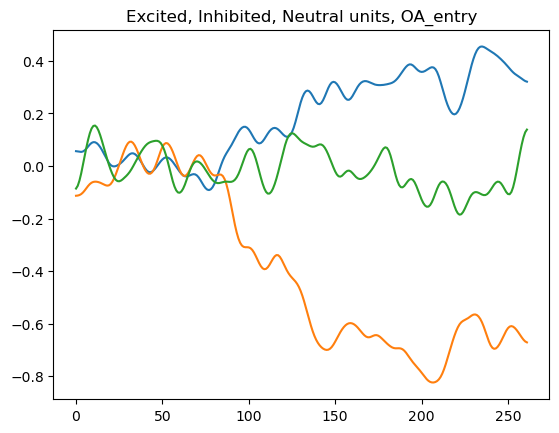

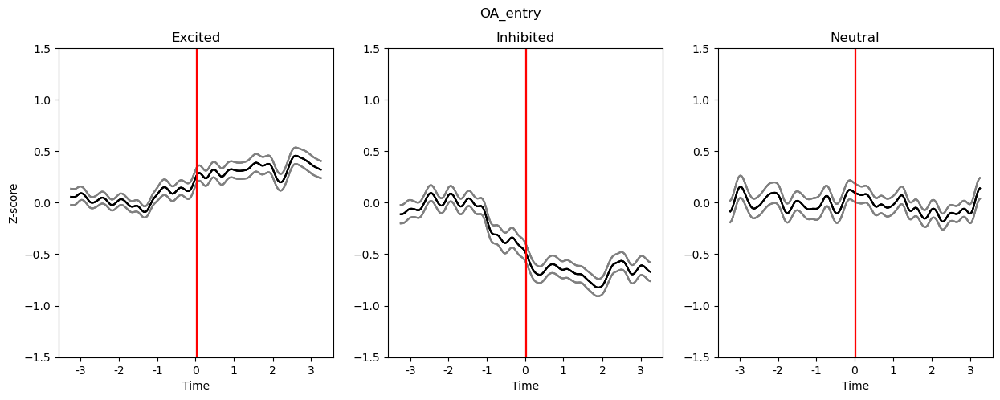

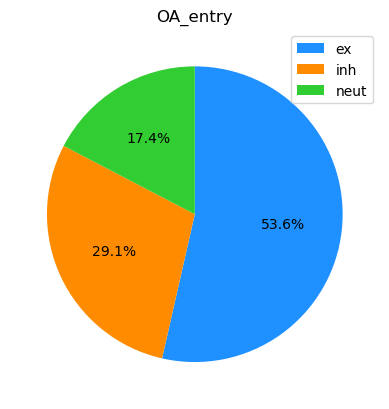

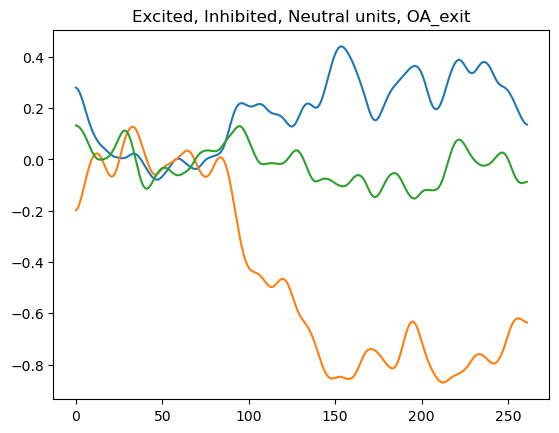

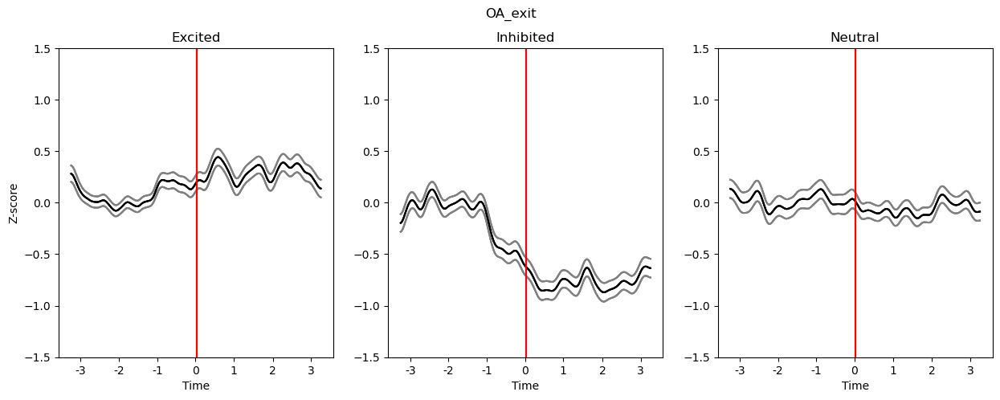

...

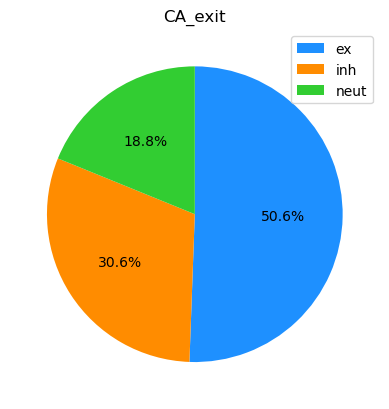

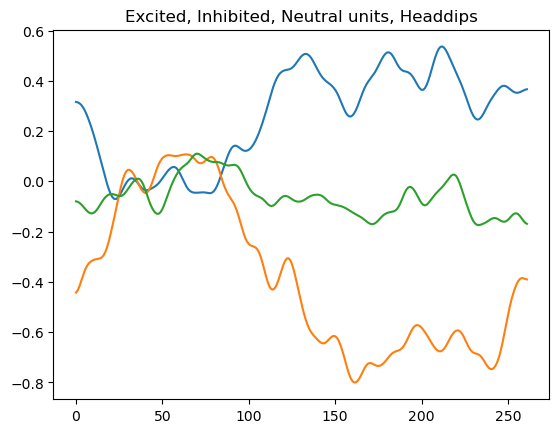

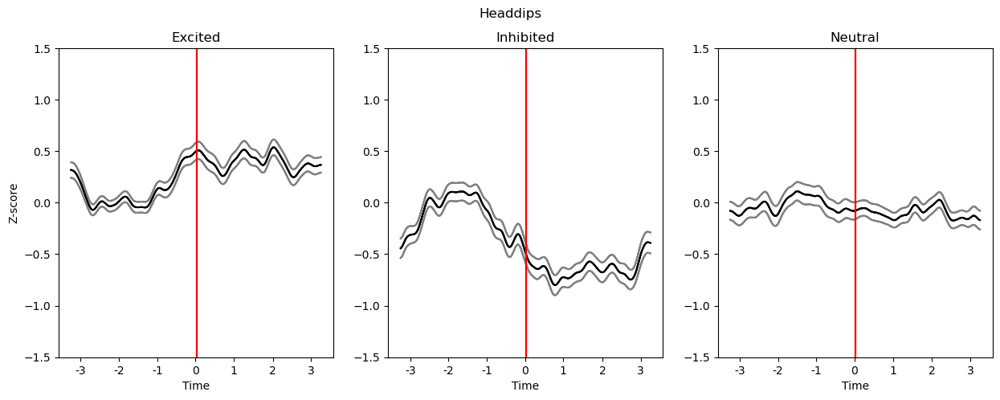

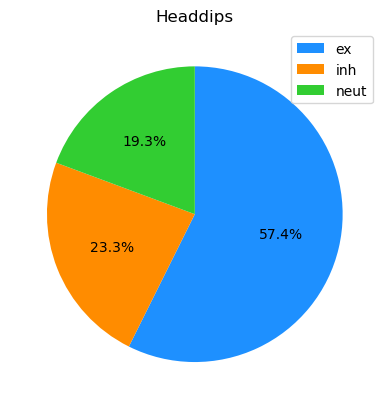

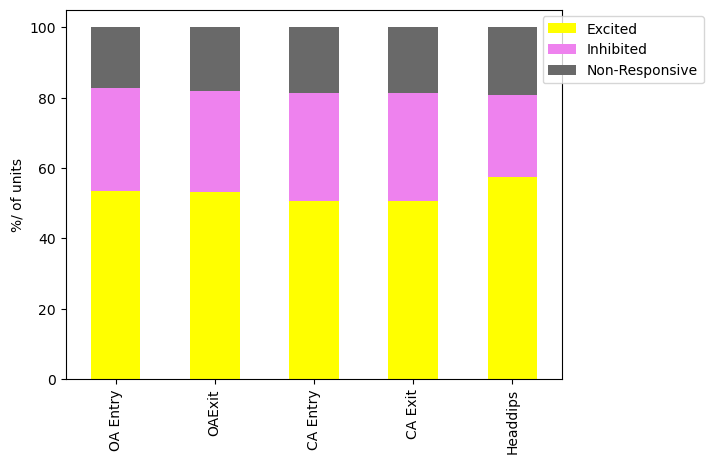

In [25]:
%matplotlib inline
ehm = [None]*5
ihm = [None]*5
rhm = [None]*5
ehm_idx = [None]*5
ihm_idx = [None]*5
rhm_idx = [None]*5
ehm_size = [None]*5
ihm_size = [None]*5
rhm_size = [None]*5
trialtype = ["OA_entry", "OA_exit", "CA_entry", "CA_exit", "Headdips"]

for i in range(len(ehm)):
    ehm[i], ihm[i], rhm[i], ehm_idx[i], ihm_idx[i], rhm_idx[i] = PCA_preprocessing.ehm_ihm_rhm_pertrial_new(allmice_neural_avgtrials_zscored[i], trialtype[i],window_bin=0.025, savefigs=True) # actually per session
    ehm_size[i] = ehm[i].shape[0]/(ehm[i].shape[0]+ihm[i].shape[0]+rhm[i].shape[0])
    ihm_size[i] = ihm[i].shape[0]/(ehm[i].shape[0]+ihm[i].shape[0]+rhm[i].shape[0])
    rhm_size[i] = rhm[i].shape[0]/(ehm[i].shape[0]+ihm[i].shape[0]+rhm[i].shape[0])

# bar plots

df = pd.DataFrame({'Excited': np.array(ehm_size)*100,
                'Inhibited':np.array(ihm_size)*100,
                'Non-Responsive':np.array(rhm_size)*100},
                index = ['OA Entry','OAExit', 'CA Entry', 'CA Exit','Headdips']
)
colour=["yellow", "violet", "dimgrey"]
df.plot(kind='bar', stacked=True, color=colour)

#plt.bar(l_mouse_name, trialnums_global[i,:], label=trialsubtypes_entryexit[i])
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))
plt.ylabel('%/ of units')
# plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/exc_ihn_rhm_unitbarplotnums.svg')
plt.show()

In [42]:
def create_custom_tab20_tab20c_cmap():
    # Define the 'Pastel1' colormap and select the first two colors
    cmap_Set1 = plt.get_cmap('Set1') #Pastel1
    color1 = cmap_Set1(0)
    color2 = cmap_Set1(1)
    
    cmap_Pastel1 = plt.get_cmap('Pastel1') #Pastel1
    color3 = cmap_Pastel1(cmap_Pastel1.N - 1)  # THird color

    # Create a new colormap by interpolating between the two colors
    colors = [color2,color3, color1]

    n_colors = 100  # Number of gradient colors
    new_cmap = LinearSegmentedColormap.from_list('custom_tab20_tab20c', colors, N=n_colors)
    return new_cmap

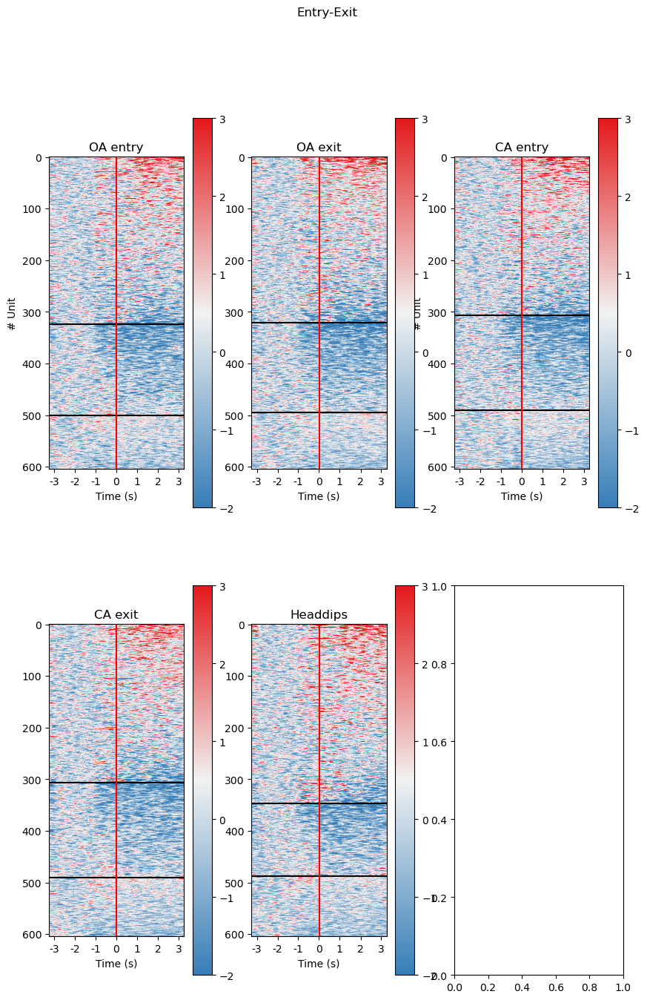

In [43]:
# Heatmap ordering 
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, TwoSlopeNorm
custom_tab20_tab20c_cmap = create_custom_tab20_tab20c_cmap()
trialtitle = ["Entry-Exit", "Arm to Arm"]
trialsubtypes_entryexit = ["OA entry", "OA exit", "CA entry", "CA exit", "Headdips"]
trialsubtypes_8t = ["OA - OA", "CA - CA", "OA - CA", "CA - OA","Headdips"]
finalunits_entryexit = PCA_preprocessing.plotheatmap(
    ehm, ihm, rhm, trialtitle[0], trialsubtypes_entryexit, savefig=True, vmax=3, vmin=-2, cmap=custom_tab20_tab20c_cmap)

In [26]:
mean_FR_EPM = []
for i in range(len(l_data_25)):
    y = np.array((l_data_25[i]/0.025)) #25ms time binned data - fr = spikes/time in sec
    x = np.mean(y, axis = 0)
    mean_FR_EPM.append(x)
print (mean_FR_EPM)
mean_FR_EPM_units_all = pd.DataFrame(mean_FR_EPM)
mean_FR_EPM_units_all.to_excel("RESULTS/NOT-INJECTED/mean_FR_EPM_units_all_20240707.xlsx")

[array([ 3.9593964 ,  4.8051243 ,  4.189556  ,  3.9105418 , 15.175334  ,
        4.9343176 ,  1.1127999 ,  6.4118986 ,  3.7650635 ,  3.1766367 ,
        2.107263  , 12.208229  ,  6.33156   , 28.041471  ,  3.8638585 ,
        4.166757  ,  8.773206  ,  7.5062428 ,  5.0743675 ,  7.8362827 ,
        7.9350777 ,  8.281403  ,  4.780154  ,  6.0753446 ,  6.2164803 ,
        5.790902  , 14.376289  ,  9.49734   ,  9.856693  ,  6.4281836 ,
        5.4695473 ,  6.1904244 ,  5.4239497 ,  7.685376  ,  4.7182717 ,
        5.092824  ,  8.443166  ,  4.367604  ,  0.61556834,  2.8357399 ,
        7.703832  ,  3.8171751 ,  3.093041  , 11.973727  ,  8.320486  ,
        2.981218  , 10.926066  ,  5.9765496 ,  4.8235803 ,  9.533167  ,
        3.0409293 ,  5.397894  ,  2.5436978 ,  3.788948  , 10.913039  ,
        6.58669   ,  4.650961  ,  8.255347  ,  4.513082  ,  2.5708392 ,
        1.8988166 ,  1.7717946 ,  6.417327  , 10.351753  ,  2.4829009 ,
        2.6761482 ,  5.6182823 , 17.64195   , 16.509607  , 11.7

In [30]:
bigarr = np.array(allmice_neural_avgtrials_zscored[0])
for i in range(0, len(allmice_neural_avgtrials_zscored)):
    if i != 0:
        bigarr = np.hstack((bigarr,allmice_neural_avgtrials_zscored[i]))
bigarr.shape

(605, 1310)

In [31]:
excludetrials = np.concatenate((np.arange(len_trial_25,len_trial_25*2), np.arange(len_trial_25*3, len_trial_25*4)))
bigarr = np.delete(bigarr, excludetrials, axis=1)
bigarr.shape

(605, 786)

# Population Dynamics - PCA

In [32]:
l_proj_5trials, var_5trials ,pc_original = PCA_preprocessing.PCA_analysis(l_data_PCA=bigarr)

Dimension of projected data:
(786, 3)


In [ ]:
# with open('RESULTS/NOT-INJECTED/mouseDataNew/bigarr_EPM_Not_injected_mouse.pkl', 'wb') as f:
#     pickle.dump(bigarr,f)

Text(0, 0.5, 'PC1')

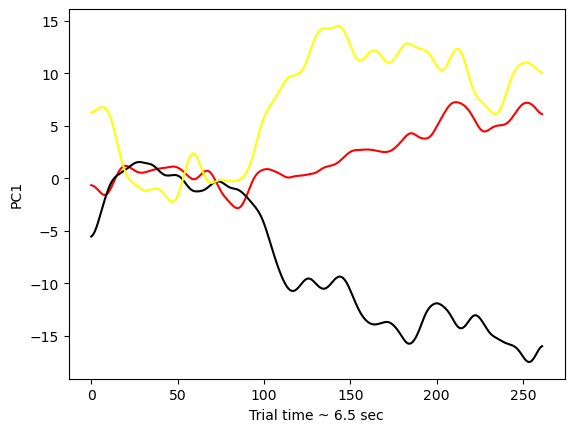

In [33]:
%matplotlib inline
plt.plot(gaussian_filter1d(l_proj_5trials[:262,0], sigma = 3), color = 'red')
plt.plot(gaussian_filter1d(l_proj_5trials[262:524,0], sigma = 3), color = 'black')
plt.plot(gaussian_filter1d(l_proj_5trials[524:,0], sigma = 3), color = 'yellow')

plt.xlabel('Trial time ~ 6.5 sec')
plt.ylabel('PC1')

Text(0, 0.5, 'PC2')

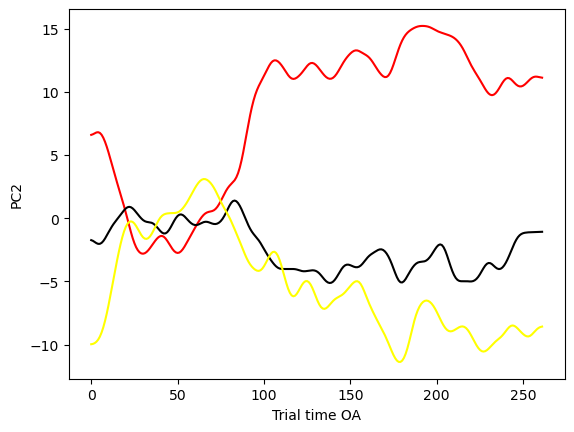

In [34]:
%matplotlib inline
plt.plot(gaussian_filter1d(l_proj_5trials[:262,1], sigma = 3), color = 'red')
plt.plot(gaussian_filter1d(l_proj_5trials[262:524,1], sigma = 3), color = 'black')
plt.plot(gaussian_filter1d(l_proj_5trials[524:,1], sigma = 3), color = 'yellow')

plt.xlabel('Trial time OA')
plt.ylabel('PC2')

Text(0, 0.5, 'PC3')

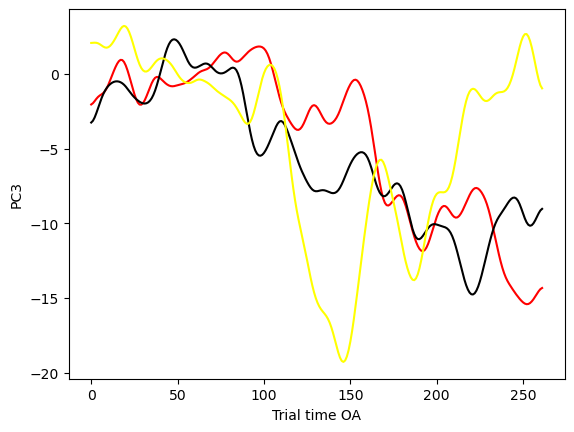

In [35]:
%matplotlib inline
plt.plot(gaussian_filter1d(l_proj_5trials[:262,2], sigma = 3), color = 'red')
plt.plot(gaussian_filter1d(l_proj_5trials[262:524,2], sigma = 3), color = 'black')
plt.plot(gaussian_filter1d(l_proj_5trials[524:,2], sigma = 3), color = 'yellow')

plt.xlabel('Trial time OA')
plt.ylabel('PC3')

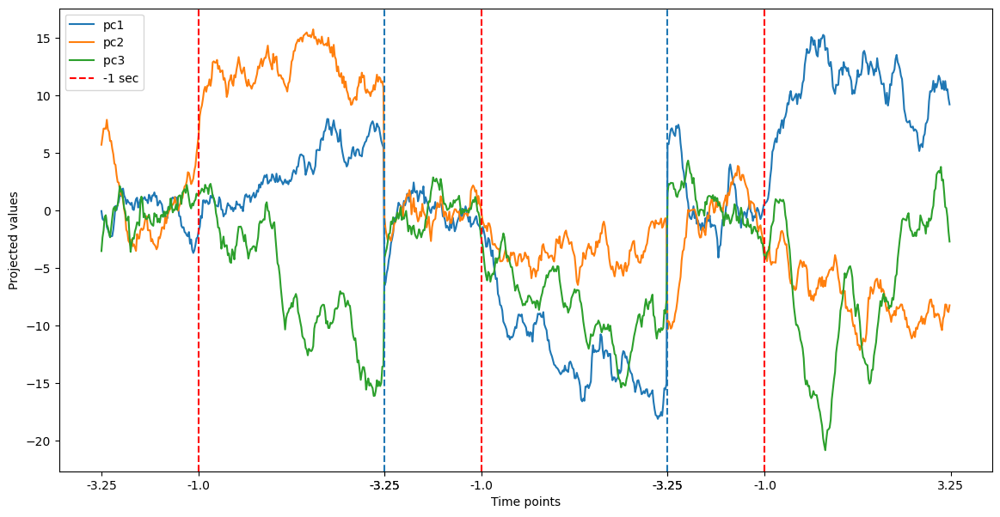

In [36]:
# plt.figure((10,4))
plt.figure(figsize=(14, 7))
plt.plot(l_proj_5trials[:,0], label='pc1')
plt.plot(l_proj_5trials[:,1], label = 'pc2')
plt.plot(l_proj_5trials[:,2], label = 'pc3 ')

plt.xlabel('Time points')
plt.ylabel('Projected values')
# plt.axhline(y=-2.5, color='r', linestyle='--', label='y = -2.5')
plt.axvline(x=262, linestyle='--')
plt.axvline(x=524, linestyle='--')
# x_ticks = range(0, l_proj_5trials.shape[0], 50)  # Adjust the step size (50 in this case) as needed
# plt.xticks(x_ticks)

segment_length = 262  # Number of time points per segment

# Define the relative positions for -3.25, -1, and 3.25 within a segment
relative_positions = [0, int(segment_length * 0.346), segment_length]  # -3.25 at 0, -1 at ~34.6%, +3.25 at end

# Combine positions for all three segments
x_ticks = np.concatenate([np.array(relative_positions),
                          np.array(relative_positions) + segment_length,
                          np.array(relative_positions) + 2 * segment_length])

# Define the labels for -3.25, -1, and 3.25
x_labels = np.tile([-3.25, -1, 3.25], 3)  # Repeat the labels for all three segments


# Add vertical lines at -1 second in each segment
plt.axvline(x=int(segment_length * 0.346), color='r', linestyle='--', label='-1 sec')  # For first segment
plt.axvline(x=int(segment_length * 0.346) + segment_length, color='r', linestyle='--')  # For second segment
plt.axvline(x=int(segment_length * 0.346) + 2 * segment_length, color='r', linestyle='--')  # For third segment
plt.xticks(x_ticks, labels=x_labels)
# plt.axvline(x=802, linestyle='--', label='HD')

plt.legend()
# plt.hlines(colors='red')

16.580703079867067


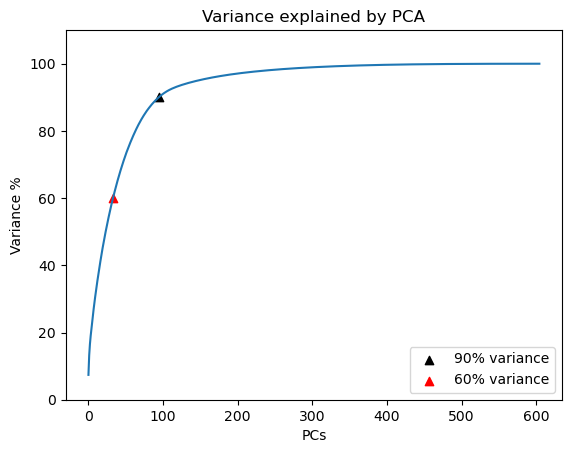

In [37]:
%matplotlib inline
plt.plot(np.cumsum(var_5trials)*100)
pc_90perc = np.where(np.cumsum(var_5trials)>=0.9)[0][0]
pc_30perc = np.where(np.cumsum(var_5trials)>=0.3)[0][0]
pc_60perc = np.where(np.cumsum(var_5trials)>=0.6)[0][0]
# plt.axvline(x = pc_90perc, linestyle='--', c='k',label='90% variance')
# plt.axvline(x = pc_60perc, c='grey', linestyle='--', label='60% variance')
# plt.axvline(x = pc_30perc, c='k', linestyle='-.', label='30% variance')
print(np.sum(var_5trials[0:3])*100)
plt.scatter(pc_90perc, 90, marker='^', c='k', label='90% variance')
plt.scatter(pc_60perc, 60, marker="^", c='r', label="60% variance")
plt.xlabel('PCs')
plt.ylabel('Variance %')
plt.title('Variance explained by PCA')
plt.legend()
plt.ylim([0,110])
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Variance_PCA_EPM.svg')
plt.show()

0
262
262
524
524


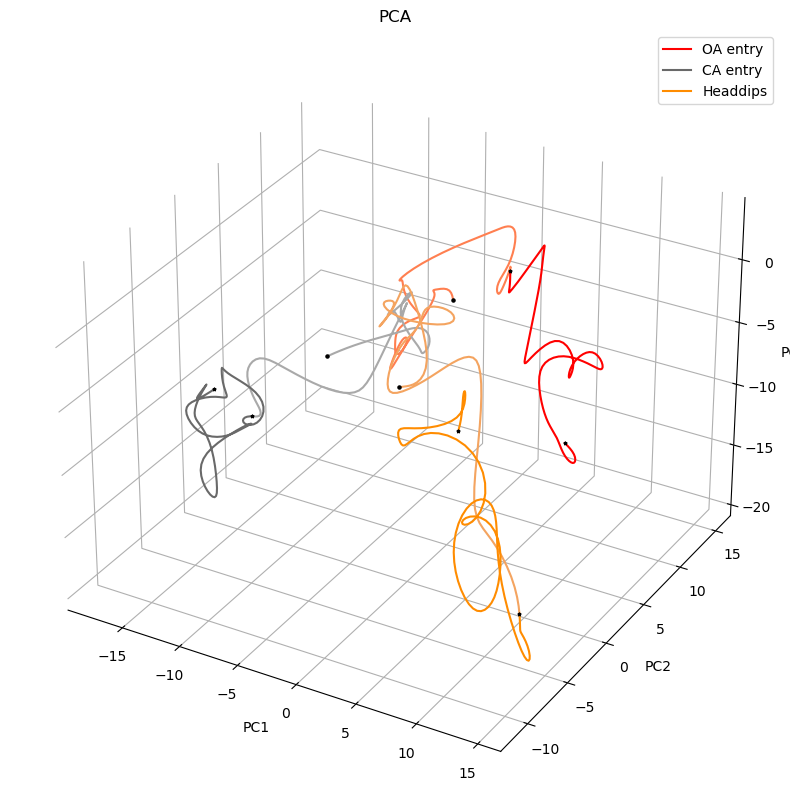

PC1(%)= 7.395337836698211
PC2(%)= 5.8406565289316505
PC3(%)= 3.344708714237208


In [38]:
c=0
%matplotlib inline
# to make plot interactive, run "%matplotlib qt" instead of "%matplotlib inline"
# ensure that your environment has the package "pyqt" installed (perferrably "pyqt5")

# save this figure manually
len_trial = len_trial_25#(finalunits_entryexit[0].shape[1]) # time
c1 = len_trial # 121
colours = ['red', 'lightcoral', 'dimgrey', 'darkgrey', 'darkorange'] #['red', 'orange','green', 'blue', "black"]
colours_lighter = ['coral', 'pink', 'darkgrey','grey', 'sandybrown']
leg = ["OA entry", "OA exit", "CA entry", "CA exit", "Headdips"]

fig = plt.figure(figsize=(10,10),facecolor='white')
ax = plt.axes(projection='3d')

ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# Now set color to white (or whatever is "invisible")
ax.xaxis.pane.set_edgecolor('w')
ax.yaxis.pane.set_edgecolor('w')
ax.zaxis.pane.set_edgecolor('w')

for i in range(5):#len(finalunits_entryexit)):
    sig = 3
    print(c)
    if i ==1 or i==3:
        continue
    x = gaussian_filter1d(l_proj_5trials[c:c1,0], sigma=sig)
    y = gaussian_filter1d(l_proj_5trials[c:c1,1], sigma=sig)
    z = gaussian_filter1d(l_proj_5trials[c:c1,2], sigma=sig)
    mid = int(x.size/2)
    plt.plot(x[:1+mid],y[:1+mid],z[:1+mid], c = colours_lighter[i])
    plt.plot(x[mid:],y[mid:],z[mid:], label = leg[i], c = colours[i])
    ax.scatter3D(x[0],y[0], z[0], c='k',s=5,marker="o")
    ax.scatter3D(x[mid], y[mid], z[mid], c='k',s=5,marker="*")
    ax.scatter3D(x[-1], y[-1], z[-1], c='k',s=5,marker="*")
    # ax.set_ylim([-5,5])
    # ax.set_zlim([-5,5])
    # ax.set_xlim([-5,5])
    #ax.set_facecolor('white')
    #ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    c=c1
    c1 += len_trial

plt.legend()
plt.title('PCA')
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/PCA_allmice_allunits_EPM_definedtrials_slidingwindow.svg') 
plt.show()



print("PC1(%)=", var_5trials[0]*100)
print("PC2(%)=", var_5trials[1]*100)
print("PC3(%)=", var_5trials[2]*100)

0
262
262
524
524


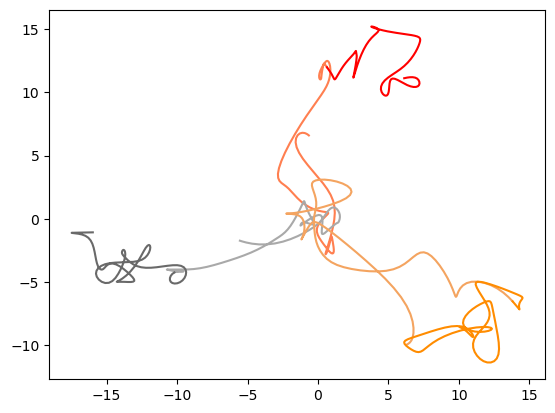

In [39]:
c= 0
c1= len_trial_25
for i in range(5):#len(finalunits_entryexit)):
    sig = 3
    print(c)
    if i ==1 or i==3:
        continue
    x = gaussian_filter1d(l_proj_5trials[c:c1,0], sigma=sig)
    y = gaussian_filter1d(l_proj_5trials[c:c1,1], sigma=sig)
    # z = gaussian_filter1d(l_proj_5trials[c:c1,2], sigma=sig)
    mid = int(x.size/2)
    plt.plot(x[:1+mid],y[:1+mid], c = colours_lighter[i])
    plt.plot(x[mid:],y[mid:], label = leg[i], c = colours[i])
    ax.scatter(x[0],y[0], c='k',s=5,marker="o")
    ax.scatter(x[mid], y[mid], c='k',s=5,marker="*")
    ax.scatter(x[-1], y[-1], c='k',s=5,marker="*")
    # ax.set_ylim([-5,5])
    # ax.set_zlim([-5,5])
    # ax.set_xlim([-5,5])
    #ax.set_facecolor('white')
    #ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    # ax.set_zlabel('PC3')
    c=c1
    c1 += len_trial

(605, 786)
Dimension of projected data:
(786, 605)
(534, 534)
(534, 786)


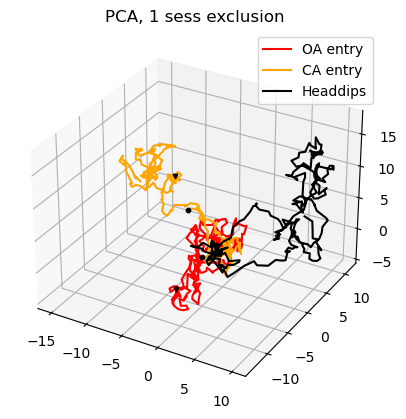

(559, 559)
(559, 786)


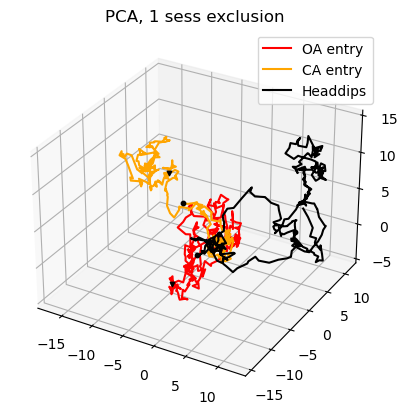

(537, 537)
(537, 786)


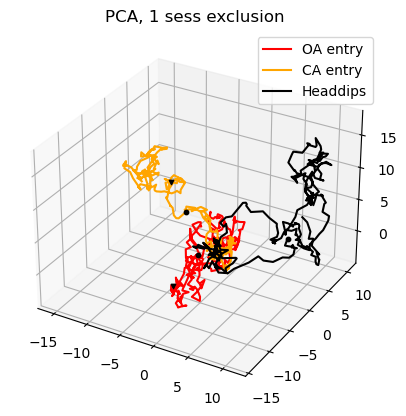

(529, 529)
(529, 786)


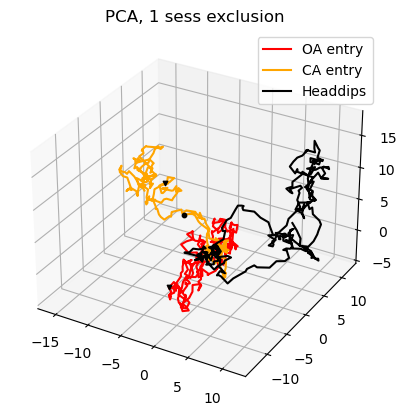

(538, 538)
(538, 786)


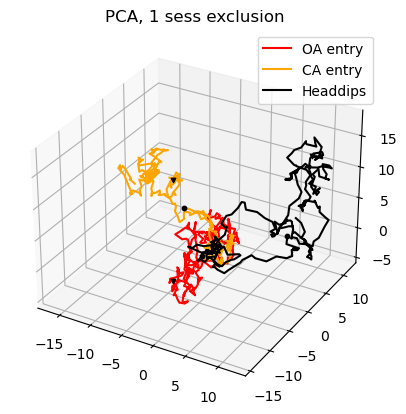

(571, 571)
(571, 786)


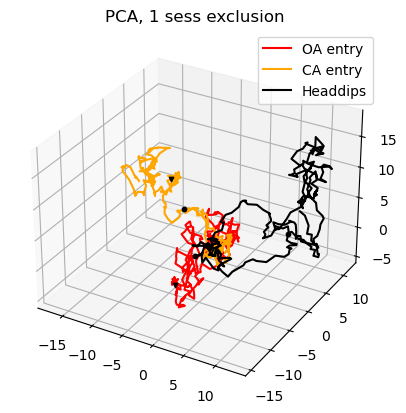

(550, 550)
(550, 786)


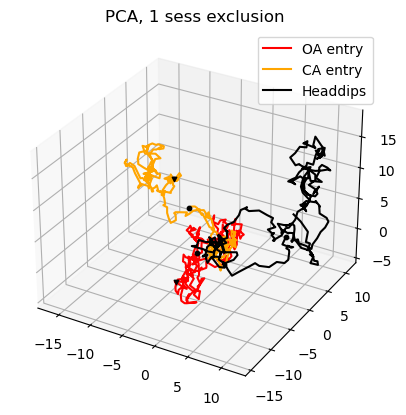

(566, 566)
(566, 786)


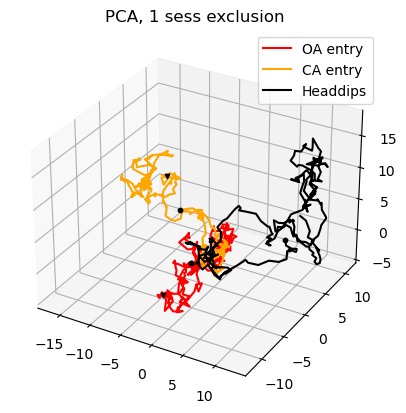

(568, 568)
(568, 786)


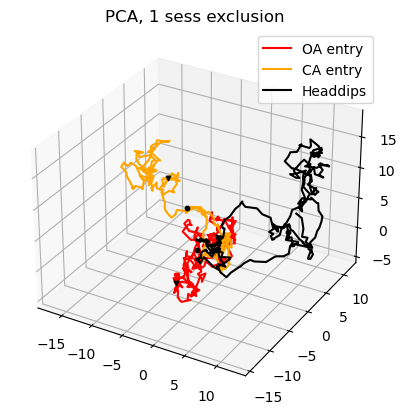

(536, 536)
(536, 786)


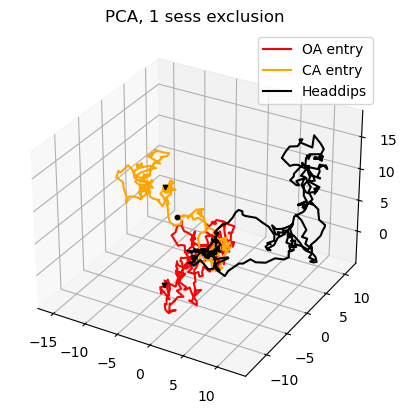

(562, 562)
(562, 786)


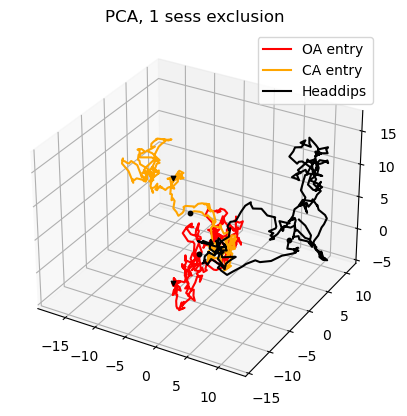

In [44]:
%matplotlib inline
ignoresessions = []
def project_excludeonemouse(bigarr, bigarr_excludeonemouse,unitspermouse_cumsum, finalunits_entryexit, type_trial="real"):
    # Li type analysis :
    vectorsTrials = [None]*5 # for each trial type
    l_traj_stats = []
    l_traj_5trials_newPCAfunct, var_5trials_newPCAfunct ,pc_original_newPCAfunct,eigvec, eigval = PCA_statstests.PCA_analysis(l_data_PCA=bigarr)

    for i in range(len(bigarr_excludeonemouse)):
        deleteeigenvalsvecs =np.arange(unitspermouse_cumsum[i],unitspermouse_cumsum[i+1])#np.arange(eigvec.shape[0]-(-unitspermouse_cumsum[i]+unitspermouse_cumsum[i+1]),eigvec.shape[0]) #
        eigvec_copy = np.copy(eigvec)
        eigenval_copy = np.copy(eigval)
        eigenvec_stats =np.delete(eigvec_copy, deleteeigenvalsvecs, axis=0) #eigvec_copy[:eigvec.shape[0]-(-unitspermouse_cumsum[i]+unitspermouse_cumsum[i+1]),:eigvec.shape[0]-(-unitspermouse_cumsum[i]+unitspermouse_cumsum[i+1])]#np.delete(eigvec_copy, deleteeigenvalsvecs, axis=0)
        #print(eigenvec_stats.shape)
        #eigenvec_stats = # np.delete(eigenvec_stats, deleteeigenvalsvecs, axis=1)
        eigval_stats = np.delete(eigenval_copy, deleteeigenvalsvecs)
        idx_argsorteigval = np.argsort(eigval_stats)[::-1]
        eigenvec_stats = eigenvec_stats[:,idx_argsorteigval]
        print(eigenvec_stats.shape)
        print(bigarr_excludeonemouse[i].shape)
        l_traj_bigsinglesess = PCA_statstests.projectdata(data_mat=bigarr_excludeonemouse[i], PC=eigenvec_stats)[:,:] #PCA_analysis(bigarr_excludeonemouse[i]) #PCA_analysis(bigarr_onlyone[i])[0] #
        l_traj_stats.append(l_traj_bigsinglesess)

        c=0
        len_trial = (finalunits_entryexit[0].shape[1]) # time
        c1 = len_trial # 121
        colours = ['red', 'green', 'orange', 'blue', "black"]
        leg = ["OA entry", "OA exit", "CA entry", "CA exit", "Headdips"]

        #fig = plt.figure(figsize=(15,15))
        ax = plt.axes(projection='3d')

        for k in range(len(finalunits_entryexit)):
            sig = 3
            #print(c)
            if k == 1 or k == 3:
                continue
            
            x =l_traj_stats[i][c:c1,0] #gaussian_filter1d(l_traj_stats[i][c:c1,0], sigma=sig)
            y =l_traj_stats[i][c:c1,1] #gaussian_filter1d(l_traj_stats[i][c:c1,1], sigma=sig)
            z =l_traj_stats[i][c:c1,2] #gaussian_filter1d(l_traj_stats[i][c:c1,2], sigma=sig)
            mid = int(x.size/2)
            plt.plot(x,y,z, label = leg[k], c = colours[k])
            ax.scatter3D(x[0], y[0], z[0], c='k',s=10,marker="o")
            ax.scatter3D(x[mid], y[mid], z[mid], c='k',s=10,marker="v")
            #ax.set_xlim([-7,7])
            #ax.set_ylim([-7,7])
            #ax.set_zlim([-7,7])
            c=c1
            c1 += len_trial

        plt.legend()
        plt.title('PCA, 1 sess exclusion')
        plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Stats_PCA_figures/PCA_allmice_allunits_EPM_definedtrials_entryexit_'+str(i)+type_trial+'.svg')
        plt.show()
    return l_traj_stats,eigvec, eigval

unitspermouse, unitspermouse_cumsum, bigarr_excludeonemouse=PCA_statstests.unitspermouse_excludeonesessgenerator(l_data, ignoreunits,excludetrials,ignoresessions, allmice_dividedtrials, allmice_neural_avgtrials_zscored)
l_traj_stats, eigvec, eigval = project_excludeonemouse(bigarr, bigarr_excludeonemouse,unitspermouse_cumsum, finalunits_entryexit)


Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)
Dimension of projected data:
(786, 100)


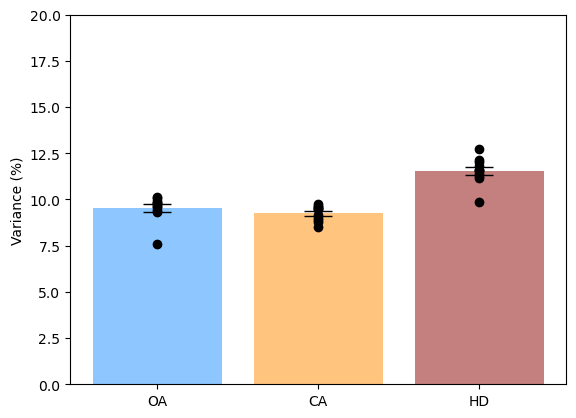

In [45]:
#variance explained by each event type 

oa_entry = []
ca_entry = []
hd = []

for i in range(len(bigarr_excludeonemouse)):
    traj , eigval_normalised_sh , PC = PCA_preprocessing.PCA_analysis(l_data_PCA=bigarr_excludeonemouse[i], k = 100)


    projected_oa = PCA_preprocessing.projectdata(PC, bigarr_excludeonemouse[i][:,:262])
    projected_ca = PCA_preprocessing.projectdata(PC, bigarr_excludeonemouse[i][:,262:524])
    projected_headdips = PCA_preprocessing.projectdata(PC, bigarr_excludeonemouse[i][:,524:])

    variance_oa = np.var(projected_oa, axis=0)
    variance_ca = np.var(projected_ca, axis=0)
    variance_headdips = np.var(projected_headdips, axis=0)

    explained_variance_ratio_oa = variance_oa / np.sum(variance_oa )
    explained_variance_ratio_ca = variance_ca / np.sum(variance_ca)
    explained_variance_ratio_headdips = variance_headdips / np.sum(variance_headdips)

    # explained_variance_ratio_oa = explained_variance_ratio_oa / SUM 
    # explained_variance_ratio_ca = explained_variance_ratio_ca / SUM 
    # explained_variance_ratio_headdips = explained_variance_ratio_headdips / SUM 

    

    # print( explained_variance_ratio_oa)
    # print(np.sum(explained_variance_ratio_oa))


    x = explained_variance_ratio_oa[0]*100 +explained_variance_ratio_oa[1] *100+ explained_variance_ratio_oa[2]*100 
    y = explained_variance_ratio_ca [0] * 100 +explained_variance_ratio_ca [1] * 100 + explained_variance_ratio_ca[2] * 100 
    z =  explained_variance_ratio_headdips [0] * 100 +explained_variance_ratio_headdips [1]*100 + explained_variance_ratio_headdips[2]*100 
    # print(x,y,z)

     
  
    oa_entry.append(x)
    ca_entry.append(y)
    hd.append(z)


    # Calculate mean and SEM for the accumulated data
mean_oa = np.mean(oa_entry)
mean_ca = np.mean(ca_entry)
mean_headdips = np.mean(hd)

sem_oa = sem(oa_entry)
sem_ca = sem(ca_entry)
sem_headdips = sem(hd)

# Plotting
means = [mean_oa,mean_ca,mean_headdips]
error = [sem_oa, sem_ca,sem_headdips]
colours = ['dodgerblue', 'darkorange', 'darkred']
xlabels = ["OA", "CA", "HD"]
x_pos = np.arange(len(xlabels))

plt.bar(x=x_pos, height=means, yerr=error, align='center', alpha=0.5, ecolor='black', capsize=10, color=colours)
plt.xticks(x_pos, xlabels)
plt.ylabel('Variance (%)')
plt.ylim([0, 20])

# Scatter plot of individual variances
plt.scatter(np.zeros(len(oa_entry)), oa_entry, c='k')
plt.scatter(np.ones(len(ca_entry)), ca_entry, c='k')
plt.scatter(np.full(len(hd),2),hd, c = 'k')

plt.show()


pca_stats_EPM= pd.DataFrame({"Open Arm": oa_entry, "closed Arm": ca_entry, "Headdips":hd})
filename = "RESULTS/NOT-INJECTED/PCA_stats_EPM_not_injected_sum3PCs_REAL.xlsx"


pca_stats_EPM.to_excel(filename)


Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)
Dimension of projected data:
(786, 3)


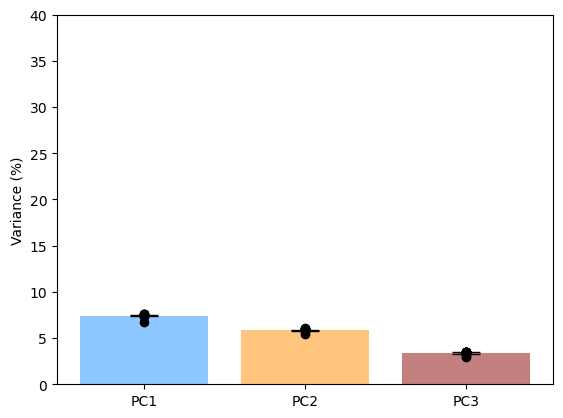

In [46]:
variance_PC1 = []
variance_PC2 = []
variance_PC3 = []

for i in range(len(bigarr_excludeonemouse)):
    traj , eigval_normalised_sh , PC = PCA_preprocessing.PCA_analysis(l_data_PCA=bigarr_excludeonemouse[i])
    # projected_data_per_mouse.append(traj)
    variance_PC1.append(eigval_normalised_sh[0]*100)
    variance_PC2.append(eigval_normalised_sh[1]*100)
    variance_PC3.append(eigval_normalised_sh[2]*100)
    
meanPC1_saline = np.mean(variance_PC1)
meanPC2_saline = np.mean(variance_PC2)
meanPC3_saline = np.mean(variance_PC3)
semPC1_saline = sem(variance_PC1)
semPC2_saline = sem(variance_PC2)
semPC3_saline = sem(variance_PC3)
means_sh = [meanPC1_saline, meanPC2_saline,meanPC3_saline]
error_sh = [semPC1_saline, semPC2_saline,semPC3_saline]
colours = ['dodgerblue', 'darkorange','darkred']
xlabels = ["PC1", "PC2","PC3"]
x_pos = np.arange(len(xlabels))
plt.bar(x=x_pos, height=means_sh,yerr=error_sh, align='center', alpha=0.5, ecolor='black', capsize=10, color=colours)
plt.xticks(x_pos,xlabels)
plt.ylabel('Variance (%)')
plt.ylim([0,40])
plt.scatter(np.zeros(len(bigarr_excludeonemouse)), variance_PC1,c='k')
plt.scatter(np.ones(len(bigarr_excludeonemouse)), variance_PC2, c='k')
plt.scatter(np.full(len(bigarr_excludeonemouse),2), variance_PC3, c='k')
plt.savefig('RESULTS/NOT-INJECTED/PCA_EPM_variance_REAL.svg')
plt.show()

In [47]:
#store them in excel file 

pca_stats_epm = pd.DataFrame({"pc1": variance_PC1, "pc2": variance_PC2, "pc3":variance_PC3})
filename = "RESULTS/NOT-INJECTED/PCA_stats_variance_3PCs_EPM_ORIGINAL_real.xlsx"

pca_stats_epm.to_excel(filename)

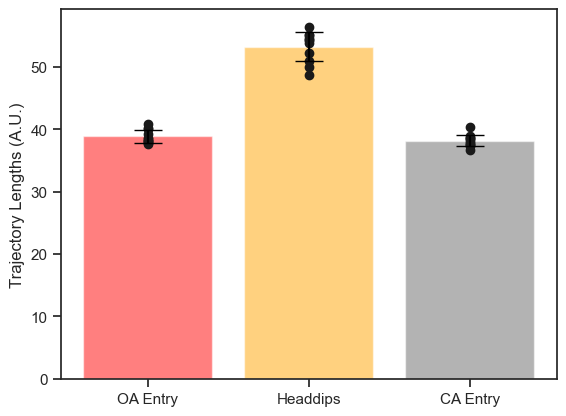

OA entry and headdips: 9.658630605723774e-14
OA entry and CA entry: 0.14412610243989077
CA entry and headdips: 3.0220523550176205e-14


In [ ]:
# t-test among pairs
# OA Entry and headdips
# stats from l_proj_5trials_1mouse: length of each traj
%matplotlib inline

from scipy.spatial.distance import mahalanobis
from scipy.stats import ttest_ind, f_oneway

metrics,_, origin = PCA_statstests.obtain_metrics(l_traj_stats=l_traj_stats, finalunits_entryexit=allmice_neural_avgtrials_zscored, unitspermouse=unitspermouse,pc_90perc=3, metric_type="length", mid_select=True)

plt.savefig("RESULTS/NOT-INJECTED/PCA_finalpictures/PCA_EPM_Definedtrials_entryexit_statistics_length_magnified.svg")
plt.show()

_,pval = ttest_ind(metrics[0][:,:1].squeeze(), metrics[-1][:,:1].squeeze())
print("OA entry and headdips: "+str(pval))
_,pval = ttest_ind(metrics[0][:,:1].squeeze(), metrics[1][:,:1].squeeze())
print("OA entry and CA entry: "+str(pval))
_,pval = ttest_ind(metrics[1][:,:1].squeeze(), metrics[-1][:,:1].squeeze())
print("CA entry and headdips: "+str(pval))

# Venn diagrams

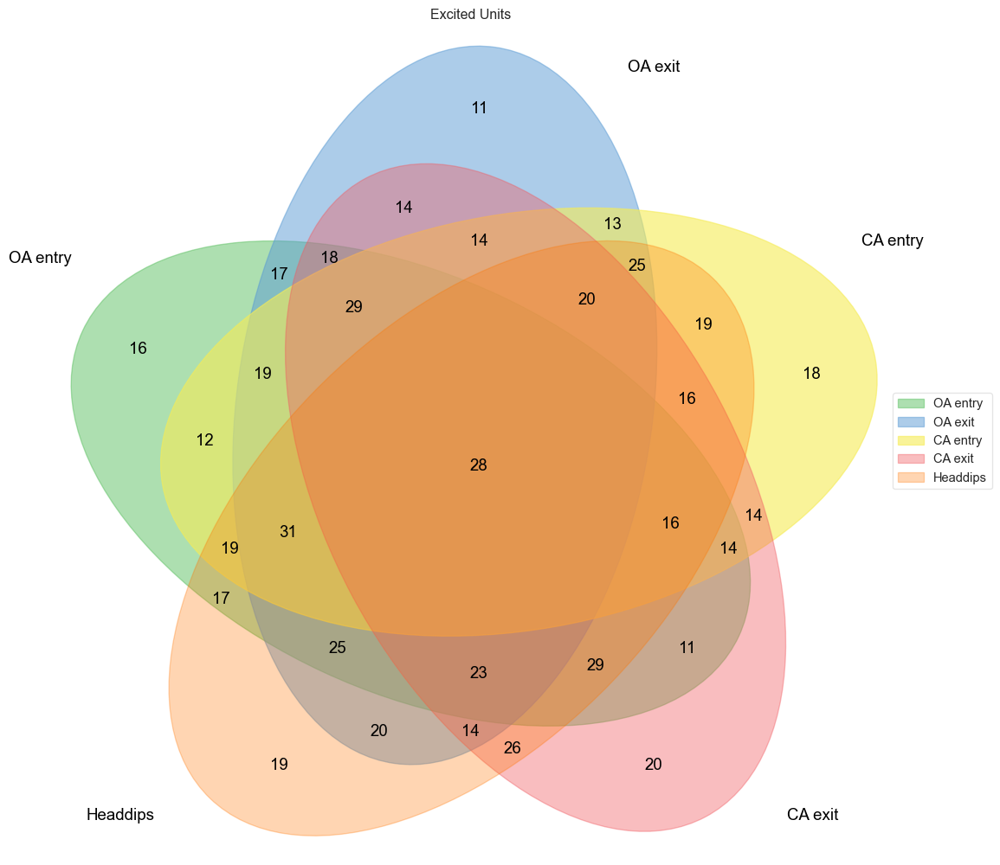

In [128]:
# VENN Diagrams
import venn
# ehm_idx, ihm_idx, rhm_idx -> 1 venn diagram (5 sets) per unittype

# make a dict of arrays

ehm_venndiag = {}
ehm_venndiag['0'] = ehm_idx[0]
ehm_venndiag['1'] = ehm_idx[1]
ehm_venndiag['2'] = ehm_idx[2]
ehm_venndiag['3'] = ehm_idx[3]
ehm_venndiag['4'] = ehm_idx[4]

labels=venn.get_labels([
            ehm_idx[0],ehm_idx[1],ehm_idx[2],ehm_idx[3],ehm_idx[4]
        ], fill=['number'])

fig, ax = venn.venn5(labels=labels, names=['OA entry', 'OA exit', 'CA entry', 'CA exit', 'Headdips'])
plt.title('Excited Units')
plt.show()

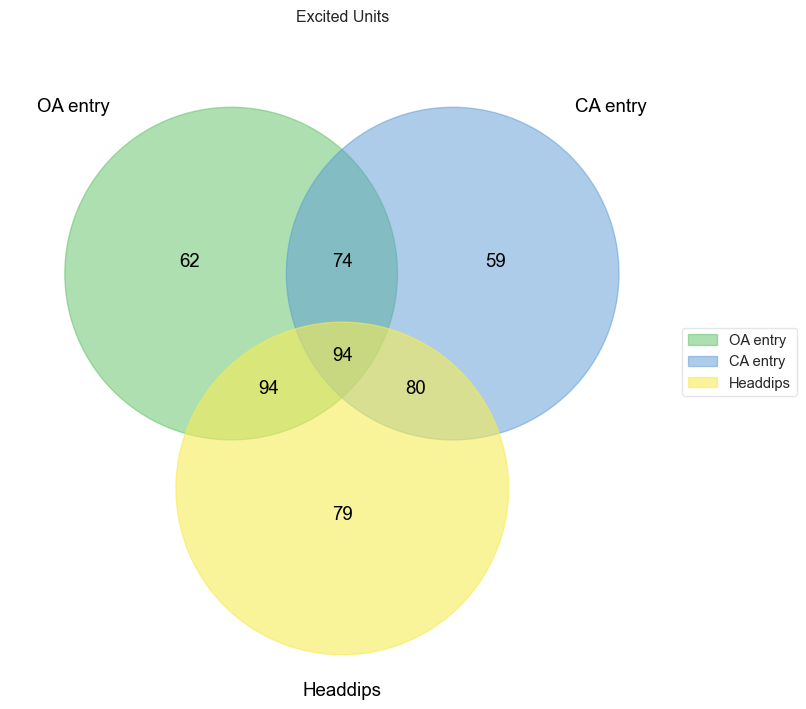

In [129]:
labels=venn.get_labels([
            ehm_idx[0],ehm_idx[2],ehm_idx[4]
        ], fill=['number'])

fig, ax = venn.venn3(labels=labels, names=['OA entry', 'CA entry', 'Headdips'])
plt.title('Excited Units')
plt.show()

295


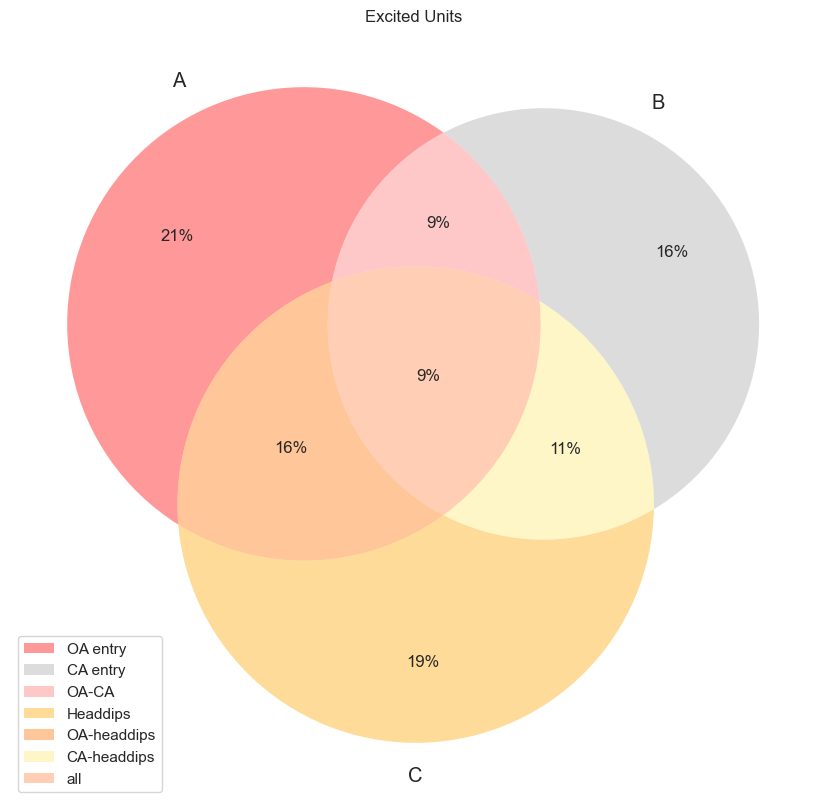

In [ ]:
import matplotlib_venn
%matplotlib inline
fig = plt.figure(figsize=(15,10))
total = np.sum(np.array((61, 47, 26, 56,46,33,26)))
print(total)
matplotlib_venn.venn3(subsets = (61, 47, 26, 56,46,33,26),set_colors=['red', 'darkgrey', 'orange'], subset_label_formatter=lambda x: f"{(x/total):1.0%}")

plt.legend(['OA entry', 'CA entry','OA-CA', 'Headdips','OA-headdips','CA-headdips','all'])
plt.title('Excited Units')
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Venn/ExcitedUnits.svg')
plt.show()

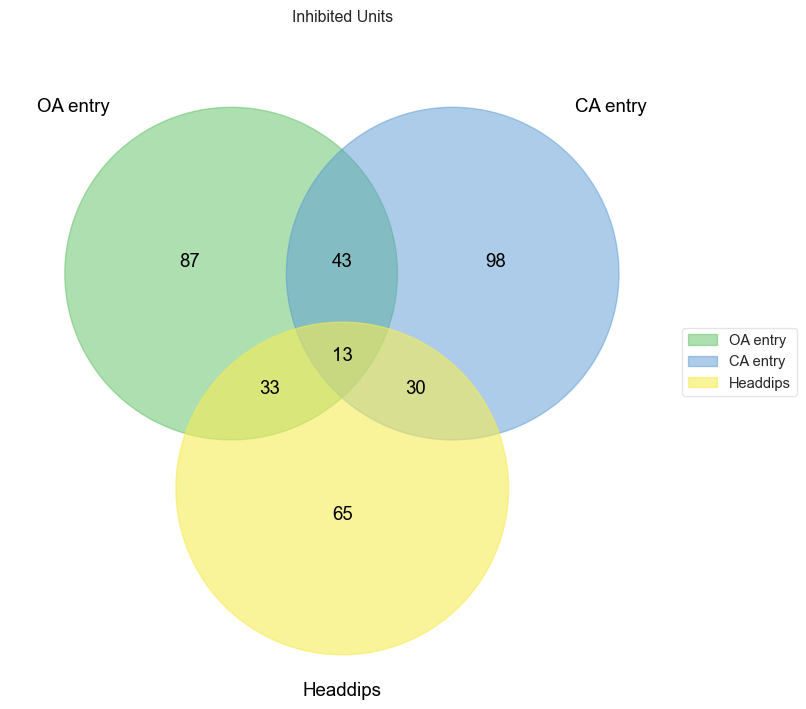

In [131]:
labels=venn.get_labels([
            ihm_idx[0],ihm_idx[2],ihm_idx[4]
        ], fill=['number'])

fig, ax = venn.venn3(labels=labels, names=['OA entry', 'CA entry', 'Headdips'])
plt.title('Inhibited Units')
plt.show()

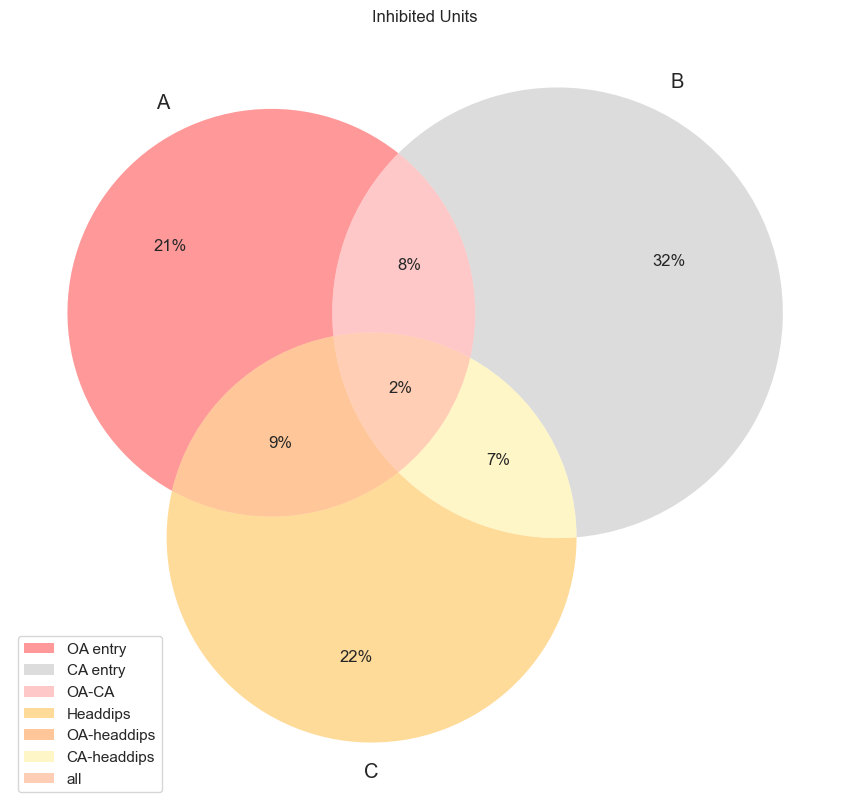

In [ ]:
fig = plt.figure(figsize=(15,10))
total = np.sum(np.array((50, 76, 18, 52,22,17,5)))
matplotlib_venn.venn3(subsets = (50, 76, 18, 52,22,17,5),set_colors=['red', 'darkgrey', 'orange'], subset_label_formatter=lambda x: f"{(x/total):1.0%}")
                      
plt.legend(['OA entry', 'CA entry','OA-CA', 'Headdips','OA-headdips','CA-headdips','all'])
plt.title('Inhibited Units')
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Venn/InhibitedUnits.svg')
plt.show()

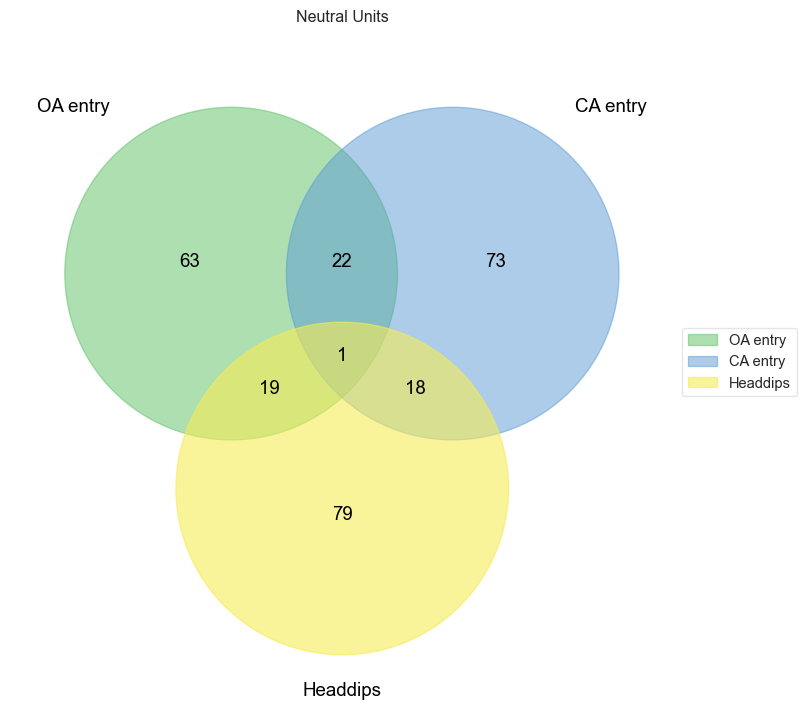

In [133]:
labels=venn.get_labels([
            rhm_idx[0],rhm_idx[2],rhm_idx[4]
        ], fill=['number'])

fig, ax = venn.venn3(labels=labels, names=['OA entry', 'CA entry', 'Headdips'])
plt.title('Neutral Units')
plt.show()

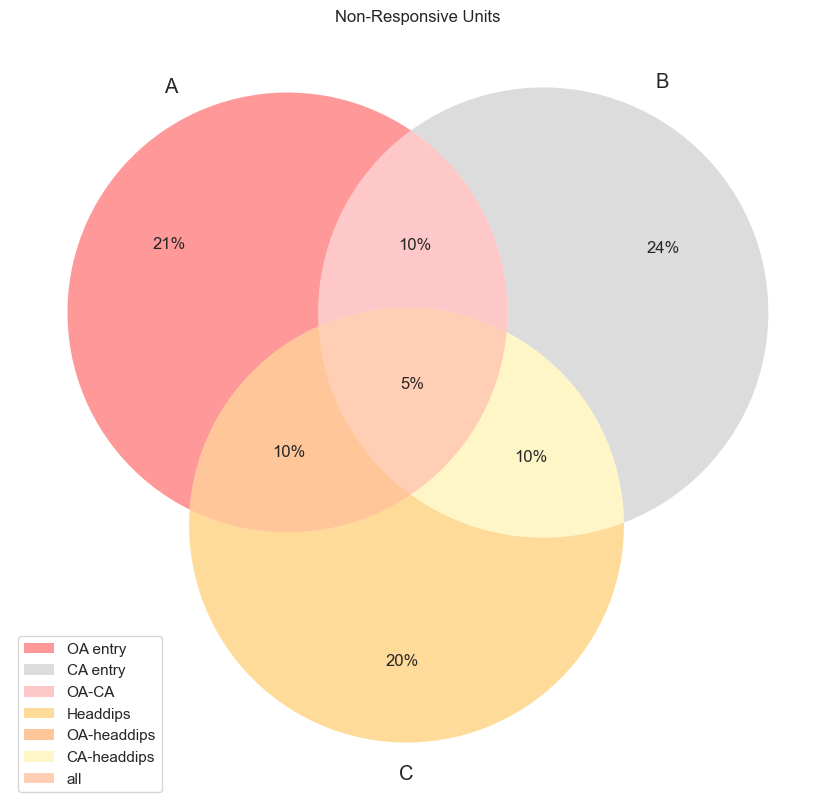

In [ ]:
fig = plt.figure(figsize=(15,10))
total = np.sum(np.array((60, 67,27, 57,28,27,14)))
matplotlib_venn.venn3(subsets = (60, 67,27, 57,28,27,14),set_colors=['red', 'darkgrey', 'orange'], subset_label_formatter=lambda x: f"{(x/total):1.0%}")

plt.legend(['OA entry', 'CA entry','OA-CA', 'Headdips','OA-headdips','CA-headdips', 'all'])
plt.title('Non-Responsive Units')
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Venn/NonResponsiveUnits.svg')
plt.show()

# Unit Number Tree

In [54]:
# exc_oa = len(ehm_idx[0])
# inh_ca = 
# nonresp_overall = 
# ehm_idx
idx_consider = np.array([0,2,4])
commonunits_all = np.zeros((3,3,3))
commonunits_all_idx = []
allunits = [ehm_idx,ihm_idx, rhm_idx]
label = []
trialtype =["OA", "CA", "HD"]
unittypestr = ["e", "i", "n"]
# oa, ca, hd
# oa, ca, hd
# ehm ihm rhm 

for i in range(3):
    for j in range(3):
        # commonunits_all[i,j,0] = len(np.intersect1d(ehm_idx[i], ehm_idx[j]))
        for k in range(3):
            x = np.intersect1d(allunits[i][0], allunits[j][4])
            commonunits_all[i,j,k] = len(np.intersect1d(x, allunits[k][2]))*100/695#len(np.union1d(allunits[i][0], allunits[i][2], allunits[i][1]))
            commonunits_all_idx.append(np.intersect1d(x, allunits[k][2]))
            label.append(trialtype[0]+unittypestr[i]+"/"+trialtype[1]+unittypestr[j]+"/"+trialtype[2]+unittypestr[k])

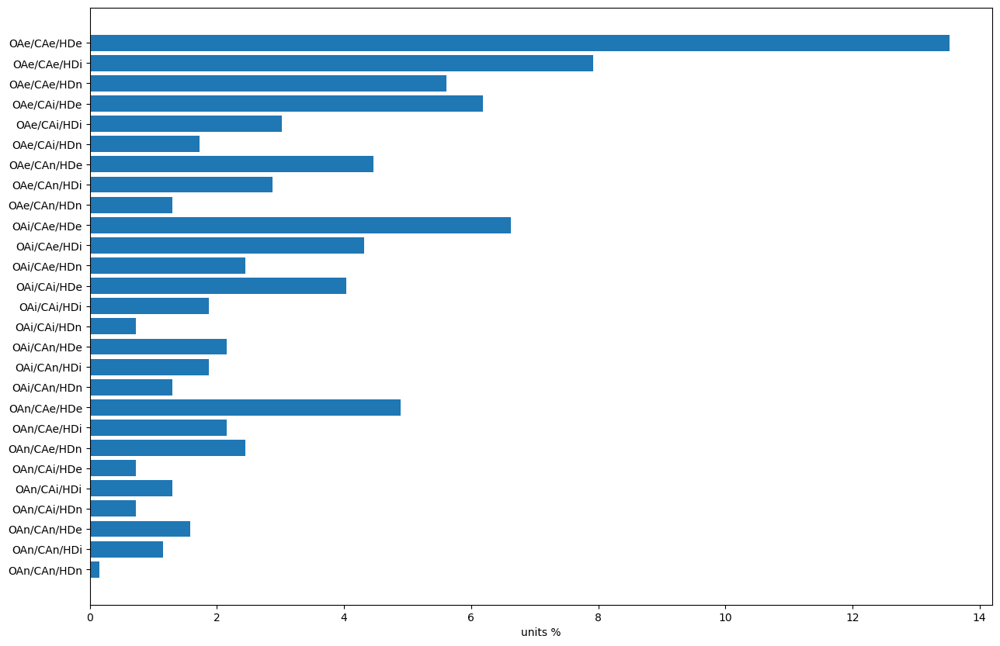

In [55]:
plt.figure(figsize=(15,10))
plt.barh(y=np.flip(np.array(label)), width=np.flip(commonunits_all.flatten()))
plt.xlabel("units %")
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/UnitTypePercTree_20240707.svg')
plt.show()

In [58]:
Units_EPM_Classification = pd.DataFrame({'labels': label, 
                                'unitperc':commonunits_all.flatten()})


Units_EPM_Classification.to_excel("RESULTS/NOT-INJECTED/Units_EPM_Classification_modified_20240707.xlsx")

605


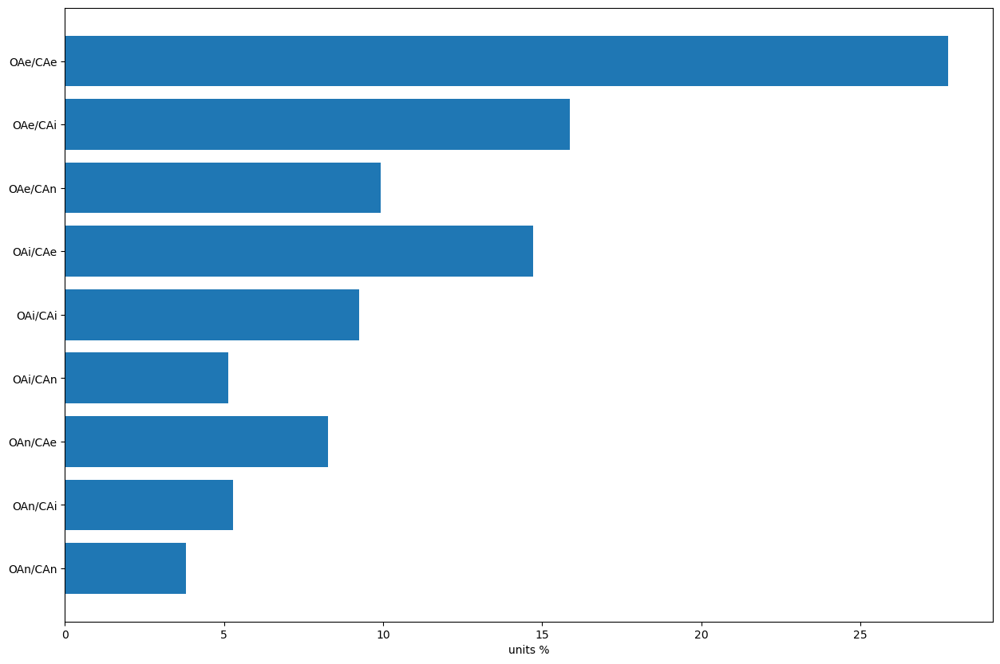

In [59]:
# exc_oa = len(ehm_idx[0])
# inh_ca = 
# nonresp_overall = 
# ehm_idx
idx_consider = np.array([0,2])
commonunits_all = np.zeros((3,3))

allunits = [ehm_idx,ihm_idx, rhm_idx]
label = []
trialtype =["OA", "CA"]
unittypestr = ["e", "i", "n"]
# oa, ca, hd
# oa, ca, hd
# ehm ihm rhm

# overlap pop 
x1 = np.union1d(allunits[0][0], allunits[0][2])
x2 = np.union1d(allunits[1][0], x1)
x3 = np.union1d(allunits[1][2], x2)
x4 = np.union1d(allunits[2][0], x3)
x5 = np.union1d(allunits[2][2], x4)
oaca_unitnum = len(x5)
print(oaca_unitnum)

for i in range(3):
    for j in range(3):
        x = np.intersect1d(allunits[i][0], allunits[j][2])
        commonunits_all[i,j] = len(x)*100/oaca_unitnum #len(np.union1d(allunits[i][0], allunits[i][2]))
        label.append(trialtype[0]+unittypestr[i]+"/"+trialtype[1]+unittypestr[j])

plt.figure(figsize=(15,10))
plt.barh(y=np.flip(np.array(label)), width=np.flip(commonunits_all.flatten()))
plt.xlabel("units %")
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/UnitTypePercTree_OACA2.svg')
plt.show()

In [61]:
Units_EPM_Classification_OA_CA = pd.DataFrame({'labels': label, 
                                'unitperc':commonunits_all.flatten()})


Units_EPM_Classification_OA_CA.to_excel("RESULTS/NOT-INJECTED/Units_EPM_Classification_OA_CA_modified2.xlsx")

# shuffle

In [420]:
def binshuffle_250ms_allunits(l_data):
    np.random.seed(42)
    l_data_new = [None]*len(l_data)
    for i in range(len(l_data)):
        l_data_new[i]=np.zeros(l_data[i].shape)
        for j in range(l_data[i].shape[0]):
            l_data_new[i][j,:] = np.sum(np.array(l_data[i][j:j+5,:]), axis=0)
    
    l_data_sh = []
    for i in range(len(l_data)):
        neural = np.array(l_data_new[i])
        summ = np.sum(neural)
        timep = l_data_new[i].shape[0]
        freq = 30000
        #t_ignore = int(30*0.05*30000)
        timeb_total = int(timep*freq*0.025) #- t_ignore
        y = np.zeros((timeb_total, neural.shape[-1]))
        for i in range(neural.shape[-1]):
            summ = np.sum(neural[:,i])
            t = (timeb_total)
            y[:,i] = np.random.binomial(n=1, p=summ/t, size=(timeb_total))
        new= np.zeros((neural.shape[0]-30+1, neural.shape[-1]))
        c=int(30000*0.025)
        print(new.shape)
        for i in range(new.shape[0]):
            new[i,:] =np.sum(y[i*c:(i+1)*c,:], axis=0)
        l_data_sh.append(new)

    return l_data_sh

In [62]:
# l_data_sh = binshuffle_15min(l_data)
# l_data_sh_allunits = binshuffle_15min_allsh(l_data) # somehow worse?

# l_data_250ms_sh_allunits = binshuffle_250ms_allunits(l_data_25)

# # np.savez("shuffled_l_data_new.npz",l_data_250ms_sh_allunits=l_data_250ms_sh_allunits)

# # # SAVE IT IN A PICKLE FILE !
# with open("RESULTS/NOT-INJECTED/l_data_shuffle_250ms_25msbin.pkl", 'wb') as f:
#    pickle.dump(l_data_250ms_sh_allunits, f)

with open("RESULTS/NOT-INJECTED/l_data_shuffle_250ms_25msbin.pkl", 'rb') as f:
    l_data_250ms_sh_allunits=pickle.load(f)

# with np.load("mouseDataNew/shuffled_l_data.npz", allow_pickle=True) as f:
# #     l_data_sh = f["l_data_sh"]
#      l_data_sh_allunits = f["l_data_sh_allunits"]

100
trials retained: 97.41697416974169
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(

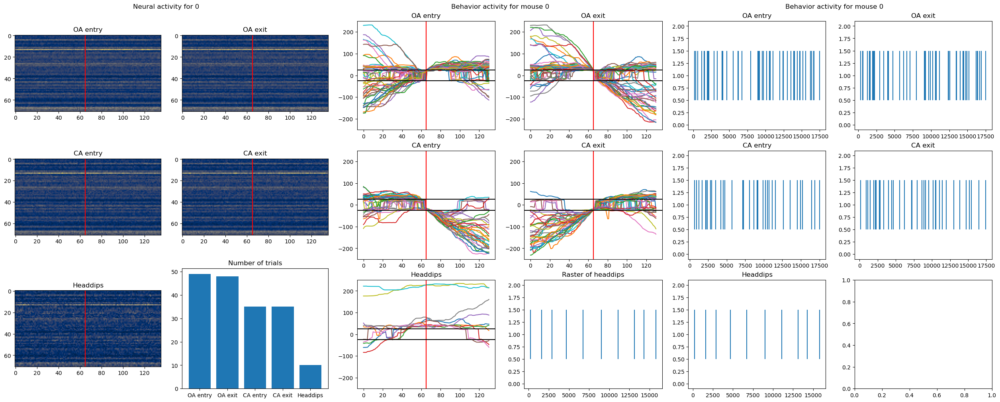

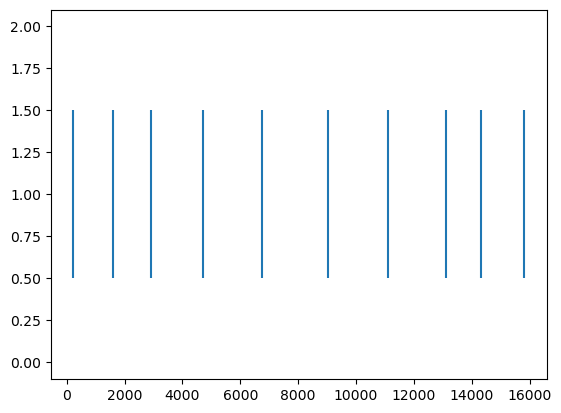

0
trials retained: 92.23300970873787
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(272, 52)
(27

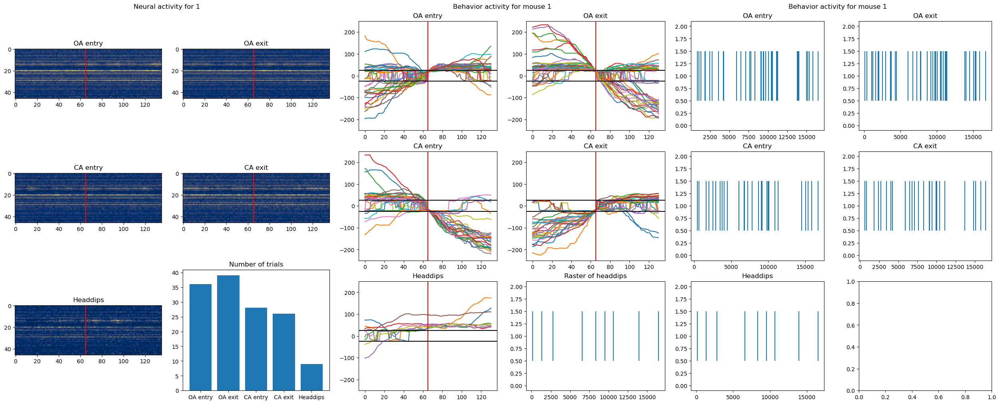

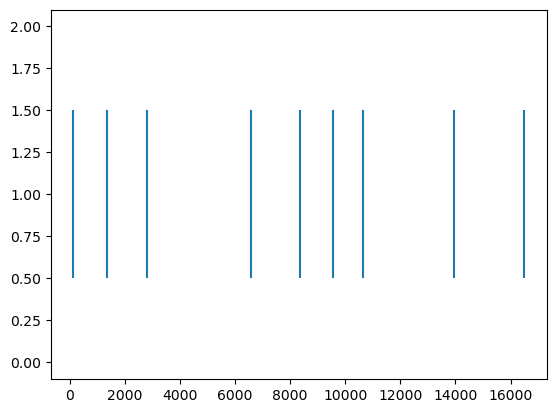

0
trials retained: 88.65546218487395
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(272, 77)
(27

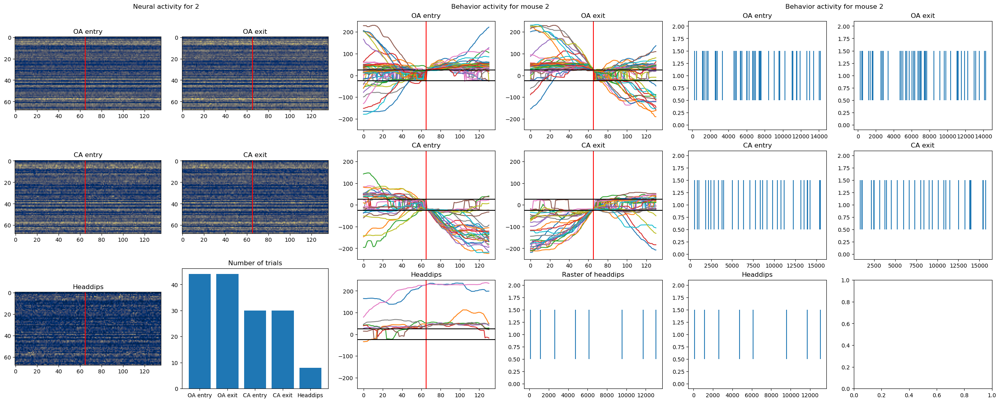

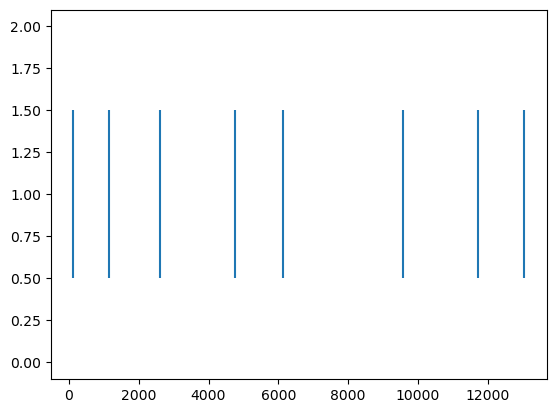

0
trials retained: 92.43027888446215
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(272, 81)
(27

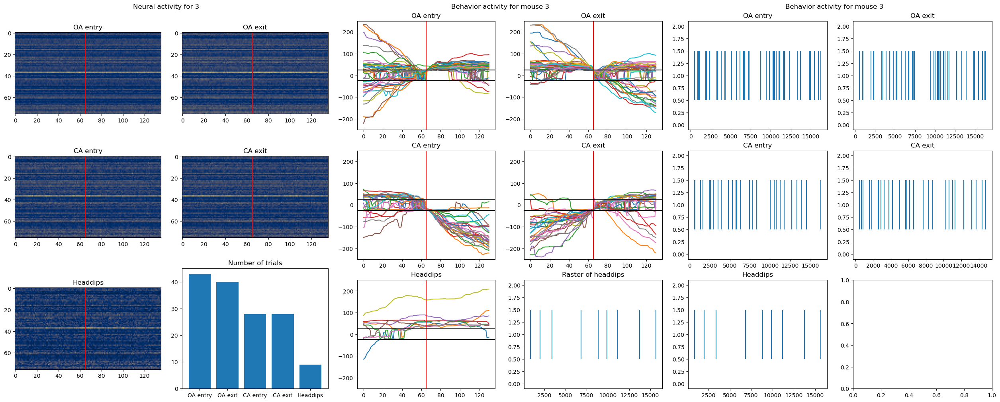

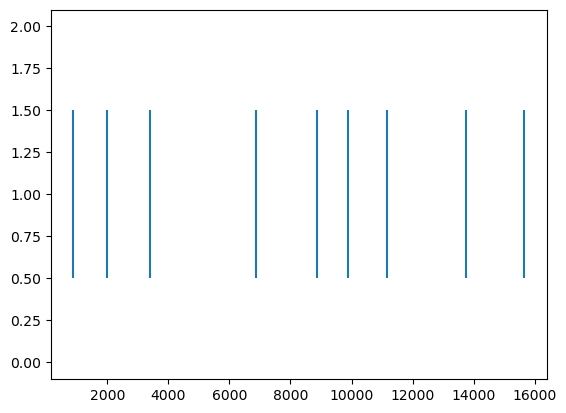

0
trials retained: 96.67590027700831
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(272, 80)
(27

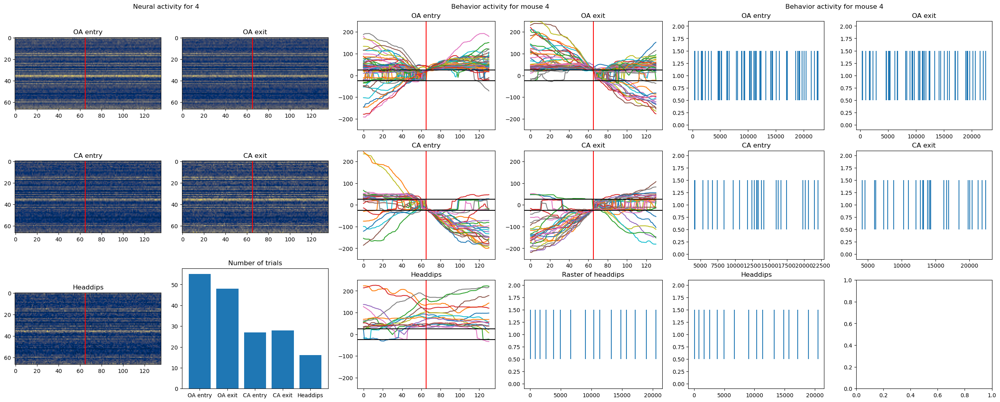

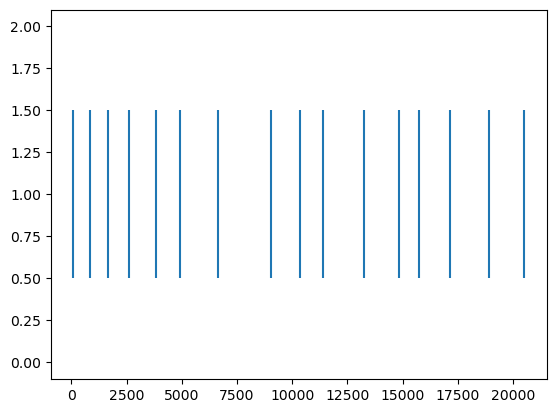

0
trials retained: 91.53846153846153
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(272, 67)
(27

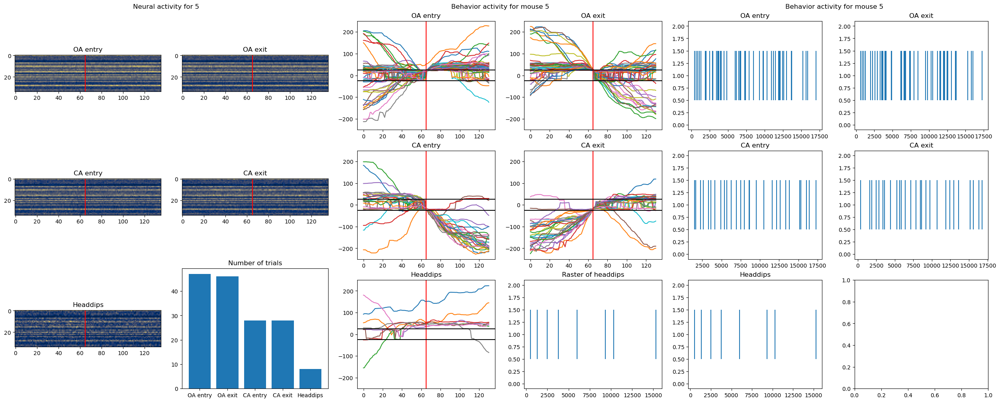

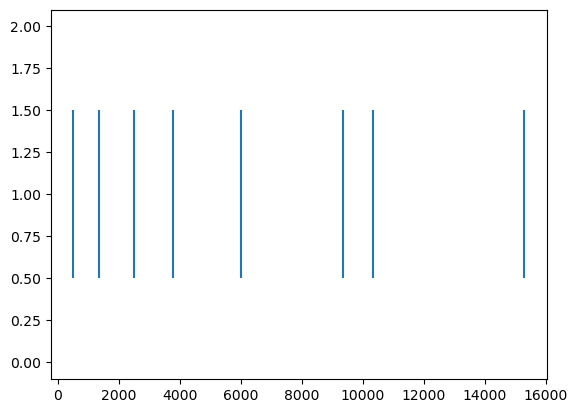

0
trials retained: 99.65034965034965
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(272, 57)
(27

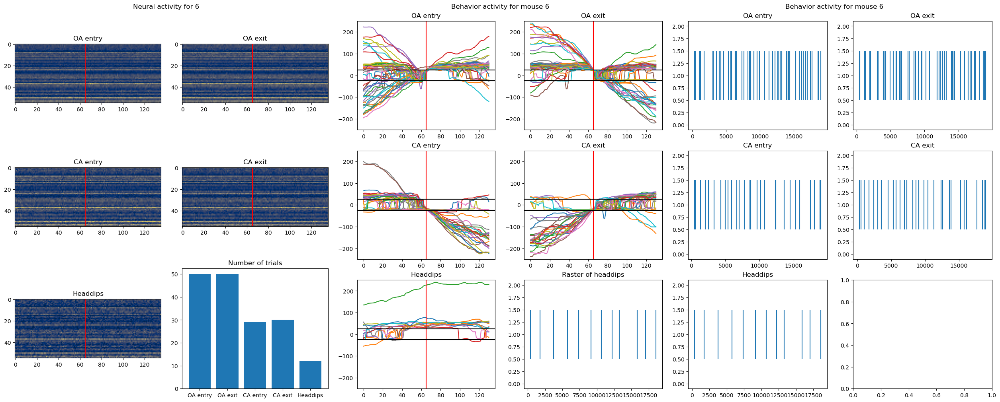

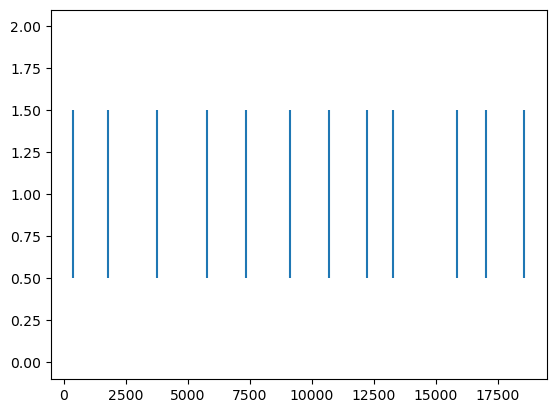

0
trials retained: 100.0
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272, 44)
(272,

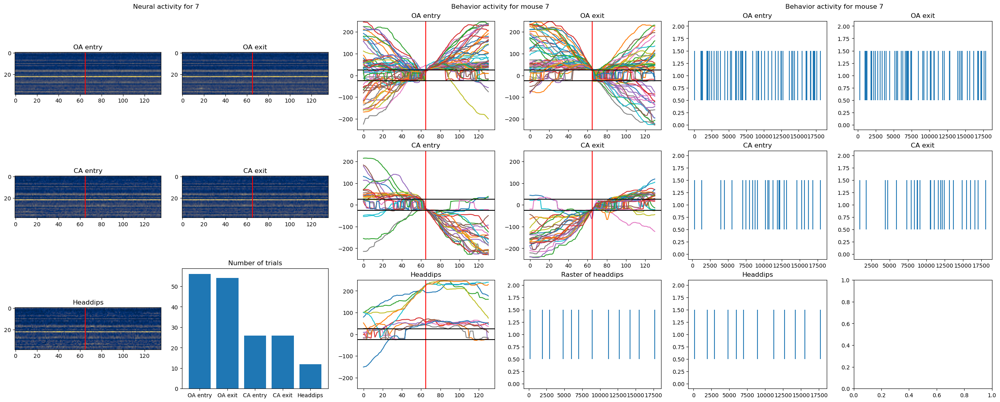

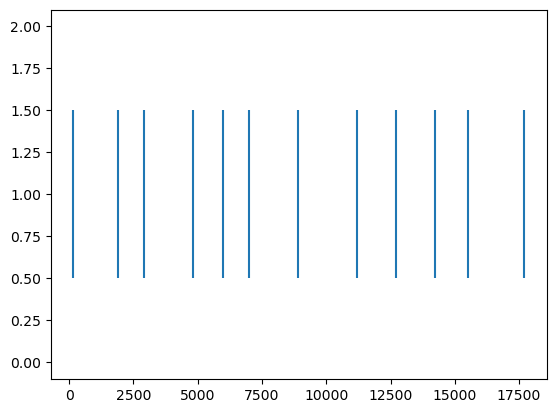

0
trials retained: 98.24561403508773
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(272, 41)
(27

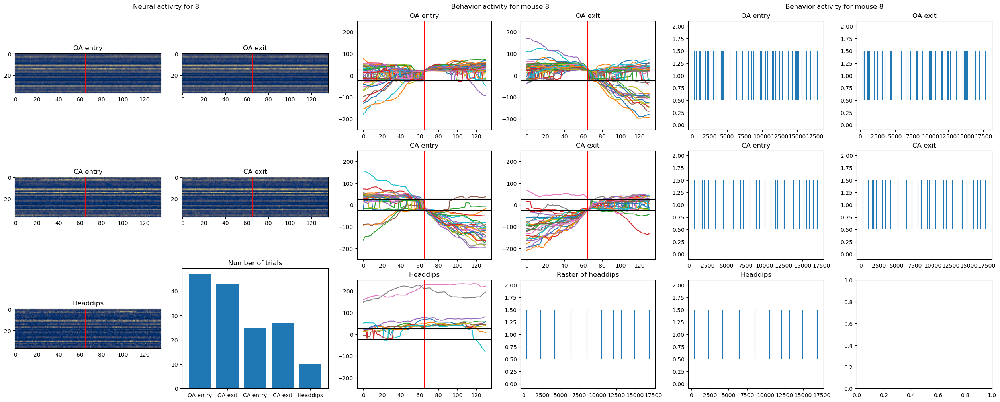

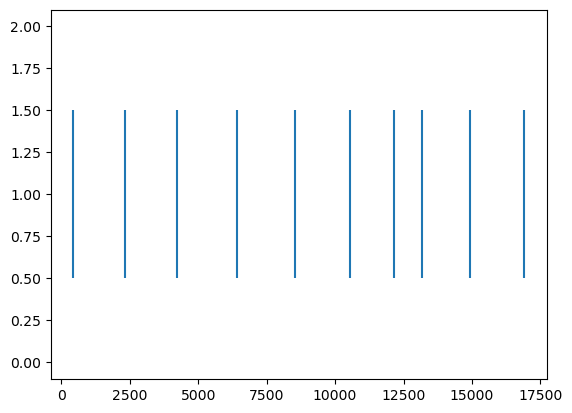

0
trials retained: 99.22178988326849
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(272, 72)
(27

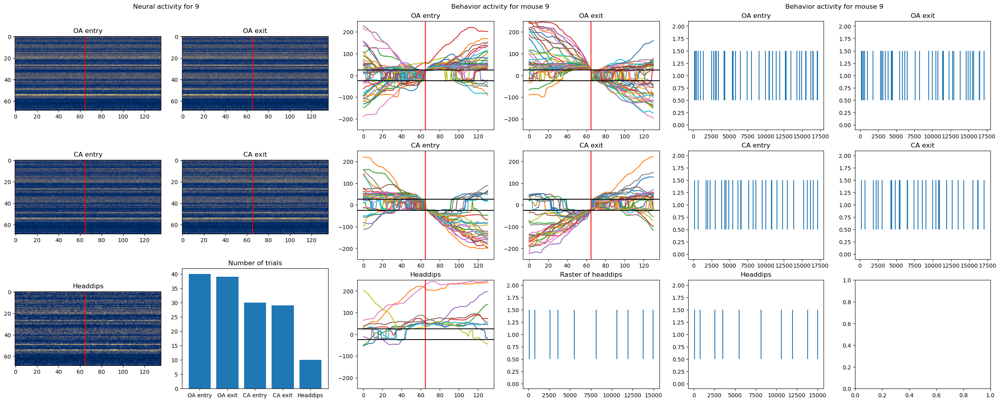

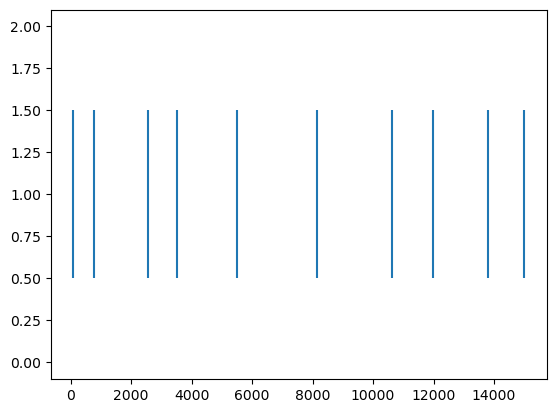

0
trials retained: 97.61904761904762
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(272, 50)
(27

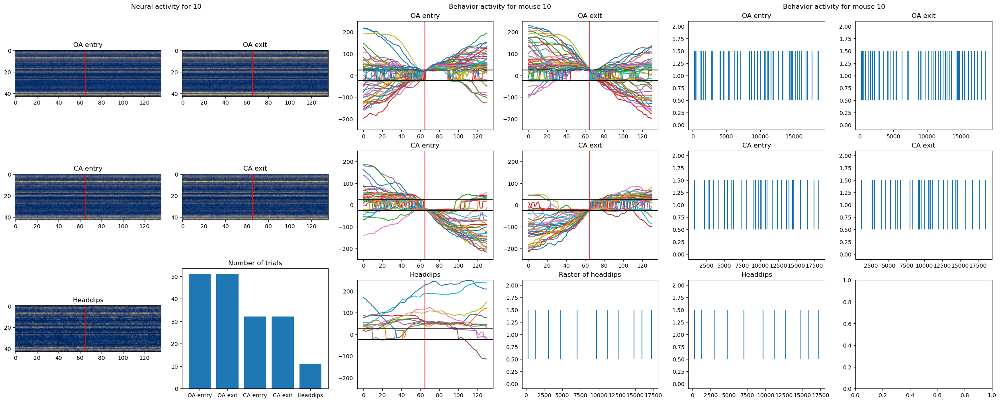

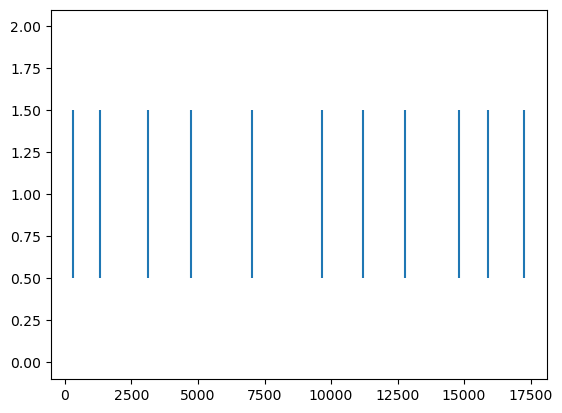

0
(702,)


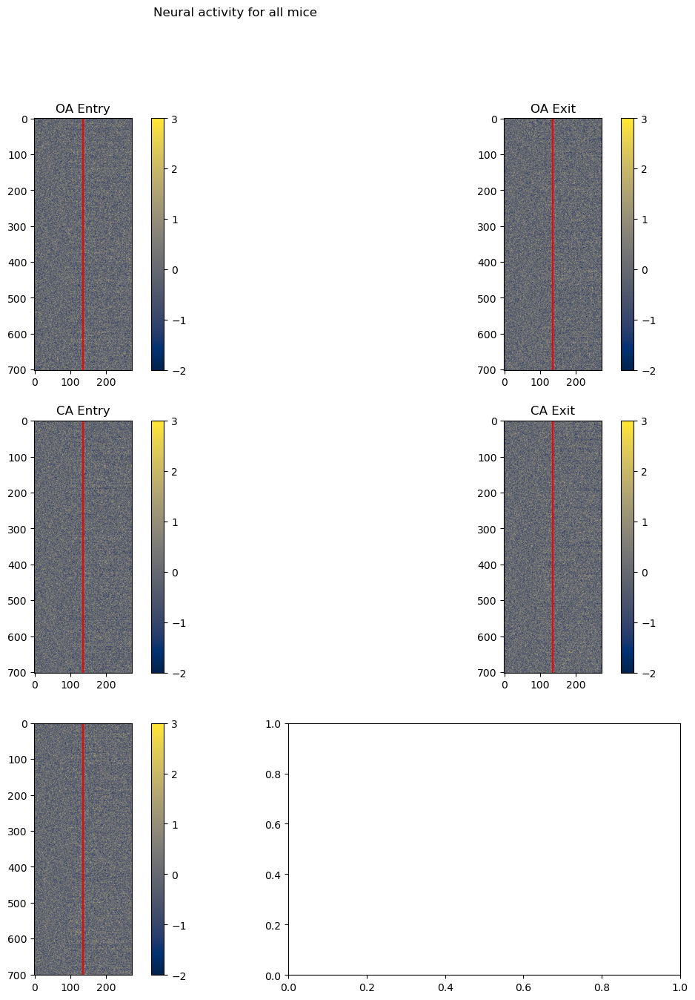

Dimension of projected data:
(1098, 3)


In [63]:
# generate random sh data now 
%matplotlib inline
notignoredsess = [0,1,2,3,4,5,6,7,8,9,10,11,12]
l_proj_5trials_sh, allmice_neural_avgtrials_sh_zscored, allmice_dividedtrials_sh, bigarr_sh, ignoreunits_sh, variance_sh = PCA_statstests.newshufflepcagenerateperdataset(100, l_mouse_name,finalunits_entryexit,allmice_dividedtrials,allmice_dividedtrials_beh,l_data, l_data_250ms_sh_allunits, l_beh_lowdim_cont,notignoredsessions = [0,1,2,3,4,5,6,7,8,9,10])

0
262
262
524
524


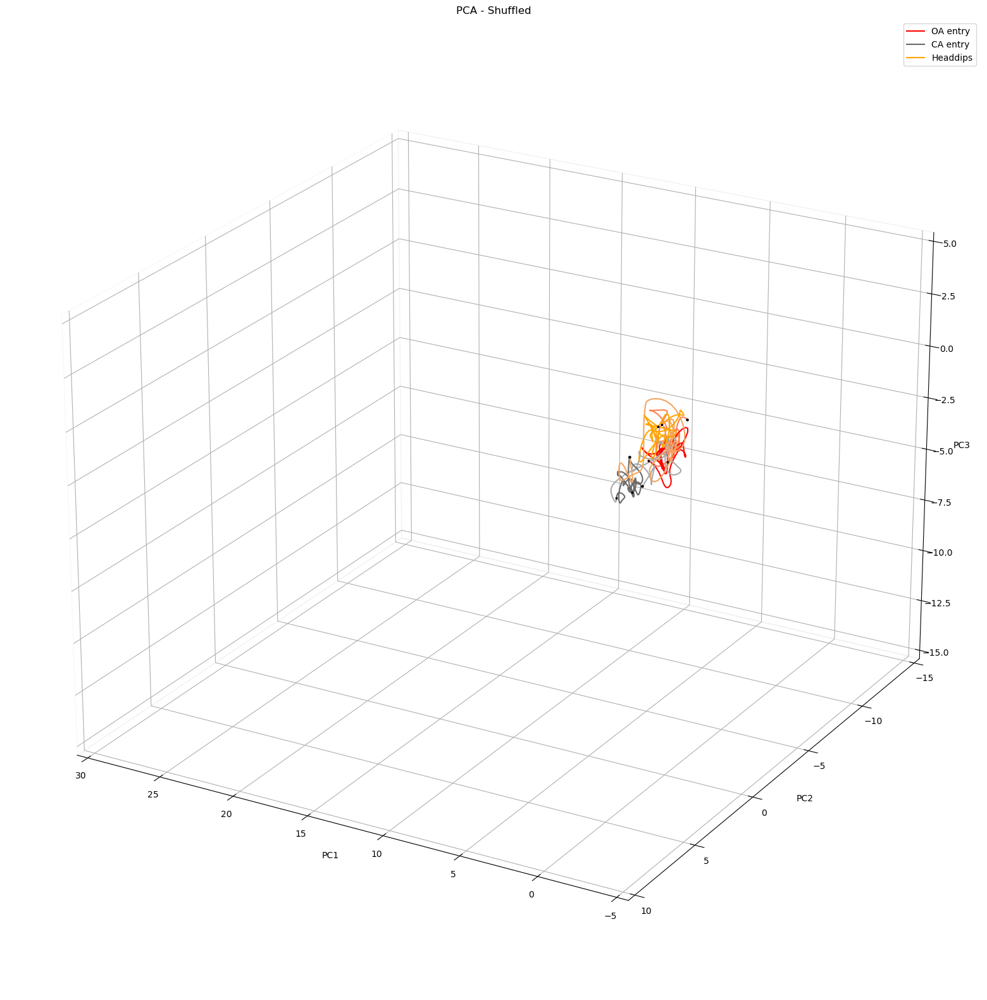

In [ ]:
c=0
%matplotlib inline
len_trial = (finalunits_entryexit[0].shape[1]) # time
c1 = len_trial # 121
colours = ['red', 'lightcoral', 'dimgrey', 'darkgrey', 'orange'] #['red', 'orange','green', 'blue', "black"]
leg = ["OA entry", "OA exit", "CA entry", "CA exit", "Headdips"]

fig = plt.figure(figsize=(20,20),facecolor='white')
ax = plt.axes(projection='3d')

ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

for i in range(len(finalunits_entryexit)):
    sig = 3
    print(c)
    if i == 1 or i == 3:
        # c=c1
        # c1=c1+len_trial

        continue
    
    x = gaussian_filter1d(l_proj_5trials_sh[c:c1,0], sigma=sig)
    y = gaussian_filter1d(l_proj_5trials_sh[c:c1,1], sigma=sig)
    z = gaussian_filter1d(l_proj_5trials_sh[c:c1,2], sigma=sig)
    mid = int(x.size/2)
    plt.plot(y[:mid+1],x[:mid+1],z[:mid+1], c = colours_lighter[i])
    plt.plot(y[mid:],x[mid:],z[mid:], label = leg[i], c = colours[i])
    ax.scatter3D( y[0],x[0], z[0], c='k',s=5,marker="o")
    ax.scatter3D( y[mid],x[mid], z[mid], c='k',s=5,marker="*")
    ax.scatter3D( y[-1],x[-1], z[-1], c='k',s=5,marker="*")
    ax.set_ylim([-15,10])
    ax.set_zlim([-15,5])
    ax.set_xlim([-5,30])
    # ax.set_ylim([-5,5])
    # ax.set_zlim([-5,5])
    # ax.set_xlim([-5,5])
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    ax.view_init(23, 120)
    #ax.set_facecolor('white')
    #ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
    c=c1
    c1 += len_trial

plt.legend()
plt.title('PCA - Shuffled')
# plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/PCA_allmice_allunits_EPM_definedtrials_sh_1dataset_20240707.svg') 
plt.show()

In [ ]:
c=0
%matplotlib qt
len_trial = (finalunits_entryexit[0].shape[1]) # time
c1 = len_trial # 121
colours = ['red', 'lightcoral', 'dimgrey', 'darkgrey', 'orange'] #['red', 'orange','green', 'blue', "black"]
leg = ["OA entry", "OA exit", "CA entry", "CA exit", "Headdips"]

fig = plt.figure(figsize=(10,10),facecolor='white')
ax = plt.axes(projection='3d')

ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False
for i in range(len(finalunits_entryexit)):
    sig = 3
    print(c)
    if i == 1 or i == 3:
        # c=c1
        # c1=c1+len_trial

        continue
    
    x = gaussian_filter1d(l_proj_5trials[c:c1,0], sigma=sig)
    y = gaussian_filter1d(l_proj_5trials[c:c1,1], sigma=sig)
    z = gaussian_filter1d(l_proj_5trials[c:c1,2], sigma=sig)
    mid = int(x.size/2)
    plt.plot(y[:mid+1],x[:mid+1],z[:mid+1], c = colours_lighter[i])
    plt.plot(y[mid:],x[mid:],z[mid:], label = leg[i], c = colours[i])
    ax.scatter3D( y[0],x[0], z[0], c='k',s=5,marker="o")
    ax.scatter3D( y[mid],x[mid], z[mid], c='k',s=5,marker="*")
    ax.scatter3D( y[-1],x[-1], z[-1], c='k',s=5,marker="*")
    # ax.set_ylim([-15,10])
    # ax.set_zlim([-15,5])
    # ax.set_xlim([-5,30])
    # ax.set_ylim([-5,5])
    # ax.set_zlim([-5,5])
    # ax.set_xlim([-5,5])
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    #ax.set_facecolor('white')
    #ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
    c=c1
    c1 += len_trial

c=0
c1 = len_trial

for i in range(len(finalunits_entryexit)):
    sig = 3
    print(c)
    if i == 1 or i == 3:
        # c=c1
        # c1=c1+len_trial

        continue
    
    x = gaussian_filter1d(l_proj_5trials_sh[c:c1,0], sigma=sig)
    y = gaussian_filter1d(l_proj_5trials_sh[c:c1,1], sigma=sig)
    z = gaussian_filter1d(l_proj_5trials_sh[c:c1,2], sigma=sig)
    mid = int(x.size/2)
    plt.plot(y[:mid+1],x[:mid+1],z[:mid+1], c = colours_lighter[i])
    plt.plot(y[mid:],x[mid:],z[mid:], label = leg[i], c = colours[i])
    ax.scatter3D( y[0],x[0], z[0], c='k',s=5,marker="o")
    ax.scatter3D( y[mid],x[mid], z[mid], c='k',s=5,marker="*")
    ax.scatter3D( y[-1],x[-1], z[-1], c='k',s=5,marker="*")
    # ax.set_ylim([-15,10])
    # ax.set_zlim([-15,5])
    # ax.set_xlim([-5,30])
    # ax.set_ylim([-5,5])
    # ax.set_zlim([-5,5])
    # ax.set_xlim([-5,5])
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    #ax.set_facecolor('white')
    #ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))
    c=c1
    c1 += len_trial

plt.legend()
plt.title('PCA - Shuffled')
# plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/PCA_allmice_allunits_EPM_definedtrials_together.svg') 
plt.show()

0
262
262
524
524
0
262
262
524
524


1.550323030795033


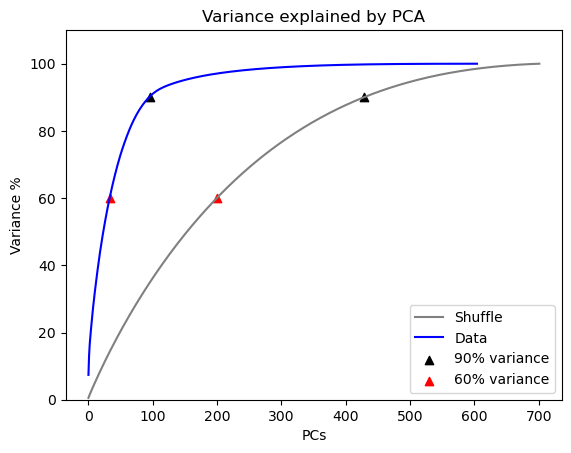

In [ ]:
%matplotlib inline
plt.plot(np.cumsum(variance_sh)*100, c='grey', label='Shuffle')
plt.plot(np.cumsum(var_5trials)*100, c='blue', label='Data')
pc_90perc_sh = np.where(np.cumsum(variance_sh)>=0.9)[0][0]
pc_30perc_sh = np.where(np.cumsum(variance_sh)>=0.3)[0][0]
pc_60perc_sh = np.where(np.cumsum(variance_sh)>=0.6)[0][0]
# plt.axvline(x = pc_90perc_sh, linestyle='--', c='k',label='90% variance')
# plt.axvline(x = pc_60perc_sh, c='grey', linestyle='--', label='60% variance')
# plt.axvline(x = pc_30perc_sh, c='k', linestyle='-.', label='30% variance')
plt.scatter(pc_90perc_sh, 90, marker='^', c='k', label='90% variance')
plt.scatter(pc_60perc_sh, 60, marker="^", c='r', label="60% variance")
plt.scatter(pc_90perc, 90, marker='^', c='k')
plt.scatter(pc_60perc, 60, marker="^", c='r')
print(np.sum(variance_sh[0:3])*100)
plt.xlabel('PCs')
plt.ylabel('Variance %')
plt.title('Variance explained by PCA')
plt.legend()
plt.ylim([0,110])
# plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/Variance_PCA_EPM_sh.svg')
plt.show()

(702, 1098)
Dimension of projected data:
(1098, 702)
(621, 621)
(621, 836)


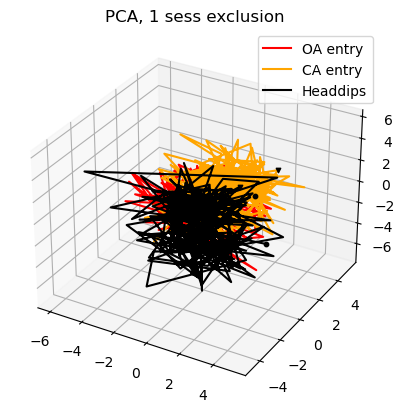

(650, 650)
(650, 836)


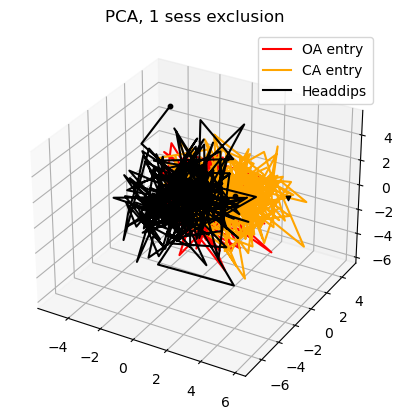

(625, 625)
(625, 836)


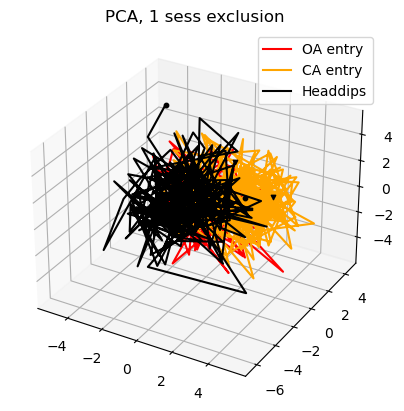

(621, 621)
(621, 836)


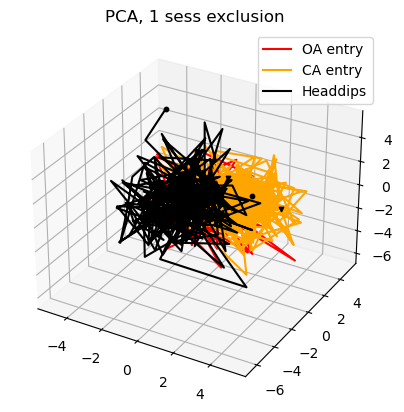

(622, 622)
(622, 836)


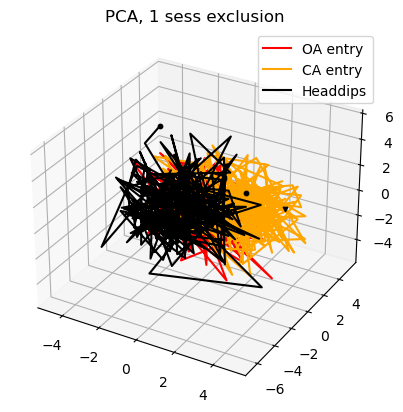

(635, 635)
(635, 836)


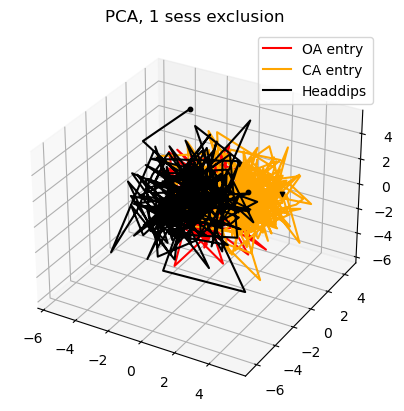

(645, 645)
(645, 836)


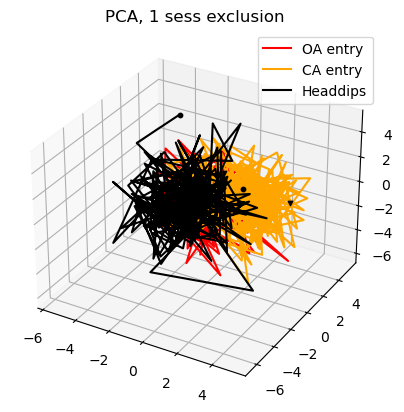

(658, 658)
(658, 836)


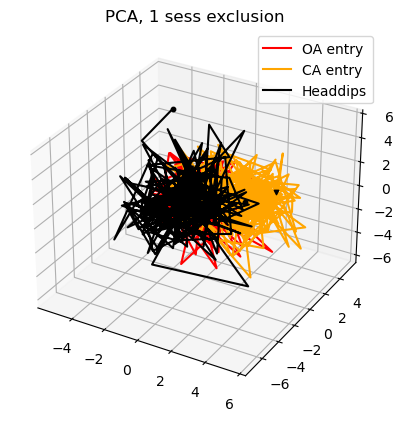

(661, 661)
(661, 836)


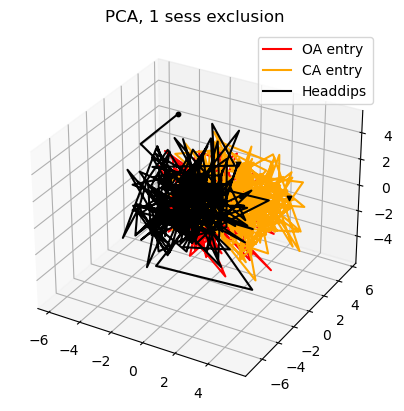

(630, 630)
(630, 836)


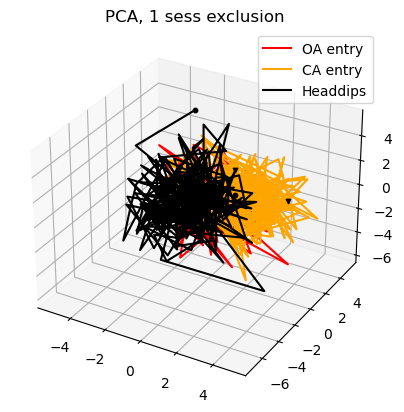

(652, 652)
(652, 836)


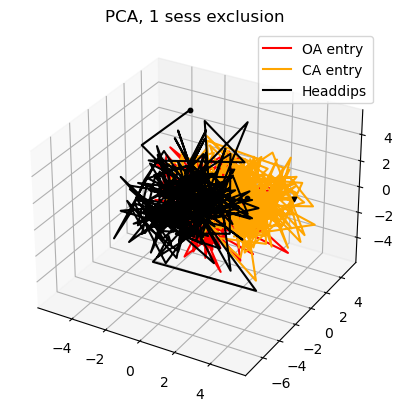

In [68]:
unitspermouse_sh, unitspermouse_cumsum_sh, bigarr_excludeonemouse_sh=PCA_statstests.unitspermouse_excludeonesessgenerator(l_data, ignoreunits_sh,excludetrials,ignoresessions, allmice_dividedtrials_sh, allmice_neural_avgtrials_sh_zscored)
l_traj_stats_sh, eigvec_sh, eigval_sh = project_excludeonemouse(bigarr_sh, bigarr_excludeonemouse_sh,unitspermouse_cumsum_sh, finalunits_entryexit,type_trial="sh")

Dimension of projected data:
(836, 100)
[0.00790986 0.01192444 0.01236642 0.01333626 0.01378964 0.01281726
 0.01163179 0.01187984 0.01265262 0.01249795 0.01261336 0.01256529
 0.01346425 0.01032937 0.01305474 0.0118557  0.01182019 0.01188596
 0.01168347 0.0119368  0.01135328 0.01148532 0.0112212  0.00993604
 0.01292955 0.01015521 0.0109355  0.01256745 0.00922956 0.01165549
 0.00984656 0.01121888 0.01036506 0.00971275 0.0110825  0.01188808
 0.01097172 0.0097218  0.01182898 0.00976744 0.00980675 0.01083387
 0.009028   0.00920101 0.00927475 0.01072911 0.0095358  0.01074266
 0.01071706 0.01086642 0.01070312 0.00904919 0.01113633 0.01023441
 0.01019862 0.00987122 0.0092222  0.01012447 0.00818744 0.00883435
 0.00938018 0.0088294  0.00884907 0.00879541 0.00932017 0.00919938
 0.00828156 0.00887551 0.00858381 0.00997426 0.00855084 0.00854392
 0.00958327 0.00929294 0.00887574 0.00805805 0.00933647 0.00931855
 0.00940729 0.0086775  0.00795066 0.00874522 0.00830313 0.00874036
 0.00876147 0.00768738

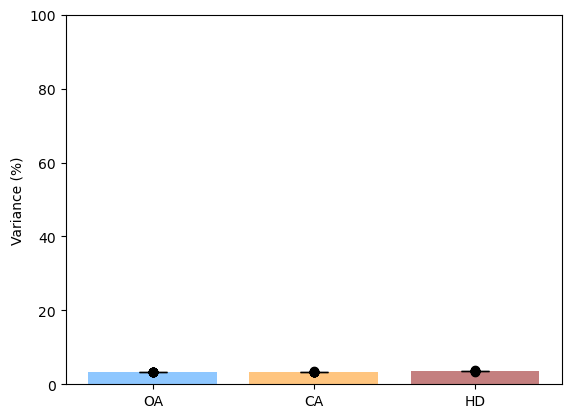

In [69]:

oa_entry = []
ca_entry = []
hd = []

for i in range(len(bigarr_excludeonemouse_sh)):
    traj , eigval_normalised_sh , PC = PCA_preprocessing.PCA_analysis(l_data_PCA=bigarr_excludeonemouse_sh[i], k = 100)


    projected_oa = PCA_preprocessing.projectdata(PC, bigarr_excludeonemouse_sh[i][:,:262])
    projected_ca = PCA_preprocessing.projectdata(PC, bigarr_excludeonemouse_sh[i][:,262:524])
    projected_headdips = PCA_preprocessing.projectdata(PC, bigarr_excludeonemouse_sh[i][:,524:])

    variance_oa = np.var(projected_oa, axis=0)
    variance_ca = np.var(projected_ca, axis=0)
    variance_headdips = np.var(projected_headdips, axis=0)

    SUM =  np.sum(variance_oa )

    explained_variance_ratio_oa = variance_oa / SUM 
    explained_variance_ratio_ca = variance_ca / np.sum(variance_ca)
    explained_variance_ratio_headdips = variance_headdips / np.sum(variance_headdips)

    print( explained_variance_ratio_oa)
    print(np.sum(explained_variance_ratio_oa))


    x = explained_variance_ratio_oa[0]*100 +explained_variance_ratio_oa[1] *100+ explained_variance_ratio_oa[2]*100 
    y = explained_variance_ratio_ca [0] * 100 +explained_variance_ratio_ca [1] * 100 + explained_variance_ratio_ca[2] * 100 
    z =  explained_variance_ratio_headdips [0] * 100 +explained_variance_ratio_headdips [1] * 100 +explained_variance_ratio_headdips[2] * 100
    print(x,y,z)

     
  
    oa_entry.append(x)
    ca_entry.append(y)
    hd.append(z)


    # Calculate mean and SEM for the accumulated data
mean_oa = np.mean(oa_entry)
mean_ca = np.mean(ca_entry)
mean_headdips = np.mean(hd)

sem_oa = sem(oa_entry)
sem_ca = sem(ca_entry)
sem_headdips = sem(hd)

# Plotting
means = [mean_oa,mean_ca,mean_headdips]
error = [sem_oa, sem_ca,sem_headdips]
colours = ['dodgerblue', 'darkorange', 'darkred']
xlabels = ["OA", "CA", "HD"]
x_pos = np.arange(len(xlabels))

plt.bar(x=x_pos, height=means, yerr=error, align='center', alpha=0.5, ecolor='black', capsize=10, color=colours)
plt.xticks(x_pos, xlabels)
plt.ylabel('Variance (%)')
plt.ylim([0, 100])

# Scatter plot of individual variances
plt.scatter(np.zeros(len(oa_entry)), oa_entry, c='k')
plt.scatter(np.ones(len(ca_entry)), ca_entry, c='k')
plt.scatter(np.full(len(hd),2),hd, c = 'k')

plt.show()


pca_stats_EPM_SH= pd.DataFrame({"Open Arm": oa_entry, "closed Arm": ca_entry, "Headdips":hd})
filename = "RESULTS/NOT-INJECTED/PCA_stats_EPM_ORIGINAL_sum3PCs_SHUFFLE.xlsx"


pca_stats_EPM_SH.to_excel(filename)


Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)
Dimension of projected data:
(836, 3)


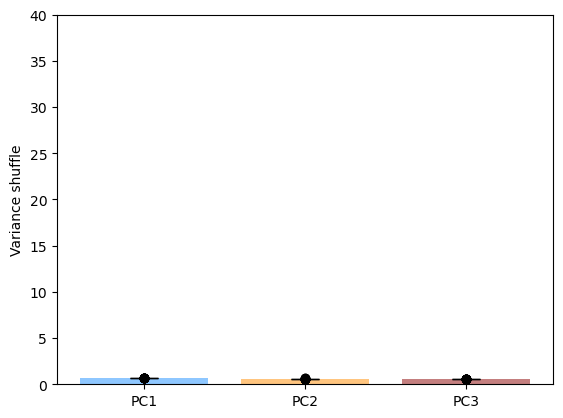

In [70]:
variance_PC1_sh = []
variance_PC2_sh = []
variance_PC3_sh = []

for i in range(len( bigarr_excludeonemouse_sh)):
    traj , eigval_normalised_sh , PC = PCA_preprocessing.PCA_analysis(l_data_PCA= bigarr_excludeonemouse_sh[i])
    # projected_data_per_mouse.append(traj)
    variance_PC1_sh.append(eigval_normalised_sh[0]*100)
    variance_PC2_sh.append(eigval_normalised_sh[1]*100)
    variance_PC3_sh.append(eigval_normalised_sh[2]*100)
    
meanPC1_saline_sh = np.mean(variance_PC1_sh)
meanPC2_saline_sh = np.mean(variance_PC2_sh)
meanPC3_saline_sh = np.mean(variance_PC3_sh)
semPC1_saline_sh = sem(variance_PC1_sh)
semPC2_saline_sh = sem(variance_PC2_sh)
semPC3_saline_sh = sem(variance_PC3_sh)
means_sh = [meanPC1_saline_sh, meanPC2_saline_sh,meanPC3_saline_sh]
error_sh = [semPC1_saline_sh, semPC2_saline_sh,semPC3_saline_sh]
colours = ['dodgerblue', 'darkorange','darkred']
xlabels = ["PC1", "PC2","PC3"]
x_pos = np.arange(len(xlabels))
plt.bar(x=x_pos, height=means_sh,yerr=error_sh, align='center', alpha=0.5, ecolor='black', capsize=10, color=colours)
plt.xticks(x_pos,xlabels)
plt.ylabel('Variance shuffle')
plt.ylim([0,40])
plt.scatter(np.zeros(len( bigarr_excludeonemouse_sh)), variance_PC1_sh,c='k')
plt.scatter(np.ones(len( bigarr_excludeonemouse_sh)), variance_PC2_sh, c='k')
plt.scatter(np.full(len( bigarr_excludeonemouse_sh),2), variance_PC3_sh, c='k')
plt.savefig('RESULTS/NOT-INJECTED/PCA_EPM_variance_shuffle.svg')
plt.show()

In [ ]:
# IGNORE !!

%matplotlib inline
dist_metrics_mah = PCA_statstests.mahalanobis_distance(l_traj_stats, datatype="real")
dist_metrics_mah_sh = PCA_statstests.mahalanobis_distance(l_traj_stats=l_traj_stats_sh, datatype="sh")

# anova 
from scipy.stats import f_oneway 
anovaresult = f_oneway(dist_metrics_mah[0], dist_metrics_mah[1], dist_metrics_mah[2], dist_metrics_mah_sh[0], dist_metrics_mah_sh[1], dist_metrics_mah_sh[2])

print(anovaresult)

from statsmodels.stats.multicomp import pairwise_tukeyhsd
import pandas as pd

titles = ["OA", "CA", "HD", "OA_sh", "CA_sh", "HD_sh"]
savemetrics = np.concatenate((dist_metrics_mah.squeeze(), np.array(dist_metrics_mah_sh).squeeze()), axis=0)
metrics_df_all = pd.DataFrame({'score': savemetrics.flatten(), 'group': np.repeat(titles, repeats=len(l_mouse_name))})

tukey = pairwise_tukeyhsd(endog=metrics_df_all['score'],
                          groups=metrics_df_all['group'],
                          alpha=0.05)
print(tukey)



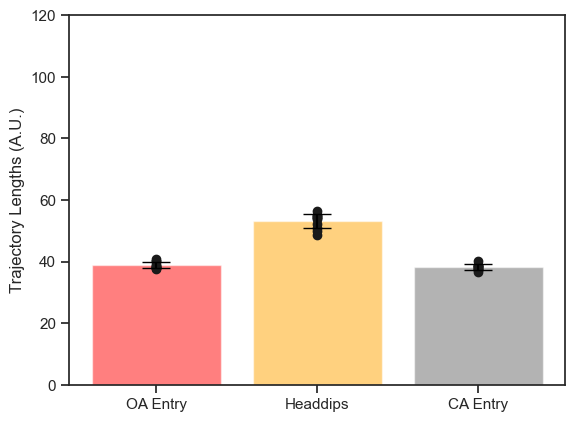

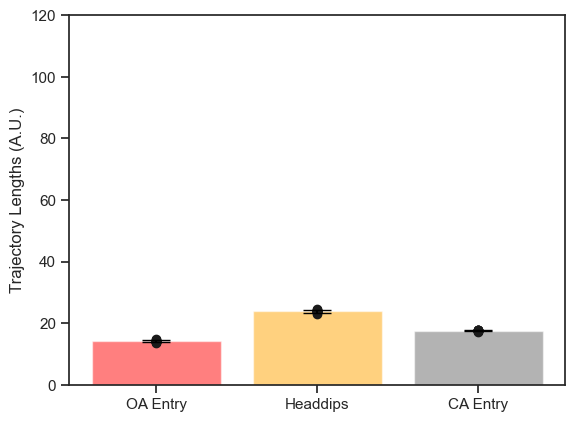

In [ ]:
%matplotlib inline
metrics,_, origin = PCA_statstests.obtain_metrics(l_traj_stats=l_traj_stats, finalunits_entryexit=allmice_neural_avgtrials_zscored, unitspermouse=unitspermouse,pc_90perc=3, metric_type="length", mid_select=True)
plt.ylim([0,120])
plt.savefig("RESULTS/NOT-INJECTED/PCA_finalpicturesNew/PCA_EPM_Definedtrials_entryexit_statistics_length.svg")
plt.show()

metrics_sh,_,_ = PCA_statstests.obtain_metrics(l_traj_stats=l_traj_stats_sh, finalunits_entryexit=allmice_neural_avgtrials_zscored, unitspermouse=unitspermouse, metric_type="length", pc_90perc=3, mid_select=True)#pc_90perc_sh)
plt.ylim([0,120])
plt.savefig("RESULTS/NOT-INJECTED/PCA_finalpicturesNew/PCA_EPM_Definedtrials_entryexit_statistics_length_sh.svg")
plt.show()

In [ ]:
# ANOVA ON ALL 
# TUKEY MULITPLE COMPARISON TEST FOR POST HOC

from statsmodels.stats.multicomp import pairwise_tukeyhsd
import pandas as pd

titles = ["OA", "CA", "HD", "OA_sh", "CA_sh", "HD_sh"]
savemetrics = np.concatenate((np.array(metrics)[:,:,:1].squeeze(), np.array(metrics_sh)[:,:,:1].squeeze()), axis=0)
metrics_df_all = pd.DataFrame({'score': savemetrics.flatten(), 'group': np.repeat(titles, repeats=len(l_mouse_name))})

tukey = pairwise_tukeyhsd(endog=metrics_df_all['score'],
                          groups=metrics_df_all['group'],
                          alpha=0.05)
print(tukey)

filename = "RESULTS/NOT-INJECTED/Tukey_posthoc_PCAstatslength_kilo_modified_final_20240708.xlsx"
metrics_df_all.to_excel(filename)
#f=open(filename, "a")
#f.write(str(metrics_df_all))
#f.close()# ANOVA ON ALL 

 Multiple Comparison of Means - Tukey HSD, FWER=0.05  
group1 group2 meandiff p-adj   lower    upper   reject
------------------------------------------------------
    CA  CA_sh -17.5075    0.0  -18.882  -16.133   True
    CA     HD  16.6721    0.0  15.2976  18.0466   True
    CA  HD_sh -19.3447    0.0 -20.7193 -17.9702   True
    CA     OA   0.0981 0.9999  -1.2764   1.4726  False
    CA  OA_sh   -23.71    0.0 -25.0845 -22.3355   True
 CA_sh     HD  34.1797    0.0  32.8052  35.5542   True
 CA_sh  HD_sh  -1.8372 0.0027  -3.2117  -0.4627   True
 CA_sh     OA  17.6056    0.0  16.2311  18.9801   True
 CA_sh  OA_sh  -6.2025    0.0   -7.577   -4.828   True
    HD  HD_sh -36.0169    0.0 -37.3914 -34.6424   True
    HD     OA  -16.574    0.0 -17.9485 -15.1995   True
    HD  OA_sh -40.3821    0.0 -41.7566 -39.0076   True
 HD_sh     OA  19.4428    0.0  18.0683  20.8173   True
 HD_sh  OA_sh  -4.3653    0.0  -5.7398  -2.9908   True
    OA  OA_sh -23.8081    0.0 -25.1826 -22.4336   True
----------

In [ ]:
titles = ["OA", "CA", "HD"]
savemetrics = np.array(metrics)[:,:,:1].squeeze()
metrics_df_all = pd.DataFrame({'score': savemetrics.flatten(), 'group': np.repeat(titles, repeats=len(l_mouse_name))})

tukey = pairwise_tukeyhsd(endog=metrics_df_all['score'],
                          groups=metrics_df_all['group'],
                          alpha=0.05)
print(tukey)

 Multiple Comparison of Means - Tukey HSD, FWER=0.05  
group1 group2 meandiff p-adj   lower    upper   reject
------------------------------------------------------
    CA     HD  16.6721    0.0  15.1564  18.1879   True
    CA     OA   0.0981 0.9863  -1.4177   1.6139  False
    HD     OA  -16.574    0.0 -18.0898 -15.0583   True
------------------------------------------------------


# DECODER

In [362]:
import PCA_decoders

In [266]:
#decoder svm 

len(allmice_dividedtrials_25)


5

In [423]:
allmice_trials_25_dec,allmice_trials_25_dec_sh = [None]*len(allmice_dividedtrials_25),[None]*len(allmice_dividedtrials_25)

for i in range(len(allmice_dividedtrials_25)):
    allmice_trials_25_dec[i]=[None]*(len(allmice_dividedtrials_25[i])-1)
    allmice_trials_25_dec_sh[i]=[None]*(len(allmice_dividedtrials_25[i])-1)
    for j in range(len(allmice_dividedtrials_25[i])-1): # removing the last mouse coz of low no. of headdips
        allmice_trials_25_dec[i][j] = allmice_dividedtrials_25[i][j]
        allmice_trials_25_dec_sh[i][j] = allmice_dividedtrials_sh[i][j]


In [424]:
def dataset_generator_decoder(allmice_dividedtrials, unitspermouse_cumsum,eigvec, eigval, units):
    
    allmice_neural_sliding = [None]*len(allmice_dividedtrials) # 5
    if allmice_dividedtrials[0][0].shape[1]>200:
        len_trial = allmice_dividedtrials[0][0].shape[1]-10
        window = 10
        window_bin = 0.025
    else:
        len_trial = allmice_dividedtrials[0][0].shape[1]-5
        window = 5
        window_bin = 0.05
    removeunitspertrial = [None]*len(allmice_dividedtrials)
    trials_final = [None]*len(allmice_dividedtrials)
    

    for i in range(len(allmice_dividedtrials)):# for each trial type 
        # print('trial number', i)

        allmice_neural_sliding[i]=[None]*len(allmice_dividedtrials[i]) #for 11 mouse
        removeunitspertrial[i] = [None]*len(allmice_dividedtrials[i]) #for 11 mouse
        trials_final[i] = [None]*len(allmice_dividedtrials[i]) #for 11 mouse

        for k in range(len(allmice_dividedtrials[0])):#for each mouse 
            # print('mouse number', k)
            trials_final[i][k]=[]
            removeunitspertrial[i][k]=[]
            allmice_neural_sliding[i][k] = np.zeros((allmice_dividedtrials[i][k].shape[0],len_trial,allmice_dividedtrials[i][k].shape[-1]))
            
            for j in range(len_trial):
                allmice_neural_sliding[i][k][:,j,:] = np.sum(allmice_dividedtrials[i][k][:,j:j+window,:], axis=1)
            
           
            for j in range(allmice_neural_sliding[i][k].shape[0]): #
                zsc,rem = PCA_preprocessing.z_score(array=allmice_neural_sliding[i][k][j,:,:].T.copy(), ignoreunits=[], window_bin=window_bin)
                
                removeunitspertrial[i][k].append(rem)
                if len(rem) != 0:
                    zsc = np.delete(zsc, rem, axis=0)
                if np.sum(1*np.isnan(zsc)) == 0 and np.sum(1*np.isinf(zsc)) == 0:
                    #trials_final[i][k].append(zsc)
                    deleteeigenvalsvecs =np.arange(unitspermouse_cumsum[k],unitspermouse_cumsum[k+1])#np.arange(eigvec.shape[0]-(-unitspermouse_cumsum[i]+unitspermouse_cumsum[i+1]),eigvec.shape[0]) #
                    
                    if len(rem) != 0:
                        deleteeigenvalsvecs= np.delete(deleteeigenvalsvecs, rem)
                    eigvec_copy = np.copy(eigvec)
                    eigenval_copy = np.copy(eigval)
                    # print(len(deleteeigenvalsvecs))
                    eigenvec_stats = eigvec_copy[deleteeigenvalsvecs,:]
                    # print(eigenvec_stats.shape)
                    eigval_stats =eigenval_copy[deleteeigenvalsvecs]
                    idx_argsorteigval = np.argsort(eigval_stats)[::-1]
                    eigenvec_stats = eigenvec_stats[:,idx_argsorteigval]
                    l_traj_bigsinglesess = PCA_statstests.projectdata(data_mat=zsc, PC=eigenvec_stats)[:,:units] #PCA_analysis(bigarr_excludeonemouse[i]) #PCA_analysis(bigarr_onlyone[i])[0] #
                    
                    if (l_traj_bigsinglesess.shape)[-1] == 0:
                        continue
                    trials_final[i][k].append(l_traj_bigsinglesess)
            trials_final[i][k]= np.array(trials_final[i][k])
    return trials_final


In [426]:
# remove the last mouse from analysis - only 2 headdips
trials_final_real =PCA_decoders.dataset_generator_decoder(allmice_dividedtrials=allmice_trials_25_dec, unitspermouse_cumsum=unitspermouse_cumsum[:-1],eigvec=eigvec[:-1], eigval=eigval[:-1], units = 3)
trials_final_sh = PCA_decoders.dataset_generator_decoder(allmice_dividedtrials=allmice_trials_25_dec_sh, unitspermouse_cumsum=unitspermouse_cumsum_sh[:-1],eigvec=eigvec_sh[:-1], eigval=eigval_sh[:-1], units=3)

71
68
70
70
69
69
69
68
69
69
70
70
70
70
70
68
71
70
71
70
70
71
70
71
70
70
70
71
71
69
67
70
70
69
71
70
70
71
69
71
69
70
70
71
71
69
71
70
68
46
46
46
46
46
46
46
45
45
46
46
46
46
44
44
45
46
46
46
46
46
45
46
45
45
46
46
42
44
45
45
46
44
46
44
45
64
63
65
66
63
65
64
63
61
65
67
64
67
66
63
65
62
64
67
66
65
66
67
65
67
66
63
65
65
62
67
65
64
65
64
65
64
62
64
62
64
62
63
65
72
75
74
76
73
75
75
75
74
71
75
74
73
73
75
76
74
73
74
74
75
76
74
73
75
76
75
75
74
75
74
75
75
74
76
75
74
74
75
72
74
73
75
64
66
64
64
65
61
64
66
55
62
61
64
65
62
65
66
67
63
66
63
65
67
65
63
64
65
65
66
67
61
66
66
67
66
66
67
64
66
63
65
66
67
67
67
65
66
65
67
65
59
66
66
65
65
63
33
33
33
33
34
33
34
33
33
32
33
33
34
33
34
32
34
34
34
31
33
34
34
32
31
32
33
32
34
33
33
33
32
32
34
33
32
34
32
33
34
34
33
33
33
33
31
55
54
55
55
54
55
54
55
53
54
54
55
54
53
54
55
53
54
53
55
53
53
53
52
55
54
53
53
54
54
53
54
53
54
54
54
53
55
54
54
54
55
53
55
54
54
53
54
53
55
38
37
38
39
39
39
39
38
38
3

In [427]:
dataset_num = 10

In [ ]:
alltrialsnum = 0
alltrials_rem = 0
for i in range(5):
    for j in range(11):
        alltrialsnum += len(allmice_dividedtrials[i][j])
        alltrials_rem += len(trials_final_real[i][j])
# len(trials_final_real)

In [52]:
(8*5*11)/alltrials_rem

0.9421841541755889

In [429]:
datasets_real = PCA_decoders.dataset_permute_bootstrapper(trials_final=trials_final_real, dataset_num=10) # , trialtype_select=np.array([0,2])
datasets_sh = PCA_decoders.dataset_permute_bootstrapper(trials_final=trials_final_sh, dataset_num=10)

8

8



In [430]:
from sklearn import linear_model
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn import svm
import sklearn
from sklearn.metrics import accuracy_score

In [264]:

# #l_traj_stats - this has a len of 70. and each element is 786*3. 786 / 3 - 262. here in 786, 262 is oa, then next 262 is ca and then last one are head dips. 
# def decoder(l_traj_stats, num_trials =3, decodertype = "svm" ):

#     inc = int(len(l_traj_stats[0])/num_trials) #262
#     num_datasets = 1 # this is number of dataset, doesnt matter much
#     num_sess = len(l_traj_stats)#70, number of session 
#     labels = np.zeros((len(l_traj_stats)*num_trials*num_datasets)) #70*3*1, shape of the labels 
#     trajectories = np.zeros((len(l_traj_stats)*num_trials*num_datasets, inc, 3)) #140, 262, 3,
#     c = 0
#     print(trajectories.shape)
#     #print(inc)
#     for k in range(num_datasets): # for data set 
#         for i in range(num_sess):#70
#             for j in range(num_trials):#3  # for each trial type, we will extract oa , ca, hd ie, array of [262,3]
#                 trajectories[c,:,:] = l_traj_stats[i][(inc*j) :inc*(j+1),:3]#traj [262, 3]
#                 labels[c] = j # trial [label associalted with that traj]
#                 c+=1
       
#     print(trajectories.shape)
#     trajectories = trajectories[:,80:,:]
#     print(trajectories.shape)
#     # print("LABEL",labels)
#     trajectories_2d = trajectories.reshape((len(l_traj_stats)*num_trials*num_datasets), -1)
#     print(trajectories_2d.shape)
    
#     # train-test split : 3/4th of dataset to train, 1/4th to test
#     train_x, test_x, train_y, test_y = train_test_split(trajectories_2d, labels) 
#     if decodertype == "svm": # then apply the classifier     
#                 reg = svm.LinearSVC(max_iter=50000)#svm.SVC(probability=True) #linear_model.Lasso(alpha=0.1) #linear_model.LinearRegression() # #
#                 reg.fit(train_x, train_y)
#                 yhat = reg.predict(test_x)
                
            
#     confusion_matrix = sklearn.metrics.confusion_matrix(test_y, yhat)
#         # cm_display = sklearn.metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["OA_entry","CA_entry","Headdips"])

#     acc = accuracy_score(test_y, yhat)


#     return acc, confu
# random.seed(4000)
# decodertype = "svm"
# adjusted_r_squared, adjusted_r_squared_sh=[], []
# acc_OA, acc_CA, acc_hd, acc_OA_sh, acc_CA_sh, acc_hd_sh = [], [], [], [], [], []
# for i in range(dataset_num):
#     print(i)
#     x = decoder(l_traj_stats=datasets_real[i], decodertype=decodertype)
#     adjusted_r_squared.append(x)
#     # acc_OA.append(oa)
#     # acc_CA.append(ca)
#     # acc_hd.append(hd)
    

#     x =PCA_decoders.decoder(l_traj_stats=datasets_sh[i], decodertype=decodertype)
#     adjusted_r_squared_sh.append(x)
# #     acc_OA_sh.append(oa)
# #     acc_CA_sh.append(ca)
# #     acc_hd_sh.append(hd)


0
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
1
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
2
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
3
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
4
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
5
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
6
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
7
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
8
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)
9
(210, 262, 3)
(210, 262, 3)
(210, 182, 3)
(210, 546)


In [263]:
np.mean(adjusted_r_squared), np.mean(adjusted_r_squared_sh)

(0.4867924528301887, 0.3635247114834939)

In [80]:
from sklearn import linear_model
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn import svm
import sklearn

In [ ]:
#np.savez("decoder_EPM_l_data_allunitshufflecase.npz", adjusted_r_squared=adjusted_r_squared, adjusted_r_squared_sh=adjusted_r_squared_sh)

In [433]:
random.seed(4000)
dataset_num = 10
decodertype = "svm"
adjusted_r_squared, adjusted_r_squared_sh=[], []
acc_OA, acc_CA, acc_hd, acc_OA_sh, acc_CA_sh, acc_hd_sh = [], [], [], [], [], []
for i in range(dataset_num):
    # print(i)
    x,oa,ca, hd = PCA_decoders.decoder(l_traj_stats=datasets_real[i], decodertype=decodertype)
    adjusted_r_squared.append(x)
    acc_OA.append(oa)
    acc_CA.append(ca)
    acc_hd.append(hd)

    x,oa,ca, hd =PCA_decoders.decoder(l_traj_stats=datasets_sh[i], decodertype=decodertype)
    adjusted_r_squared_sh.append(x)
    acc_OA_sh.append(oa)
    acc_CA_sh.append(ca)
    acc_hd_sh.append(hd)


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_8432\689112100.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


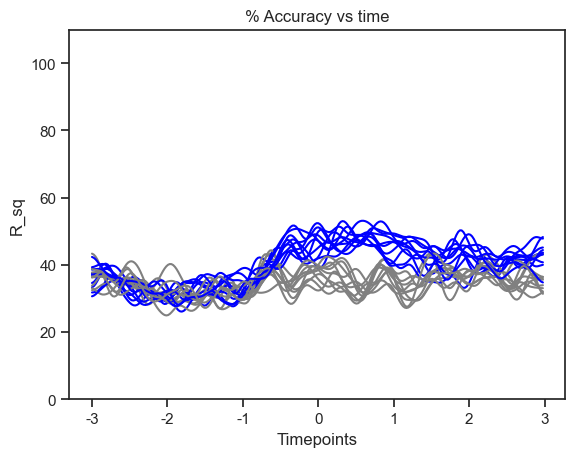

In [ ]:
%matplotlib inline
fig, ax = plt.subplots()
for i in range(len(adjusted_r_squared)):
    ax.plot(gaussian_filter1d(adjusted_r_squared[i], sigma=3)*100, c='blue')
    ax.plot(gaussian_filter1d(adjusted_r_squared_sh[i], sigma=3)*100, c="grey")
ax.set_title('% Accuracy vs time')
ax.set_ylabel('R_sq')
ax.set_xlabel('Timepoints')
t_show = np.arange(-3,4,1)
ticknum = len(t_show)
idx_ticks = np.linspace(0, len_trial_25, ticknum)
ax.set_xticklabels(t_show)
ax.set_xticks(idx_ticks)
plt.ylim([0,110])
#plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpictures/SVM/decoderEPM_accuracy_'+decodertype+'.svg')
plt.show()

(262,)


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_8432\3771584885.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


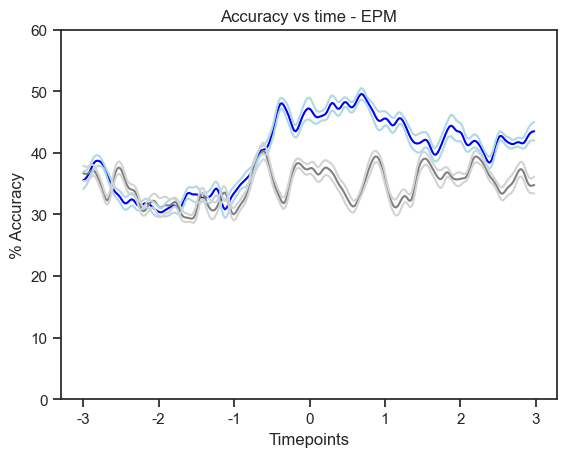

In [ ]:
fig, ax = plt.subplots()
mean_real_adj = np.mean(adjusted_r_squared, axis=0)
print(mean_real_adj.shape)
mean_sh_adj = np.mean(adjusted_r_squared_sh, axis=0)
stdd_real_adj = sem(adjusted_r_squared, axis=0) # change to sem 
stdd_sh_adj = sem(adjusted_r_squared_sh, axis=0)

ax.plot((mean_real_adj)*100, c='blue')
ax.plot((mean_sh_adj)*100, c="grey")
ax.plot((mean_real_adj-stdd_real_adj)*100,c='lightblue')
ax.plot((mean_real_adj+stdd_real_adj)*100,c='lightblue')
ax.plot((mean_sh_adj-stdd_sh_adj)*100,c='lightgrey')
ax.plot((mean_sh_adj+stdd_sh_adj)*100,c='lightgrey')

ax.set_title('Accuracy vs time - EPM')
ax.set_ylabel('% Accuracy')
ax.set_xlabel('Timepoints')
t_show = np.arange(-3,4,1)
ticknum = len(t_show)
idx_ticks = np.linspace(0, len_trial_25, ticknum)
ax.set_xticklabels(t_show)
plt.ylim([0, 110])
ax.set_xticks(idx_ticks)
plt.ylim([0,60])
# plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/SVM/decoderEPM_accuracy3trials.svg')
plt.show()

In [381]:
len(adjusted_r_squared[2])

262

In [389]:
mean1 = np.mean(adjusted_r_squared
                , axis = 0)
mean2 = np.mean(adjusted_r_squared_sh, axis = 0)
mean11 = np.mean(mean1[80:])
print(len(mean1[120:]))
mean22 = np.mean(mean2[80:])
print(mean11, mean22)

142
0.4294569922388878 0.35942825293682445


25

25

0
1
2
3
4
5
6
7
8
9


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_8432\2314567814.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


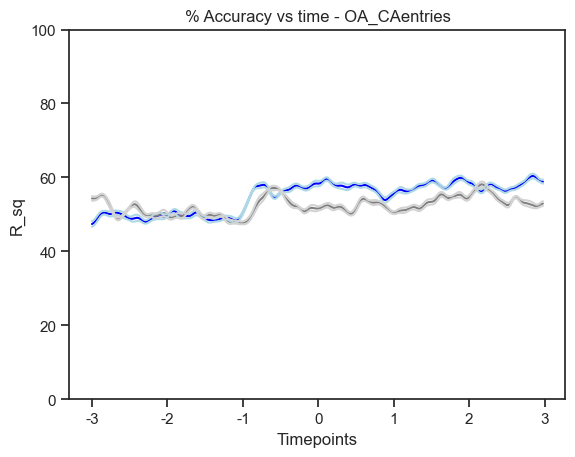

In [ ]:
# decoder 3C2 - 
# TRIAL NUM 0 - OA, TRIALNUM 2 - CA, TRIALNUM 4 - HD
def decoder_3c2(trials_final_real,trials_final_sh, trialtype_select, title, dataset_num, l_traj_stats):
    np.random.seed(50)
    datasets_real_1 = PCA_decoders.dataset_permute_bootstrapper(dataset_num=10,trials_final=trials_final_real, trialtype_select=trialtype_select)
    datasets_sh_1 = PCA_decoders.dataset_permute_bootstrapper(dataset_num=10,trials_final=trials_final_sh, trialtype_select=trialtype_select)
    decodertype = "svm"
    adjusted_r_squared, adjusted_r_squared_sh=[], []
    # acc_OA, acc_CA, acc_hd, acc_OA_sh, acc_CA_sh, acc_hd_sh = [], [], [], [], [], []
    for i in range(dataset_num):
        print(i)
        x,oa,ca, hd = PCA_decoders.decoder(l_traj_stats=datasets_real_1[i], decodertype=decodertype,num_trials=2)
        adjusted_r_squared.append(x)
        # acc_OA.append(oa)
        # acc_CA.append(ca)
        # acc_hd.append(hd)

        x,oa,ca, hd = PCA_decoders.decoder(l_traj_stats=datasets_sh_1[i], decodertype=decodertype, num_trials=2)
        adjusted_r_squared_sh.append(x)
        # acc_OA_sh.append(oa)
        # acc_CA_sh.append(ca)
        # acc_hd_sh.append(hd)

    fig, ax = plt.subplots()
    mean_real_adj = np.mean(adjusted_r_squared, axis=0)
    mean_sh_adj = np.mean(adjusted_r_squared_sh, axis=0)
    stdd_real_adj = sem(adjusted_r_squared, axis=0) # change to sem 
    stdd_sh_adj = sem(adjusted_r_squared_sh, axis=0)

    ax.plot((mean_real_adj)*100, c='blue')
    ax.plot((mean_sh_adj)*100, c="grey")
    ax.plot((mean_real_adj-stdd_real_adj)*100,c='lightblue')
    ax.plot((mean_real_adj+stdd_real_adj)*100,c='lightblue')
    ax.plot((mean_sh_adj-stdd_sh_adj)*100,c='lightgrey')
    ax.plot((mean_sh_adj+stdd_sh_adj)*100,c='lightgrey')

    ax.set_title('% Accuracy vs time - '+title)
    ax.set_ylabel('R_sq')
    ax.set_xlabel('Timepoints')
    t_show = np.arange(-3,4,1)
    ticknum = len(t_show)
    idx_ticks = np.linspace(0, int((l_traj_stats[0].shape[0])/3), ticknum)
    ax.set_xticklabels(t_show)
    ax.set_xticks(idx_ticks)
    plt.ylim([0,100])
    # plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/SVM/decoderEPM_accuracy_'+title+'.svg')
    plt.show()

    return adjusted_r_squared,adjusted_r_squared_sh


adjusted_r_squared_OACA,adjusted_r_squared_sh_OACA = decoder_3c2(trials_final_real,trials_final_sh, trialtype_select=np.array([0,2]), title="OA_CAentries", dataset_num=dataset_num, l_traj_stats=l_traj_stats)
# adjusted_r_squared_OAHD,adjusted_r_squared_sh_OAHD=decoder_3c2(trials_final_real,trials_final_sh, trialtype_select=np.array([0,4]), title="OAEntry_Headdips", dataset_num=dataset_num, l_traj_stats=l_traj_stats)
# adjusted_r_squared_CAHD,adjusted_r_squared_sh_CAHD=decoder_3c2(trials_final_real,trials_final_sh, trialtype_select=np.array([2,4]), title="CAentry_Headdips", dataset_num=dataset_num, l_traj_stats=l_traj_stats)

In [450]:
table_Shuffle_SVM = pd.DataFrame(adjusted_r_squared_sh_OACA)
table_Shuffle_SVM.to_excel("SVM_Shuffle_Stats.xlsx")

In [448]:
np.mean(adjusted_r_squared_OACA),np.mean(adjusted_r_squared_sh_OACA)
mean1 = np.mean(adjusted_r_squared_OACA
                , axis = 0)
mean2 = np.mean(adjusted_r_squared_sh_OACA, axis = 0)
mean11 = np.mean(mean1[200:])
mean22 = np.mean(mean2[200:])
print(mean11, mean22)

real_mean = []
shuffle_mean = []
for i in range(dataset_num):
    mean = np.mean(adjusted_r_squared_OACA[i][80:])
    real_mean.append(mean)

    mean_sh = np.mean(adjusted_r_squared_sh_OACA[i][80:])
    shuffle_mean.append(mean_sh)

0.5808384057602439 0.5456911971068049


In [443]:
real_mean, shuffle_mean

([0.5694015073822846,
  0.5798872103807281,
  0.5753360428154892,
  0.5719612945020047,
  0.5678829667320575,
  0.5702750611543421,
  0.5615416548094726,
  0.5673437212875274,
  0.5706946818439556,
  0.5660008924872809],
 [0.5262096425597851,
  0.5273927773533065,
  0.527220309777016,
  0.5345231685799392,
  0.5305170984994848,
  0.5377660930384968,
  0.5254851638970488,
  0.5278668540959395,
  0.528255566614711,
  0.5308153583133556])

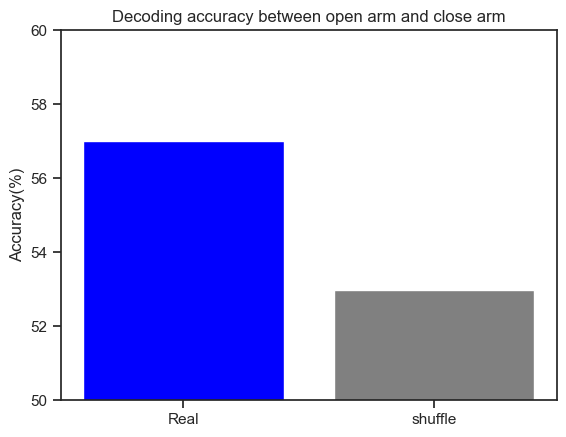

In [444]:
labels = ['Real', 'shuffle']
values = [mean11*100, mean22*100]

# Create a bar plot
plt.bar(labels, values, color=['blue', 'grey'])

# Add title and labels
plt.title('Decoding accuracy between open arm and close arm')
plt.ylabel('Accuracy(%)')
plt.ylim([50,60])

# Show the plot
plt.show()

C:\Users\ycouderc\AppData\Local\Temp\ipykernel_25892\689112100.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


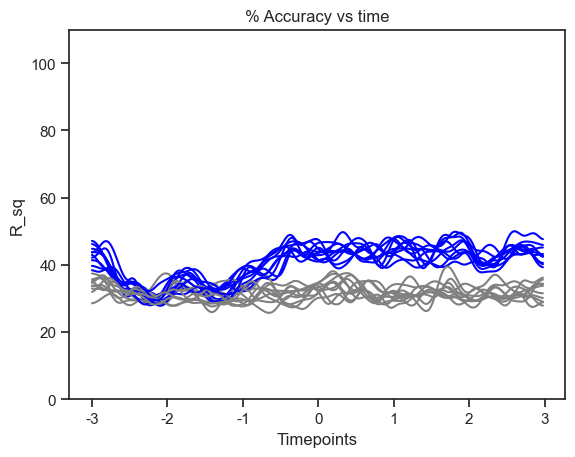

In [ ]:
%matplotlib inline
fig, ax = plt.subplots()
for i in range(len(adjusted_r_squared)):
    ax.plot(gaussian_filter1d(adjusted_r_squared[i], sigma=3)*100, c='blue')
    ax.plot(gaussian_filter1d(adjusted_r_squared_sh[i], sigma=3)*100, c="grey")
ax.set_title('% Accuracy vs time')
ax.set_ylabel('R_sq')
ax.set_xlabel('Timepoints')
t_show = np.arange(-3,4,1)
ticknum = len(t_show)
idx_ticks = np.linspace(0, len_trial_25, ticknum)
ax.set_xticklabels(t_show)
ax.set_xticks(idx_ticks)
plt.ylim([0,110])
#plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpictures/SVM/decoderEPM_accuracy_'+decodertype+'.svg')
plt.show()

(262,)


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_25892\1826298105.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


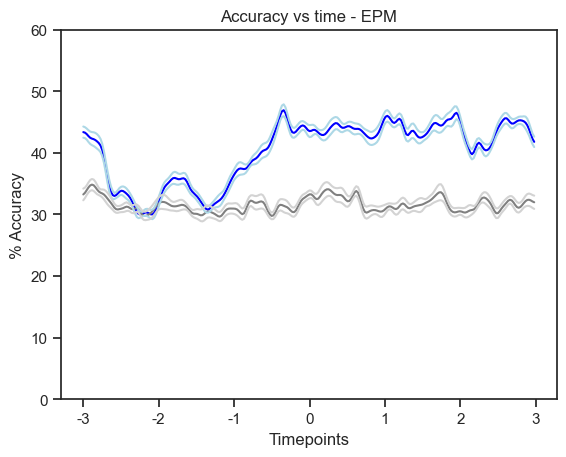

In [ ]:
fig, ax = plt.subplots()
mean_real_adj = np.mean(adjusted_r_squared, axis=0)
print(mean_real_adj.shape)
mean_sh_adj = np.mean(adjusted_r_squared_sh, axis=0)
stdd_real_adj = sem(adjusted_r_squared, axis=0) # change to sem 
stdd_sh_adj = sem(adjusted_r_squared_sh, axis=0)

ax.plot((mean_real_adj)*100, c='blue')
ax.plot((mean_sh_adj)*100, c="grey")
ax.plot((mean_real_adj-stdd_real_adj)*100,c='lightblue')
ax.plot((mean_real_adj+stdd_real_adj)*100,c='lightblue')
ax.plot((mean_sh_adj-stdd_sh_adj)*100,c='lightgrey')
ax.plot((mean_sh_adj+stdd_sh_adj)*100,c='lightgrey')

ax.set_title('Accuracy vs time - EPM')
ax.set_ylabel('% Accuracy')
ax.set_xlabel('Timepoints')
t_show = np.arange(-3,4,1)
ticknum = len(t_show)
idx_ticks = np.linspace(0, len_trial_25, ticknum)
ax.set_xticklabels(t_show)
plt.ylim([0, 110])
ax.set_xticks(idx_ticks)
plt.ylim([0,60])
plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/SVM/decoderEPM_accuracy3trials.svg')
plt.show()

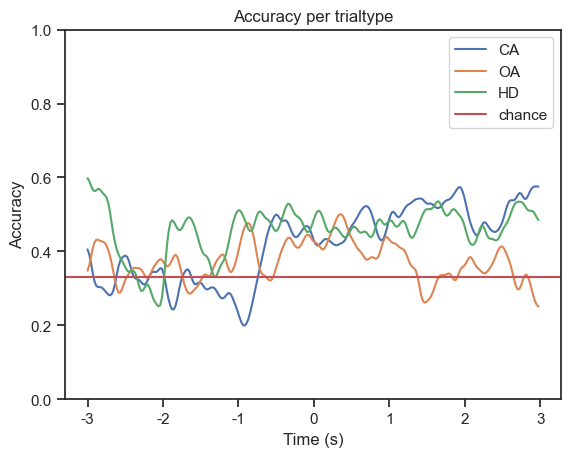

In [ ]:
mean_CA = np.mean(np.array(acc_CA), axis=0)
plt.plot(gaussian_filter1d(mean_CA, sigma = 2), label="CA")
mean_OA = np.mean(np.array(acc_OA), axis=0)
plt.plot(gaussian_filter1d(mean_OA, sigma = 2), label="OA")
mean_h = np.mean(np.array(acc_hd), axis=0)
plt.plot(gaussian_filter1d(mean_h, sigma = 2), label="HD")
plt.ylim([0,1])
plt.axhline(y=0.33, c='r', label="chance")
plt.legend()
t_show = np.arange(-3,4,1)
# plt.xticklabels(t_show)
plt.xticks(idx_ticks, t_show)
plt.ylabel("Accuracy")
plt.title("Accuracy per trialtype")
plt.xlabel("Time (s)")
plt.show()

23

23

0
1
2
3
4
5
6
7
8
9


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_25892\131962392.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


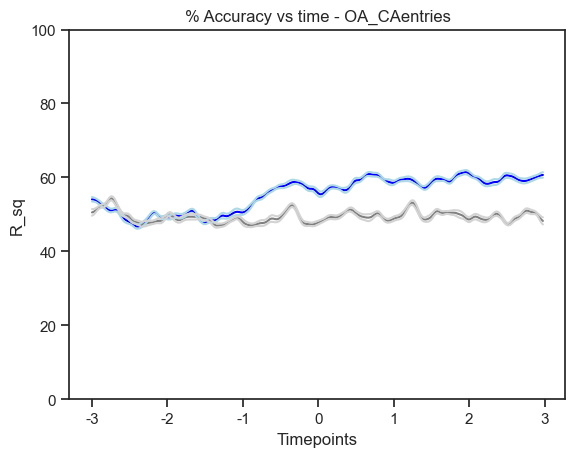

8

8

0
1
2
3
4
5
6
7
8
9


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_25892\131962392.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


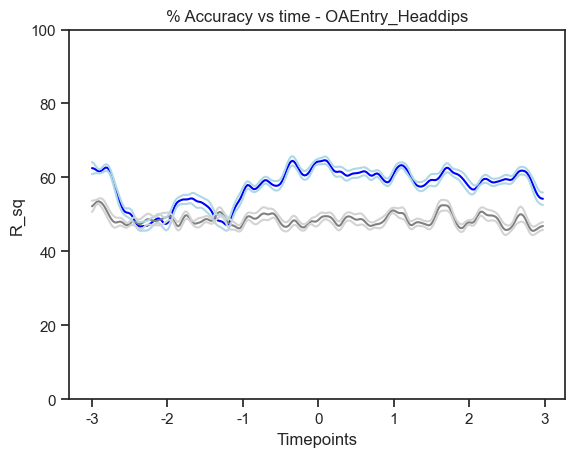

8

8

0
1
2
3
4
5
6
7
8
9


C:\Users\ycouderc\AppData\Local\Temp\ipykernel_25892\131962392.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(t_show)


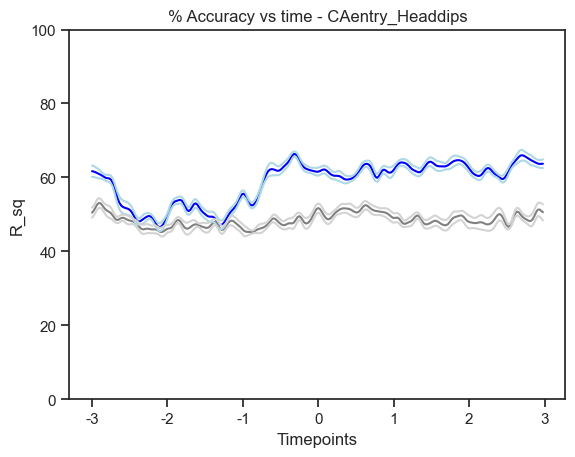

In [ ]:
# decoder 3C2 - 
# TRIAL NUM 0 - OA, TRIALNUM 2 - CA, TRIALNUM 4 - HD
def decoder_3c2(trials_final_real,trials_final_sh, trialtype_select, title, dataset_num, l_traj_stats):
    np.random.seed(50)
    datasets_real_1 = PCA_decoders.dataset_permute_bootstrapper(dataset_num=10,trials_final=trials_final_real, trialtype_select=trialtype_select)
    datasets_sh_1 = PCA_decoders.dataset_permute_bootstrapper(dataset_num=10,trials_final=trials_final_sh, trialtype_select=trialtype_select)
    decodertype = "svm"
    adjusted_r_squared, adjusted_r_squared_sh=[], []
    # acc_OA, acc_CA, acc_hd, acc_OA_sh, acc_CA_sh, acc_hd_sh = [], [], [], [], [], []
    for i in range(dataset_num):
        print(i)
        x,oa,ca, hd = PCA_decoders.decoder(l_traj_stats=datasets_real_1[i], decodertype=decodertype,num_trials=2)
        adjusted_r_squared.append(x)
        # acc_OA.append(oa)
        # acc_CA.append(ca)
        # acc_hd.append(hd)

        x,oa,ca, hd = PCA_decoders.decoder(l_traj_stats=datasets_sh_1[i], decodertype=decodertype, num_trials=2)
        adjusted_r_squared_sh.append(x)
        # acc_OA_sh.append(oa)
        # acc_CA_sh.append(ca)
        # acc_hd_sh.append(hd)

    fig, ax = plt.subplots()
    mean_real_adj = np.mean(adjusted_r_squared, axis=0)
    mean_sh_adj = np.mean(adjusted_r_squared_sh, axis=0)
    stdd_real_adj = sem(adjusted_r_squared, axis=0) # change to sem 
    stdd_sh_adj = sem(adjusted_r_squared_sh, axis=0)

    ax.plot((mean_real_adj)*100, c='blue')
    ax.plot((mean_sh_adj)*100, c="grey")
    ax.plot((mean_real_adj-stdd_real_adj)*100,c='lightblue')
    ax.plot((mean_real_adj+stdd_real_adj)*100,c='lightblue')
    ax.plot((mean_sh_adj-stdd_sh_adj)*100,c='lightgrey')
    ax.plot((mean_sh_adj+stdd_sh_adj)*100,c='lightgrey')

    ax.set_title('% Accuracy vs time - '+title)
    ax.set_ylabel('R_sq')
    ax.set_xlabel('Timepoints')
    t_show = np.arange(-3,4,1)
    ticknum = len(t_show)
    idx_ticks = np.linspace(0, int((l_traj_stats[0].shape[0])/3), ticknum)
    ax.set_xticklabels(t_show)
    ax.set_xticks(idx_ticks)
    plt.ylim([0,100])
    plt.savefig('RESULTS/NOT-INJECTED/PCA_finalpicturesNew/SVM/decoderEPM_accuracy_'+title+'.svg')
    plt.show()

    return adjusted_r_squared,adjusted_r_squared_sh


adjusted_r_squared_OACA,adjusted_r_squared_sh_OACA = decoder_3c2(trials_final_real,trials_final_sh, trialtype_select=np.array([0,2]), title="OA_CAentries", dataset_num=dataset_num, l_traj_stats=l_traj_stats)
adjusted_r_squared_OAHD,adjusted_r_squared_sh_OAHD=decoder_3c2(trials_final_real,trials_final_sh, trialtype_select=np.array([0,4]), title="OAEntry_Headdips", dataset_num=dataset_num, l_traj_stats=l_traj_stats)
adjusted_r_squared_CAHD,adjusted_r_squared_sh_CAHD=decoder_3c2(trials_final_real,trials_final_sh, trialtype_select=np.array([2,4]), title="CAentry_Headdips", dataset_num=dataset_num, l_traj_stats=l_traj_stats)

In [ ]:
# stats between adjusted r - real and sh 

table_Data_SVM = pd.DataFrame(adjusted_r_squared_OACA)
table_Shuffle_SVM = pd.DataFrame(adjusted_r_squared_sh_OACA)

table_Data_SVM.to_excel("RESULTS/NOT-INJECTED/SVM_Data_Stats.xlsx")
table_Shuffle_SVM.to_excel("RESULTS/NOT-INJECTED/SVM_Shuffle_Stats.xlsx")

In [ ]:
table_Shuffle_SVM = pd.DataFrame(adjusted_r_squared_sh_OACA)
table_Shuffle_SVM.to_excel("RESULTS/NOT-INJECTED/SVM_Shuffle_Stats.xlsx")